   # <center>DESAFÍO 1: GRUPO 7<center>

In [1]:
import numpy as np
import pandas as pd
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.gridspec as gridspec
from matplotlib.ticker import LinearLocator
import matplotlib.ticker as ticker

##  <ins>1. PRIMERA ETAPA</ins>: exploración general del DataFrame del desafío
### Objetivos de la etapa:
- 1.1 Identificar dimensiones DataFrame, y tipo de variables
- 1.2 Evaular valores perdidos particulares y entradas vacías
- 1.3 Caracterización variables categóricas
- 1.4 Caracterización y estadística descriptiva variables numéricas
- 1.5 Evaluar existencia variables duplicadas

## 1.1 Identificar dimensiones DataFrame, y tipo de variables
- Cargar DataFrame

In [2]:
file_path = "../../02_OriginalData/properatti.csv" # Defino la dirección en la cual se encuentra la base
df = pd.read_csv(file_path) # cargo en la variable "df" la base original como un DataFrame de librería Pandas

In [3]:
pd.set_option('display.max_columns', 500) # seteo la librería Pandas para que me muestre hasta 500 columnas
df.head(5) #exploramos las primeras filas del DataFrame

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
0,0,sell,PH,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6618237,-58.5088387",-34.661824,-58.508839,62000.0,USD,1093959.0,62000.0,55.0,40.0,1127.272727,1550.000000,NaN,NaN,NaN,http://www.properati.com.ar/15bo8_venta_ph_mat...,"2 AMBIENTES TIPO CASA PLANTA BAJA POR PASILLO,...",2 AMB TIPO CASA SIN EXPENSAS EN PB,https://thumbs4.properati.com/8/BluUYiHJLhgIIK...
1,1,sell,apartment,La Plata,|Argentina|Bs.As. G.B.A. Zona Sur|La Plata|,Argentina,Bs.As. G.B.A. Zona Sur,3432039.0,"-34.9038831,-57.9643295",-34.903883,-57.964330,150000.0,USD,2646675.0,150000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,http://www.properati.com.ar/15bob_venta_depart...,Venta de departamento en décimo piso al frente...,VENTA Depto 2 dorm. a estrenar 7 e/ 36 y 37 ...,https://thumbs4.properati.com/7/ikpVBu2ztHA7jv...
2,2,sell,apartment,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6522615,-58.5229825",-34.652262,-58.522982,72000.0,USD,1270404.0,72000.0,55.0,55.0,1309.090909,1309.090909,NaN,NaN,NaN,http://www.properati.com.ar/15bod_venta_depart...,2 AMBIENTES 3ER PISO LATERAL LIVING COMEDOR AM...,2 AMB 3ER PISO CON ASCENSOR APTO CREDITO,https://thumbs4.properati.com/5/SXKr34F_IwG3W_...
3,3,sell,PH,Liniers,|Argentina|Capital Federal|Liniers|,Argentina,Capital Federal,3431333.0,"-34.6477969,-58.5164244",-34.647797,-58.516424,95000.0,USD,1676227.5,95000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,http://www.properati.com.ar/15boh_venta_ph_lin...,PH 3 ambientes con patio. Hay 3 deptos en lote...,PH 3 amb. cfte. reciclado,https://thumbs4.properati.com/3/DgIfX-85Mog5SP...
4,4,sell,apartment,Centro,|Argentina|Buenos Aires Costa Atlántica|Mar de...,Argentina,Buenos Aires Costa Atlántica,3435548.0,"-38.0026256,-57.5494468",-38.002626,-57.549447,64000.0,USD,1129248.0,64000.0,35.0,35.0,1828.571429,1828.571429,NaN,NaN,NaN,http://www.properati.com.ar/15bok_venta_depart...,DEPARTAMENTO CON FANTÁSTICA ILUMINACIÓN NATURA...,DEPTO 2 AMB AL CONTRAFRENTE ZONA CENTRO/PLAZA ...,https://thumbs4.properati.com/5/xrRqlNcSI_vs-f...


- Explorar dimensiones DataFrame y tipo de variables usando el método info de pandas

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 121220 entries, 0 to 121219
Data columns (total 26 columns):
Unnamed: 0                    121220 non-null int64
operation                     121220 non-null object
property_type                 121220 non-null object
place_name                    121197 non-null object
place_with_parent_names       121220 non-null object
country_name                  121220 non-null object
state_name                    121220 non-null object
geonames_id                   102503 non-null float64
lat-lon                       69670 non-null object
lat                           69670 non-null float64
lon                           69670 non-null float64
price                         100810 non-null float64
currency                      100809 non-null object
price_aprox_local_currency    100810 non-null float64
price_aprox_usd               100810 non-null float64
surface_total_in_m2           81892 non-null float64
surface_covered_in_m2         101313 no

- El DataFrame tiene 121220 variables y 26 columnas
- Las variables "operation","property_type","place_with_parent_names","country_name","state_name","properati_url","title", parecerían no tener valores nulos
- El tipo de variables si distribuey = 13 numéricas tipo float; 1 numérica tipo int ("Unnamed: 0", repite la información del índice) y 12 categoriales o con información de texto descriptivo u otros (como las variables "properati_url", "description", "title", "image_thumbnail"

## 1.2 Evaular valores perdidos particulares y entradas vacías

- Chequear si en las variables numericas son todos int o float (y así chequear si hay celdas en blanco o con espacios)

In [5]:
# Primero creo una lista con todas las variables que son float64 o int64
list_to_check_float_int=[]
for x in df.keys():
    if (df[x].dtype=='float64') or (df[x].dtype=='int64'):
        list_to_check_float_int.append(x)

In [6]:
# línea para detectar si es int or float las variables numericas en su totalidad. Si detecta algun numero que no lo sea
# me va a aparecer >0 en la columna "Not Float or Int" y habría que inspeccionar esa columna
is_int_float=pd.DataFrame(df[list_to_check_float_int]
                          .applymap(lambda x: False if (type(x)==int) or (type(x)==float) else True)
                          .sum())
is_int_float.columns=['Not Float or Int']
is_int_float

,Not Float or Int
Unnamed: 0,0
geonames_id,0
lat,0
lon,0
price,0
price_aprox_local_currency,0
price_aprox_usd,0
surface_total_in_m2,0
surface_covered_in_m2,0
price_usd_per_m2,0


- Chequear si en las variables objeto son todos strings

In [7]:
# Primero creo una lista con todas las variables que son objects
list_to_check_object=[]
for x in df.keys():
    if (df[x].dtype=='object'):
        list_to_check_object.append(x)

In [8]:
# linea para detectar si es las en los objetos tengo todos str. Si detecta algun formato que no lo sea
# me va a aparecer >0 en la columna "Not string" y habría que inspeccionar esa columna. Específicamente le indico
# que ignore los valores nan ya que no son de interés en este paso
is_string_value=pd.DataFrame(df[list_to_check_object]
                          .applymap(lambda x: False if (type(x)==str or np.isnan(df['currency'][5])) else True)
                          .sum())
is_string_value.columns=['Not String']
is_string_value

,Not String
operation,0
property_type,0
place_name,0
place_with_parent_names,0
country_name,0
state_name,0
lat-lon,0
currency,0
properati_url,0
description,0


- Líneas para detectar si en las variables categoriales tengo espacios vacios

In [9]:
# Genero un for que recorre cada una de las variables del DataFrame y applico el método "isspace" de "str"
# para detectar espacios vacíos. Sumo todos los espacios vacíos que haya para decidir si tengo que chequear alguna
# variable en particular
cant_espacios_blancos=[]
for x in list_to_check_object:
    cant_espacios_blancos.append(df[x].str.isspace().sum())

In [10]:
diccionario_blancos=list(zip(list_to_check_object,cant_espacios_blancos))
diccionario_blancos=pd.DataFrame(diccionario_blancos,columns=['Variable','Cantidad Blancos'])
diccionario_blancos

,Variable,Cantidad Blancos
0,operation,0
1,property_type,0
2,place_name,0
3,place_with_parent_names,0
4,country_name,0
5,state_name,0
6,lat-lon,0
7,currency,0
8,properati_url,0
9,description,0


- Líneas para detectar si en las variables hay missing values atípicos

In [11]:
# Primero creo una funcion a la que le voy a poder agregar todos los tipos de datos Nan atipicos que quiera explorar
# diferentes a NaN
def detect_special_nans(x):
    if x=='' or x == '-':
        return True
    elif x=='--' or x=='/':
        return True
    else: 
        return False

In [12]:
# Aplico la funcion a la lista de datos que quiero chequear
is_special_nan_for_num=pd.DataFrame(df.applymap(detect_special_nans).sum())
is_special_nan_for_num.columns=['Cant_Nans_Inesperados']
is_special_nan_for_num

,Cant_Nans_Inesperados
Unnamed: 0,0
operation,0
property_type,0
place_name,0
place_with_parent_names,0
country_name,0
state_name,0
geonames_id,0
lat-lon,0
lat,0


In [13]:
# Genero un DataFrame de booleanos para identificar en qué entradas se encuentran los carácteres especiales detectados
boolean_df_missing_values=pd.DataFrame(df.applymap(detect_special_nans))
df[boolean_df_missing_values['description']==True]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
30598,30598,sell,store,Almagro,|Argentina|Capital Federal|Almagro|,Argentina,Capital Federal,3436397.0,"-34.6040301,-58.4289757",-34.60403,-58.428976,80000.0,USD,1411560.0,80000.0,20.0,20.0,4000.000000,4000.000000,NaN,NaN,NaN,http://www.properati.com.ar/181q2_venta_local_...,-,Local de 1 ambiente en Venta en Almagro,https://thumbs4.properati.com/4/Od-wXWllhHoh_d...
67371,67371,sell,house,Remedios de Escalada,|Argentina|Bs.As. G.B.A. Zona Sur|Lanús|Remedi...,Argentina,Bs.As. G.B.A. Zona Sur,3429582.0,NaN,NaN,NaN,120000.0,USD,2117340.0,120000.0,65.0,55.0,1846.153846,2181.818182,NaN,NaN,NaN,http://www.properati.com.ar/1af6z_venta_casa_r...,-,Casa en Remedios De Escalada,NaN
67708,67708,sell,house,Remedios de Escalada,|Argentina|Bs.As. G.B.A. Zona Sur|Lanús|Remedi...,Argentina,Bs.As. G.B.A. Zona Sur,3429582.0,NaN,NaN,NaN,120000.0,USD,2117340.0,120000.0,NaN,70.0,NaN,1714.285714,NaN,NaN,NaN,http://www.properati.com.ar/1afoo_venta_casa_r...,-,Casa en Remedios De Escalada,https://thumbs4.properati.com/6/-Zuh4JbNghT2HL...


- No tienen valores con un formato erroneo (tanto las numéricas como los objetos)
- No tienen missing values particulares o vacíos especiales (salvo por tres entadas que en la descripción tienen valores "-". Esto es importante para tener en cuenta al momento de extraer información de esta variable

## 1.3 Caracterización variables categóricas
- Hago un primer chequeo con describe de las variables object

In [14]:
df.describe(include=np.object)

,operation,property_type,place_name,place_with_parent_names,country_name,state_name,lat-lon,currency,properati_url,description,title,image_thumbnail
count,121220,121220,121197,121220,121220,121220,69670,100809,121220,121218,121220,118108
unique,1,4,1060,1164,1,28,47203,4,121220,104055,72705,114389
top,sell,apartment,Córdoba,|Argentina|Santa Fe|Rosario|,Argentina,Capital Federal,"-34.4026444,-58.6684776",USD,http://www.properati.com.ar/18k51_venta_depart...,AVISO LEGAL: Las descripciones arquitectónicas...,DEPARTAMENTO EN VENTA,https://thumbs4.properati.com/5/yyMiu8BHQI9KXC...
freq,121220,71065,9254,8504,121220,32316,312,87587,1,358,4855,255


- Función para detectar presencia (y proporción) de valores NaN, proporción de valores únicos y visualizar parcialmente esta información

In [15]:
def details_missing_unique_values_categorical(df_data,df_variables,plot_figure=True,fig_size=(20,7)):
    # INPUTS:
        # - df_data = DataFrame que contiene los datos a los que se quiere aplicar la funcion
        # - df_variables = lista de Columnas categoriales del DataFrame a las que se quiere aplicar la
        # visualización
        # - plot_figure= realiza un gráfico que muestra por variable el % de Nan y valors validos. Por default es True
        # - fig_size = parametro para poder ir cambiando el tamaño de la figura si no entra bien en el ploteo. 
        # Requiere una tupla como argumento con el ancho y el alto de la figura
    #---------------------------------------------------------------------
    # OUTPUTS:
        # - df_cat_nans_unique = Data Frame con información detallada de la distribución de las variables categoriales
    #---------------------------------------------------------------------
        
    #1. Inicializo las variables en las que voy a guardar los resultados de cada variable
    total_cant_valores_nan=[]
    total_porcentaje_valores_nan=[]
    total_cant_valores_unicos=[]
    total_porcentaje_valores_abajo_diez=[]
    total_porcentaje_valores_entre_diez_cincuenta=[]
    total_porcentaje_valores_mayores_cincuenta=[]
    total_moda_variable_categoria=[]

    #2. Comienzo un for para recorrer cada una de las variables y estimar metricas de su distribución
    for i in df_variables: 
        #2.1. Calculo los índices donde tengo valores NAN y el porcentaje de nans respecto del total de valores
        indices_nan=df_data[i][df_data[i].isnull()].index.values
        # -- me fijo el largo de los nans y estimo el porcentaje
        cant_valores_nan=(len(indices_nan))
        total_cant_valores_nan.append(cant_valores_nan)
        porcentaje_valores_nan=round((cant_valores_nan/len(df_data[i])*100),3)
        total_porcentaje_valores_nan.append(porcentaje_valores_nan)

        #2.2. Me fijo la cantidad de valores unicos
        # -- pongo la variable en lower case para usarla
        cant_valores_unicos=df_data[i].str.lower().nunique()
        total_cant_valores_unicos.append(cant_valores_unicos)

        #2.3. Uso valor_counts para ver la distribucion de esos valores únicos y guardo la info en un DataFrame
        data_frame_counts=pd.DataFrame(df_data[i].str.lower().value_counts(normalize=True, dropna=True))
        # -- Estimo cuantos valores únicos tienen una ocurrencia menor al 10%
        valores_abajo_diez=data_frame_counts[data_frame_counts[i]<=0.10].index.values
        porcentaje_valores_abajo_diez=round((len(valores_abajo_diez)/cant_valores_unicos*100.00),3)
        total_porcentaje_valores_abajo_diez.append(porcentaje_valores_abajo_diez)
        # -- Estimo cuantos valores unicos tienen una ocurrencia entre el 10 y el 50%
        valores_entre_diez_cincuenta=data_frame_counts[(data_frame_counts[i]>0.10) & (data_frame_counts[i]<=0.50)].index.values
        porcentaje_valores_entre_diez_cincuenta=round((len(valores_entre_diez_cincuenta)/cant_valores_unicos*100.00),3)
        total_porcentaje_valores_entre_diez_cincuenta.append(porcentaje_valores_entre_diez_cincuenta)
        # -- Estimo cuantos valores unicos tienen una ocurrencia mayor al 50% de las veces
        valores_mayores_cincuenta=data_frame_counts[data_frame_counts[i]>0.50].index.values
        porcentaje_valores_mayores_cincuenta=round((len(valores_mayores_cincuenta)/cant_valores_unicos*100.00),3)
        total_porcentaje_valores_mayores_cincuenta.append(porcentaje_valores_mayores_cincuenta)

        #2.4. Estimo el valor moda de la variable
        moda_variable_categorial=data_frame_counts[i].index.values[0]
        total_moda_variable_categoria.append(moda_variable_categorial)

    #3. Pongo las variables en un Dataframe
    df_cat_nans_unique=pd.DataFrame( {"%Nan_values" : total_porcentaje_valores_nan, 
                                      "Cant_nan_values" : total_cant_valores_nan, 
                                      "Cant VU" : total_cant_valores_unicos,
                                      "VU <10%": total_porcentaje_valores_abajo_diez,
                                      "VU >10%y50%<": total_porcentaje_valores_entre_diez_cincuenta,
                                      "VU >50%":total_porcentaje_valores_mayores_cincuenta,
                                      "Moda categorial":total_moda_variable_categoria},
                                    index = df_variables)

    

    #4. Hago el plot
    if plot_figure==True:
        fig = plt.figure(figsize=fig_size)
        number_of_bar=0
        total_nan_to_plot=[]
        total_valid_to_plot=[]
        for x in df_cat_nans_unique.index.values:
            number_of_bar+=1
            #print(number_of_bar)
            nan_to_plot=df_cat_nans_unique['%Nan_values'][x]
            total_nan_to_plot.append(nan_to_plot)
            valid_values_to_plot=100-nan_to_plot    
            total_valid_to_plot.append(valid_values_to_plot)
        
        width = 0.70       # the width of the bars: can also be len(x) sequence
        ind=np.arange(number_of_bar)
        plt.bar(ind, total_valid_to_plot, width, color='#b23a48',
                edgecolor='white',label='% Valid values')
        plt.bar(ind, total_nan_to_plot, width, bottom=total_valid_to_plot,color='#787276',
                edgecolor='white', label='% Nan')
        plt.xticks(ind, (df_cat_nans_unique.index.values),
                   fontsize=12,rotation=45,ha='right')
        #plt.xticks(np.arange(0,len(df_cat_nans_unique.index.values)), (df_cat_nans_unique.index.values),
        #           fontsize=12,rotation=60)
        plt.ylim([0,110])
        plt.legend(loc='best',fontsize=12)
        plt.title('Porcentaje valores Válidos y NaN',fontsize = 14,fontweight="bold")
        plt.ylabel('Porcentaje',fontsize = 12)
    
    #5. Regreso la variable de interes
    return df_cat_nans_unique

,%Nan_values,Cant_nan_values,Cant VU,VU <10%,VU >10%y50%<,VU >50%,Moda categorial
operation,0.000,0,1,0.000,0.000,100.0,sell
property_type,0.000,0,4,50.000,25.000,25.0,apartment
place_name,0.019,23,1060,100.000,0.000,0.0,córdoba
place_with_parent_names,0.000,0,1164,100.000,0.000,0.0,|argentina|santa fe|rosario|
country_name,0.000,0,1,0.000,0.000,100.0,argentina
state_name,0.000,0,28,89.286,10.714,0.0,capital federal
lat-lon,42.526,51550,47203,100.000,0.000,0.0,"-34.4026444,-58.6684776"
currency,16.838,20411,4,50.000,25.000,25.0,usd
properati_url,0.000,0,121220,100.000,0.000,0.0,http://www.properati.com.ar/18k51_venta_depart...
description,0.002,2,104004,100.000,0.000,0.0,aviso legal: las descripciones arquitectónicas...


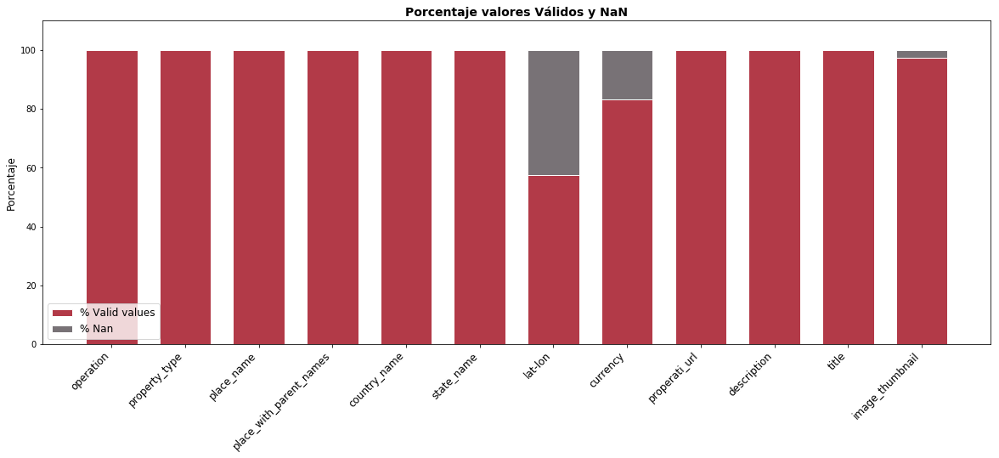

In [16]:
# Detalles de la distribución de valores nan y valores unique en las variables categoriales
details_missing_unique_values_categorical(df,list_to_check_object,plot_figure=True)

In [17]:
# Completamos haciendo el value_counts de las variables que tienen una distribución razonable
print('\033[1m'+'property_type'+'\033[0m')
display(df['property_type'].value_counts())
print
print('\033[1m'+'currency'+'\033[0m')
display(df['currency'].value_counts())

property_type


apartment    71065
house        40268
PH            5751
store         4136
Name: property_type, dtype: int64

currency


USD    87587
ARS    13219
PEN        2
UYU        1
Name: currency, dtype: int64

- Lat-lon y currency son las variables que tienen más missing data. En próximas etapas revisaremos currency para evaluar si se puede recuperar la moneda
- Todos los inmuebles pertenencen a Argentina
- Solo hay operaciones de venta
- Hay cuatro tipo de propiedades
- Hay cuatro clases de moneda, pero dos parecerían ser un error ya que no son las usadas en Argentina y tienen tres entradas únicamente

## 1.4 Caracterización y estadística descriptiva variables numéricas

- Usamos el método .describe para una primera aproximación de las variables numéricas

In [18]:
df.describe().round(6)

,Unnamed: 0,geonames_id,lat,lon,price,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses
count,121220.000000,1.025030e+05,69670.000000,69670.000000,1.008100e+05,1.008100e+05,1.008100e+05,81892.000000,101313.000000,68617.000000,8.765800e+04,7899.000000,47390.000000,1.426200e+04
mean,60609.500000,3.574442e+06,-34.626210,-59.266290,4.685259e+05,4.229397e+06,2.397006e+05,233.795328,133.050181,2160.086916,6.912216e+03,17.452336,3.080840,5.009234e+03
std,34993.344153,3.541306e+05,1.980936,2.299922,2.260101e+06,6.904714e+06,3.913239e+05,1782.222147,724.351479,2759.288621,2.837864e+04,120.243621,1.860773,1.204403e+05
min,0.000000,3.427208e+06,-54.823985,-75.678931,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.600000,1.510204e+00,1.000000,1.000000,1.000000e+00
25%,30304.750000,3.430234e+06,-34.669065,-58.727040,1.100000e+05,1.583309e+06,8.973388e+04,50.000000,45.000000,1218.181818,1.550000e+03,1.000000,2.000000,1.000000e+03
50%,60609.500000,3.433910e+06,-34.597985,-58.480128,1.850000e+05,2.558452e+06,1.450000e+05,84.000000,75.000000,1800.000000,2.213115e+03,3.000000,3.000000,2.000000e+03
75%,90914.250000,3.836668e+06,-34.441299,-58.395908,4.200000e+05,4.675792e+06,2.650000e+05,200.000000,150.000000,2486.411765,3.355549e+03,6.000000,4.000000,4.000000e+03
max,121219.000000,6.948895e+06,4.545843,-53.733330,6.500000e+08,8.212711e+08,4.654544e+07,200000.000000,187000.000000,206333.333333,4.000000e+06,3150.000000,32.000000,1.000150e+07


- Función para detectar outliers mediante el rango interquartil

In [19]:
# Funcion para detectar outliers usando el rango intercuartil
def identify_outliers_with_iqr_for_pd(x, iqr_treshold=1.5, get_limits=False):
    # FUNCIONALIDAD: identificar indices de outliers de un array de pandas a partir del rango intercuartil 
    # (iqr).
    #---------------------------------------------------------------------
    # INPUTS: 
        # - x = es un array de 1-D (puede tener nans, los que van a ser ignorados por la funcion)
        # - iqr_treshold = es el threshold que voy a utilizar a partir del iqr para determinar los valores
        # extremos inferiores y superiores. El default es 1.5 que coincide con el usado por los boxplots
        # por default
        # - get_limits = por default False, implica que no devuelve los límites inferiores y superiores para
        # determinar los outliers. Si toma valor True, devuelve un 1-D array con dos elementos, en el que 
        # el primero es el límite inferior estimado, y el segundo, el superior.
    #---------------------------------------------------------------------
    # OUTPUTS:
        # retorna los indices en los que el array presenta valores fuera del minimo inferior y maximo
        # superior identificado a partir del trheshold dado y del rango intercuartil. Si "get_limits=True"
        # retorna además un 1-D array cuyo primer elemento es el límite inferior estimado, y el segundo, 
        # el superior
    #---------------------------------------------------------------------   
    
    # 0. Primero detecto los thresholds inferiores (left) y superiores (right) para identificar outliers 
    threshold_from_iqr=(np.nanpercentile(x,75)-np.nanpercentile(x,25))*iqr_treshold
    left_side_iqr_thres=np.nanpercentile(x,25)-threshold_from_iqr
    right_side_iqr_thres=np.nanpercentile(x,75)+threshold_from_iqr
    
    # 1. Identifico valores de la variable que esten entre los thresholds identificados en el paso anterior
    boolean_mask=[] # creo una lista vacia para guardarme una maskara booleana
    for elemento in x:
        if np.isnan(elemento):
            boolean_mask.append(False)
        elif (elemento < left_side_iqr_thres) | (elemento > right_side_iqr_thres):
            boolean_mask.append(True)
        else:
            boolean_mask.append(False)
    
    # 2. Uso la maskara boleana para quedarme con los indices donde tengo los valores outliers y lo retorno
    indices_outliers=x[boolean_mask].index.values
    
    # 3. Retorno los límites inferior y superior (en un array) junto con los índices
    if get_limits == False:    
        return indices_outliers
    elif get_limits == True:
        left_right_iqr_thres=np.concatenate((left_side_iqr_thres,right_side_iqr_thres), axis=None)
        return indices_outliers, left_right_iqr_thres

- Función para identificar y visualizar la distribución de nan y outliers (usando el rango intercuartil) en las variables numéricas

In [20]:
def details_missing_outlier_values_numerical(df_data,df_variables,plot_figure=True,fig_size=(20,7)):
    # INPUTS:
        # - df_data = DataFrame que contiene los datos a los que se quiere aplicar la funcion
        # - df_variables = lista de Columnas numericas del DataFrame a las que se quiere aplicar la
        # visualización
        # - plot_figure= realiza un gráfico que muestra por variable el % de Nan y valors validos. Por default es True
        # - fig_size = parametro para poder ir cambiando el tamaño de la figura si no entra bien en el ploteo. 
        # Requiere una tupla como argumento con el ancho y el alto de la figura
    #---------------------------------------------------------------------
    # OUTPUTS:
        # - df_var_nans_out = Data Frame con información detallada de la distribución de las variables categoriales
    #---------------------------------------------------------------------

    #1. Inicializo las variables en las que voy a guardar los resultados de cada variable
    total_porcentaje_valores_nan=[]#
    total_cant_valores_nan=[]#

    total_porcentaje_valores_out=[]
    total_cant_valores_out=[]#
    total_left_out_thresh=[]#
    total_right_out_thres=[]#

    total_cant_values_sin_out=[]#
    total_porcentaje_values_sin_out=[]

    all_lista_index_out=[] #en esta variable guardo los índices con outliers


    #2. Comienzo un for para recorrer cada una de las variables y estimar metricas de su distribución
    for i in df_variables: 
        #2.1. Calculo los índices donde tengo valores NAN y el porcentaje de nans respecto del total de valores
        indices_nan=df_data[i][df_data[i].isnull()].index.values
        # -- me fijo el largo de los nans y estimo el porcentaje
        cant_valores_nan=(len(indices_nan))
        total_cant_valores_nan.append(cant_valores_nan)
        porcentaje_valores_nan=round((cant_valores_nan/len(df_data[i])*100),3)
        total_porcentaje_valores_nan.append(porcentaje_valores_nan)

        #2.2. Calculo los valores outliers usando la función "identify_outliers_with_iqr_for_pd"
        index_out, lim_out=identify_outliers_with_iqr_for_pd(df_data[i], iqr_treshold=1.5, get_limits=True)
        all_lista_index_out.append(index_out)
        total_left_out_thresh.append(round(lim_out[0],3))
        total_right_out_thres.append(round(lim_out[1],3))
        cant_outliers=len(index_out)
        total_cant_valores_out.append(cant_outliers)
        # calculo el porcentaje de outliers sobre los valores validos
        valid_values=len(df_data[i])-cant_valores_nan
        porcentaje_valores_out=round((cant_outliers/len(df_data[i])*100),3)
        total_porcentaje_valores_out.append(porcentaje_valores_out)
        # 1.4 Me fijo cuantos valores tiene out
        #lenght_indices_out=len(index_out)

        #2.3. Calculo los valores validos
        cant_valid_values_sin_out=valid_values-cant_outliers
        total_cant_values_sin_out.append(cant_valid_values_sin_out)
        porcentaje_values_sin_out=round((cant_valid_values_sin_out/len(df_data[i])*100),3)
        total_porcentaje_values_sin_out.append(porcentaje_values_sin_out)

    #-------- fuera for --------------------
    #3. Pongo las variables en un Dataframe
    df_var_nans_out=pd.DataFrame( {"%Nan_values" : total_porcentaje_valores_nan, 
                                      "Cant_nan_values" : total_cant_valores_nan, 
                                      "%Out_values" : total_porcentaje_valores_out,
                                      "Cant_out_values": total_cant_valores_out,
                                      "Left IQR thres": total_left_out_thresh,
                                      "Right IQR thres":total_right_out_thres,
                                      "%Values_without_out":total_porcentaje_values_sin_out,
                                      "Cant_values_without_out":total_cant_values_sin_out},
                                    index = df_variables)
    #4. Hago el plot
    if plot_figure==True:
        fig = plt.figure(figsize=fig_size)
        number_of_bar=0
        total_nan_to_plot=[]
        total_valid_to_plot_out=[]
        total_outliers_to_plot=[]
        total_valid_outliers_to_plot=[]

        for x in df_var_nans_out.index.values:
            number_of_bar+=1
            #print(number_of_bar)
            nan_to_plot=df_var_nans_out['%Nan_values'][x]
            total_nan_to_plot.append(nan_to_plot)
            valid_values_to_plot_out=df_var_nans_out['%Values_without_out'][x]    
            total_valid_to_plot_out.append(valid_values_to_plot_out)
            outliers_to_plot=df_var_nans_out['%Out_values'][x]
            total_outliers_to_plot.append(outliers_to_plot)
            valid_outliers_to_plot=df_var_nans_out['%Values_without_out'][x]+df_var_nans_out['%Out_values'][x]
            total_valid_outliers_to_plot.append(valid_outliers_to_plot)

        width = 0.70       # the width of the bars: can also be len(x) sequence
        ind=np.arange(number_of_bar)
        plt.bar(ind, total_valid_to_plot_out, width, color='#1d2951',
                edgecolor='white',label='% Values without outlies')

        plt.bar(ind, total_outliers_to_plot, width, bottom=total_valid_to_plot_out, color='#73c2f8',
                edgecolor='white',label='% Outlier values')

        plt.bar(ind, total_nan_to_plot, width, bottom=total_valid_outliers_to_plot,color='#787276',
                edgecolor='white', label='% Nan')

        plt.xticks(ind, (df_var_nans_out.index.values),
                   fontsize=12,rotation=45,ha='right')
        #plt.xticks(np.arange(0,len(df_cat_nans_unique.index.values)), (df_cat_nans_unique.index.values),
        #           fontsize=12,rotation=60)
        plt.ylim([0,110])
        plt.legend(loc='best',fontsize=12)
        plt.title('Porcentaje valores Válidos, Outliers y NaNs',fontsize = 14,fontweight="bold")
        plt.ylabel('Porcentaje',fontsize = 12)

    return df_var_nans_out

,%Nan_values,Cant_nan_values,%Out_values,Cant_out_values,Left IQR thres,Right IQR thres,%Values_without_out,Cant_values_without_out
Unnamed: 0,0.000,0,0.000,0,-60609.500,181828.500,100.000,121220
geonames_id,15.441,18717,0.782,948,2820583.000,4446319.000,83.777,101555
lat,42.526,51550,18.628,22581,-35.011,-34.100,38.846,47089
lon,42.526,51550,18.313,22199,-59.224,-57.899,39.161,47471
price,16.837,20410,11.897,14422,-355000.000,885000.000,71.265,86388
price_aprox_local_currency,16.837,20410,6.901,8365,-3055415.150,9314517.090,76.262,92445
price_aprox_usd,16.837,20410,6.901,8365,-173165.300,527899.180,76.262,92445
surface_total_in_m2,32.443,39328,6.542,7930,-175.000,425.000,61.015,73962
surface_covered_in_m2,16.422,19907,5.516,6687,-112.500,307.500,78.061,94626
price_usd_per_m2,43.395,52603,2.366,2868,-684.163,4388.757,54.239,65749


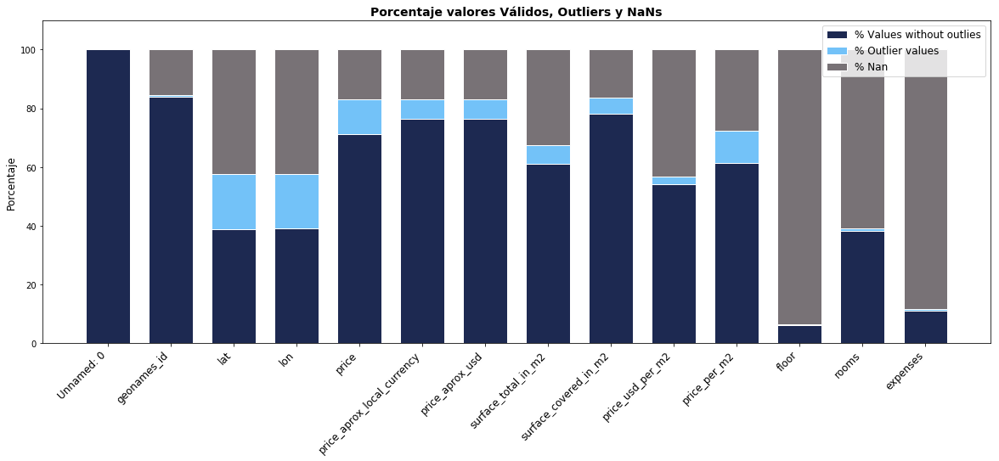

In [21]:
details_missing_outlier_values_numerical(df,list_to_check_float_int,plot_figure=True,fig_size=(20,7))

- Por lo que se observa de los valores nan y outliers, las columnas de "price_aprox_local_currency" y "price_aprox_usd" estarían vinculadas de forma muy estrecha (podría ser que una esté estimada en base a la otra)
- Llama la atención que haya más datos en superficie cubierta que en superficie total. 
- Los missing data de los m2 podrían recuperarseen parte a partir de las variables de valores totales y metros cuadrados (averiguar sobre cuáles de ests variables están calculadas)
- La columna price también parecería tener la misma cant. de valores que las otras columnas de precios, pero su distribución, por lo que indican los outliers, es distinta y no estaría directamente asociada a las otras. 
- Las columnas de flor, rooms, expenses y lat-lon presentan una gran cantidad de valores perdidos

- Funcion para visualizar distribucion de las variables numericas y obtener estadísticos descriptivos con y sin los outliers estimados acorde al rango intercuartil

In [22]:
def visual_inspection_nan_outliers_iqr(df_data, df_variables, iqr_treshold=1.5, return_indexes=True, fig_size=(20,7)):
    
    # INPUTS:
        # - df_data = DataFrame que contiene los datos a los que se quiere aplicar la funcion
        # - df_variables = lista de Columnas del DataFrame a las que se quiere aplicar la
        # visualización
        # - iqr_treshold = es el threshold que voy a utilizar a partir del iqr para determinar los valores
        # extremos inferiores y superiores. El default es 1.5 que coincide con el usado por los boxplots
        # por default. Es uno de los inputs de la función "identify_outliers_with_iqr_for_pd" que estoy llamando
        # - return_indexes= devuelve los índices en donde se identificaron outliers y nan en dos diccionarios. 
        # por defuelt es True.
        # - fig_size = parametro para poder ir cambiando el tamaño de la figura si no entra bien en el ploteo. 
        # Requiere una tupla como argumento con el ancho y el alto de la figura
    #---------------------------------------------------------------------
    
    # 0.1 Inicializo las variables en las que voy a guardar informacion de las variables para
    # despues retornar, y seteo los parametros de la figura antes de entrar al for
    lista_var_names=[] #creo una lista vacia donde voy a almacenar los nombres de las series para luego hacer un diccionario
    lista_index_nan=[] #creo una lista vacia donde voy a almacenar las listas de indices nan para luego hacer un diccionario
    lista_index_out=[] #creo una lista vacia donde voy a almacenar las listas de indices out para luego hacer un diccionario
    
    # 0.2 Inicializo parámetros de la figura figura
    fig = plt.figure(figsize=fig_size)
    gs=gridspec.GridSpec(len(df_variables)*2,4) #la figura va a tener 4 columnas y tanta filas como variables en "df_variables"

    val_subrow_uno=0 #valores para inicializar los lugares de la figura (filas originales)
    val_subrow_dos=1 #valores para inicializar los lugares de la figura (filas originales)
    
    # 1. Comienzo el for que va a recorrer cada una de las variables de "df_variables"
    for i in df_variables:
        
        # 1.1 Calculo los índices en los que la variable presenta valores NaN y guardo la info en las listas
        indices_nan=df_data[i][df_data[i].isnull()].index.values
        lista_var_names.append(i)
        lista_index_nan.append(indices_nan)
        
        # 1.2 Me fijo cuantos valores tiene indices_nan y me fijo el largo total de la variable
        length_indices_nan=len(indices_nan) # cantidad de nans de la variable
        lenght_var_total=len(df_data[i]) # largo total de la variable
        
        # 1.3 Calculo los índices que tienen valores outliers
        index_out, lim_out=identify_outliers_with_iqr_for_pd(df_data[i], iqr_treshold=1.5, get_limits=True)
        lista_index_out.append(index_out)
        
        # 1.4 Me fijo cuantos valores tiene out
        lenght_indices_out=len(index_out)
        
        # 1.5 Preparo la variable para su visualizacion:
        # -(i)- saco los valores nan de la variable, y uso esta como variable total para ver todos los datos no-nulls
        var_total_sin_nan=df_data[i].drop(df.index[indices_nan])
        # -(ii)- quito los valores out de la variable, y uso esta como variable para ver distribucion sin outliers
        var_total_sin_outs=var_total_sin_nan.drop(df_data.index[index_out])
        # - (iii)- me quedo con los valores outliers para ver su distribucion 
        var_only_outs=var_total_sin_nan[index_out]
               
        # 1.6 Visualizo la informacion en una figura con varios subplots
        # -(i)- Boxplot de todos los valores no-nulos de la variable
        ax1=fig.add_subplot(gs[val_subrow_uno,1]); # First row, first column
        plt.title('All values',fontdict= {'fontsize': 15, 'fontweight' : 'bold'})                                        
        sns.boxplot(var_total_sin_nan, ax=ax1)
        plt.setp( ax1.get_xticklabels(), visible=False)
        plt.setp( ax1.get_yticklabels(), visible=False)
        ax1.set(xlabel='')
        ax1.set_ylabel(ylabel=i,fontsize=17,fontweight="bold")
        # -(ii)- Distribución de todos los valores no-nulos de la variable   
        ax2=fig.add_subplot(gs[val_subrow_dos,1]); # second row, first column
        ax2=sns.distplot(var_total_sin_nan, ax=ax2,kde=False)
        ax2.set(xlabel='')
        plt.tick_params(labelsize=15)
        ax2.get_xaxis().set_major_locator(LinearLocator(numticks=5)) #seteamos que solo aparezcan 5 ticks en el eje X
        ax2.set_xlim(np.min(var_total_sin_nan), np.max(var_total_sin_nan)) #setamos el límite inferior y superior del eje X
        yticks = ax2.yaxis.get_major_ticks() 
        yticks[0].label1.set_visible(False) #sacamos el primer tick del eje Y para meorar la visualización
        props = dict(boxstyle='round', facecolor='blue', alpha=0.3) # text box with statistical measures
        text_box = '\n'.join((
            'Min = %.2f' % round(np.min(var_total_sin_nan),2),
            'Max = %.2f' % round(np.max(var_total_sin_nan),2),
            'Per 25 = %.2f' % round(np.percentile(var_total_sin_nan,25),2),
            'Median = %.2f' % round(np.median(var_total_sin_nan),2),
            'Per 75 = %.2f' % round(np.percentile(var_total_sin_nan,75),2),
            'Per 95 = %.2f' % round(np.percentile(var_total_sin_nan,95),2),
            'Mean = %.2f' % round(np.mean(var_total_sin_nan),2),
            'CV = %.2f' % round(np.std(var_total_sin_nan)/np.nanmean(var_total_sin_nan)*100,2)))
        plt.text(0.75, 0.95, text_box, transform=ax2.transAxes, 
                 fontsize=15, verticalalignment='top', horizontalalignment = 'center', bbox=props)# agrego la box a la figura

        # -(iii)- Boxplot de todos los valores no-nulos de la variable, sin los outliers
        ax3=fig.add_subplot(gs[val_subrow_uno,2]); # First row, second column
        plt.title('Without outliers',fontdict= {'fontsize': 15, 'fontweight' : 'bold'})
        sns.boxplot(var_total_sin_outs, ax=ax3)
        plt.setp( ax3.get_xticklabels(), visible=False)
        plt.setp( ax3.get_yticklabels(), visible=False)
        ax3.set(xlabel='')        
        # -(iv)- Distribución de todos los valores no-nulos de la variable, sin los outliers
        ax4=fig.add_subplot(gs[val_subrow_dos,2]); # second row, second column
        ax4=sns.distplot(var_total_sin_outs, ax=ax4,kde=False)
        ax4.set(xlabel='')
        plt.tick_params(labelsize=15)
        ax4.get_xaxis().set_major_locator(LinearLocator(numticks=5))
        ax4.set_xlim(np.min(var_total_sin_outs), np.max(var_total_sin_outs))
        yticks = ax4.yaxis.get_major_ticks() 
        yticks[0].label1.set_visible(False)
        props = dict(boxstyle='round', facecolor='blue', alpha=0.3)
        text_box = '\n'.join((
            'Min = %.2f' % round(np.min(var_total_sin_outs),2),
            'Max = %.2f' % round(np.max(var_total_sin_outs),2),
            'Per 25 = %.2f' % round(np.percentile(var_total_sin_outs,25),2),
            'Median = %.2f' % round(np.median(var_total_sin_outs),2),
            'Per 75 = %.2f' % round(np.percentile(var_total_sin_outs,75),2),
            'Per 95 = %.2f' % round(np.percentile(var_total_sin_outs,95),2),
            'Mean = %.2f' % round(np.mean(var_total_sin_outs),2),
            'CV = %.2f' % round(np.std(var_total_sin_outs)/np.nanmean(var_total_sin_outs)*100,2)))
        plt.text(0.75, 0.95, text_box, transform=ax4.transAxes, 
                 fontsize=15, verticalalignment='top', horizontalalignment = 'center', bbox=props)
        
        # -(v)- Boxplot de todos los valores outliers
        ax5=fig.add_subplot(gs[val_subrow_uno,3]); # First row, third column
        plt.title('Only outliers values ',fontdict= {'fontsize': 15, 'fontweight' : 'bold'})
        sns.boxplot(var_only_outs, ax=ax5)
        plt.setp( ax5.get_xticklabels(), visible=False)
        plt.setp( ax5.get_yticklabels(), visible=False)
        ax5.set(xlabel='')
        # -(vi)- Distribución de todos los valores no-nulos de la variable, sin los outliers
        ax6=fig.add_subplot(gs[val_subrow_dos,3]); # second row, third column
        ax6=sns.distplot(var_only_outs, ax=ax6,kde=False)
        ax6.set(xlabel='')
        plt.tick_params(labelsize=15)
        ax6.get_xaxis().set_major_locator(LinearLocator(numticks=5))
        ax6.set_xlim(np.min(var_only_outs), np.max(var_only_outs))
        yticks = ax6.yaxis.get_major_ticks() 
        yticks[0].label1.set_visible(False)
        props = dict(boxstyle='round', facecolor='blue', alpha=0.3)
        text_box = '\n'.join((
            'Min = %.2f' % round(np.min(var_only_outs),2),
            'Max = %.2f' % round(np.max(var_only_outs),2),
            'Per 25 = %.2f' % round(np.percentile(var_only_outs,25),2),
            'Median = %.2f' % round(np.median(var_only_outs),2),
            'Per 75 = %.2f' % round(np.percentile(var_only_outs,75),2),
            'Per 95 = %.2f' % round(np.percentile(var_only_outs,95),2),
            'Mean = %.2f' % round(np.mean(var_only_outs),2),
            'CV = %.2f' % round(np.std(var_only_outs)/np.nanmean(var_only_outs)*100,2)))
        plt.text(0.75, 0.95, text_box, transform=ax6.transAxes, 
                 fontsize=15, verticalalignment='top', horizontalalignment = 'center', bbox=props)
        
        val_subrow_uno+=2 #sumo los valores para ubicar las variables que se van recorriendo
        val_subrow_dos+=2 #sumo los valores para ubicar las variables que se van recorriendo
            
    fig.tight_layout()
    
    # 2. Guardo en dos diccionarios los indices de los valores outlieres y de los nan (salvo que el parametro 
    # "return_indexes") sea false
    if return_indexes:
        nan_index_df = dict(zip(lista_var_names, lista_index_nan))
        out_index_df = dict(zip(lista_var_names, lista_index_out))
        return nan_index_df, out_index_df

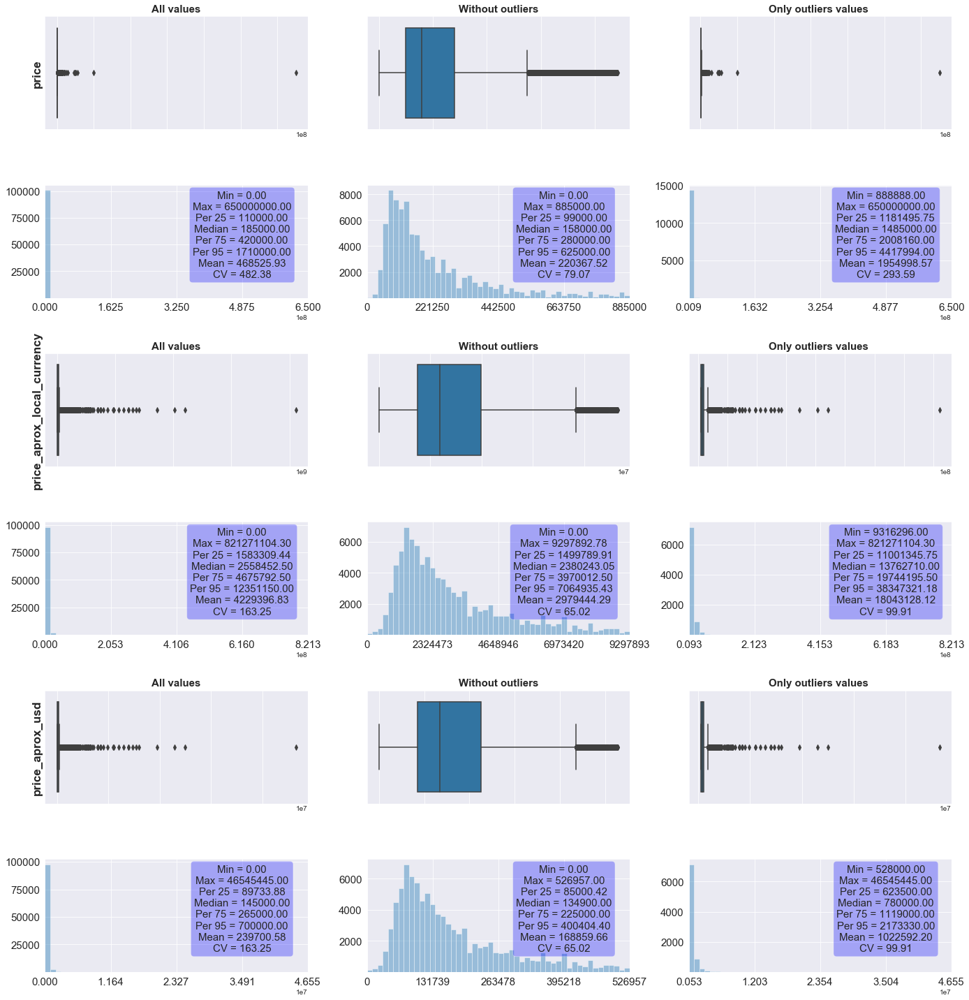

In [23]:
# Distribución de los precios generales
lista_variables_precio_general=['price', 'price_aprox_local_currency','price_aprox_usd']
sns.set_style('darkgrid')
nan_index_precio_general, out_index_precio_general=visual_inspection_nan_outliers_iqr(df,
                                                                                      lista_variables_precio_general,
                                                                                      iqr_treshold=1.5,
                                                                                      return_indexes=True,
                                                                                      fig_size=(25,20))#2515

- Cómo se observó anteriormente las variables "price_aprox_usd" y "price_aprox_local_currency" parecerían ser una la transformación de la otra ya que tienen distribuciones idénticas. 
- Llama la atención que hay valores 0 y cercanos que habría que evaluar para re-estimar
- También hay que tener en cuenta que todas las distribuciones, cuando no se quitan los valores outliers, tiene valores muy extremos hacia la derecha. 

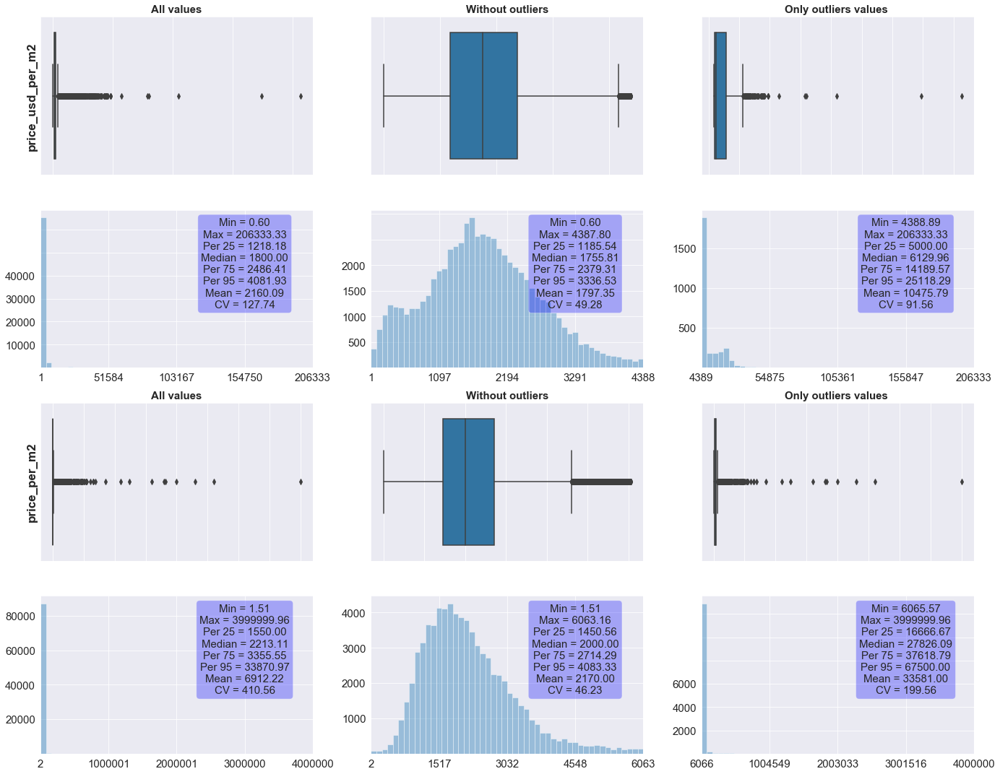

In [24]:
# Distribución de los precios por m2
lista_variables_precio_m2=['price_usd_per_m2', 'price_per_m2']
nan_index_precio_m2, out_index_precio_m2=visual_inspection_nan_outliers_iqr(df,
                                                                            lista_variables_precio_m2,
                                                                            iqr_treshold=1.5,
                                                                            return_indexes=True,
                                                                            fig_size=(25,15))#2515

- Nuevamente se repite que en las distribuciones totales hay valores muy extremos hacia la derecha. Esto guarda cierta consistencia con lo observado con las variables de precios, pero habría que evaluar estos valores de todos modos. 
- Tal como en el caso anterior existen valores muy cercanos a cero que habría que corregir.

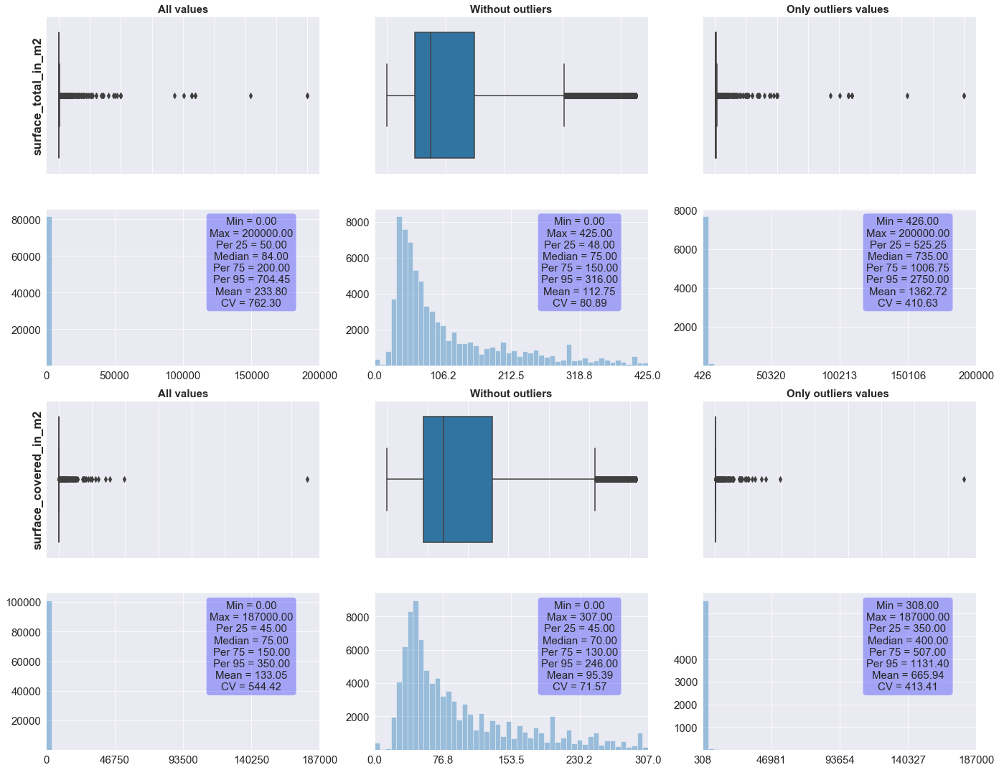

In [25]:
# Distribución de las superficies
lista_variables_surface=['surface_total_in_m2', 'surface_covered_in_m2']
nan_index_precio_m2, out_index_precio_m2=visual_inspection_nan_outliers_iqr(df,
                                                                            lista_variables_surface,
                                                                            iqr_treshold=1.5,
                                                                            return_indexes=True,
                                                                            fig_size=(25,15))#2515

- Se mantiene la consistencia de encontrar valores extremos y valores de cero que en el caso de las superficies indican evidentemente un error de la entrada

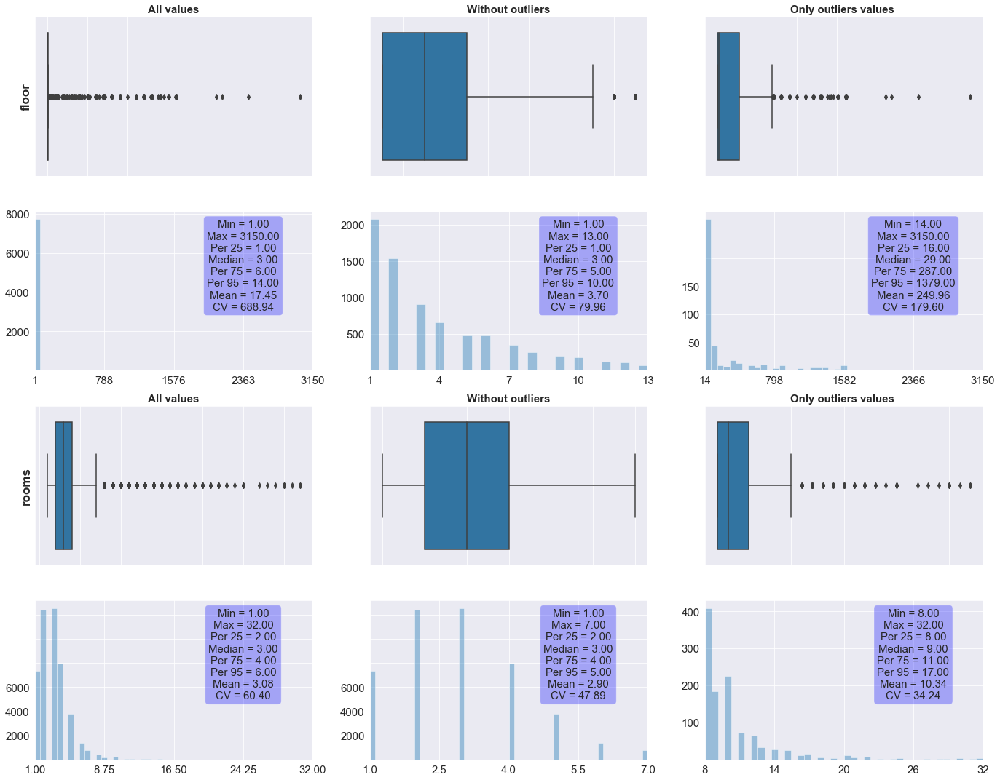

In [26]:
# Distribución de las variables rooms flors
lista_variables_rooms_flors=['floor', 'rooms']
nan_index_rooms_flors, out_index_rooms_flors=visual_inspection_nan_outliers_iqr(df,
                                                                                lista_variables_rooms_flors,
                                                                                iqr_treshold=1.5,
                                                                                return_indexes=True,
                                                                                fig_size=(25,15))#2515

- Hay valores de la variable floor que no corresponden al máximo que puede tener un edifico. 
- La variable rooms tiene valores extremos pero todos parecerían razonables (aunque evidentemente habría propiedades de gran tamaño cubierto para tener más de 14 habitaciones)

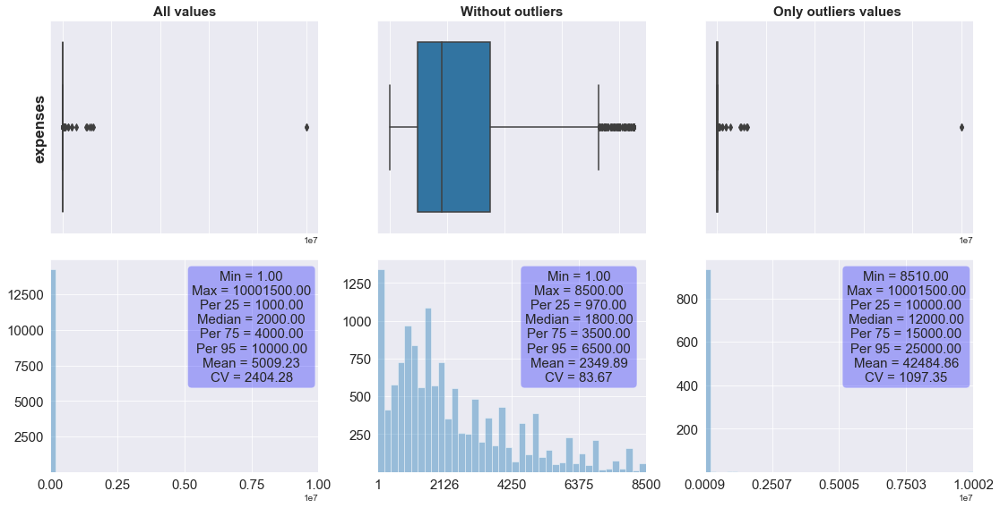

In [27]:
# Distribución variable expenses
lista_variables_expenses=['expenses']
nan_index_expenses, out_index_expenses=visual_inspection_nan_outliers_iqr(df,
                                                                          lista_variables_expenses,
                                                                          iqr_treshold=1.5,
                                                                          return_indexes=True,
                                                                          fig_size=(20,8))#2515

- Cómo en las otras variables, hay valores mínimos cercanos a 1 y valores máximos extremos que no podrían ser correctos

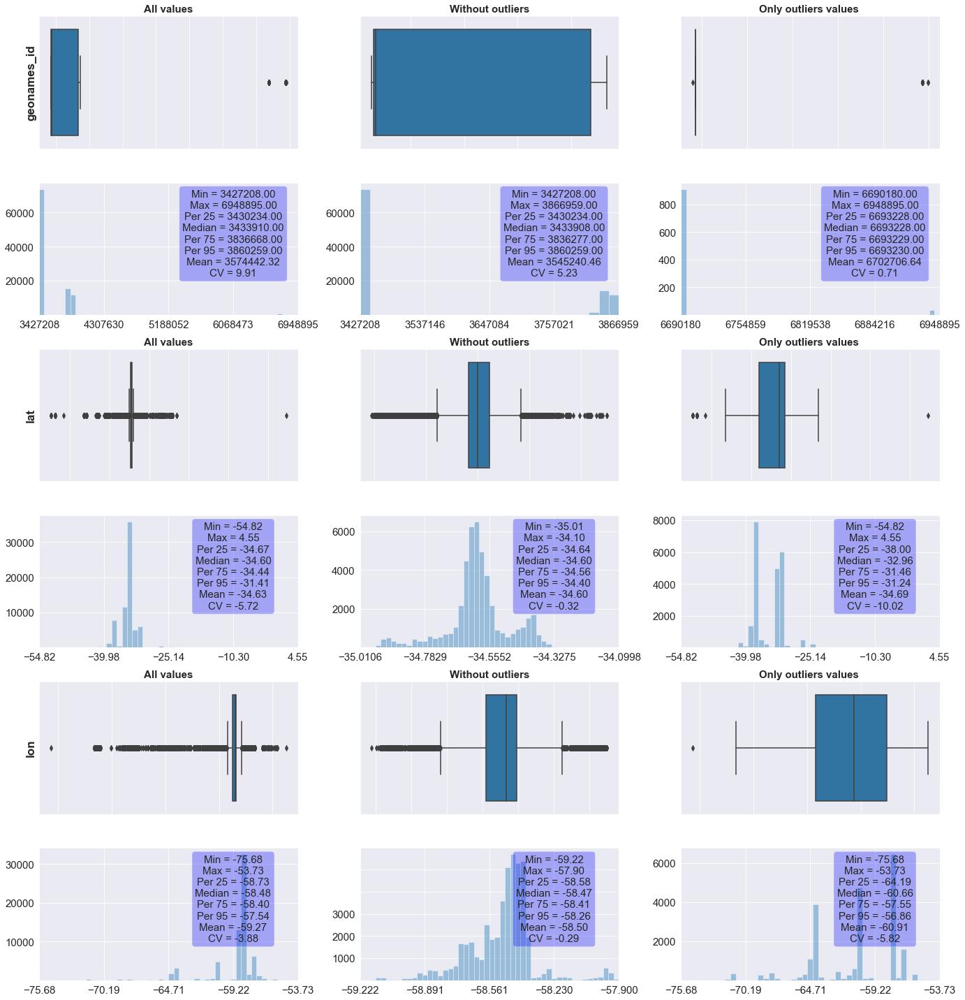

In [28]:
# explorar las variables de coordenadas
lista_variables_coordenadas=['geonames_id','lat','lon',]
nan_index_coordenadas, out_index_coordenadas=visual_inspection_nan_outliers_iqr(df,
                                                                                lista_variables_coordenadas,
                                                                                iqr_treshold=1.5,
                                                                                return_indexes=True,
                                                                                fig_size=(25,20))#2515

## 1.5 Evaluar existencia variables duplicadas

- Usamos el método duplicated y sumamos todas las entradas para evaluar si detectamos valores true

In [29]:
df.duplicated().sum()

0

- No se detectaron entradas duplicadas

##  <ins>2. TERCERA ETAPA</ins>: Evaluamos la consistencia de las variables de superficie y realizamos reemplazos e missing data


### 2.1 Analizamos la relación entre superficies totales y cubiertas


In [30]:
#Chequeamos las distintas relaciones que hay entre sufrase total y suface covered
print('Total igual a covered (m2) = '+ str(np.sum((df['surface_total_in_m2']-df['surface_covered_in_m2'])==0)))
print('Total mayor que covered (m2) = '+ str(np.sum((df['surface_total_in_m2']-df['surface_covered_in_m2'])>0)))
print('Total menor que covered (m2) = '+ str(np.sum((df['surface_total_in_m2']-df['surface_covered_in_m2'])<0)))

Total igual a covered (m2) = 24173
Total mayor que covered (m2) = 49075
Total menor que covered (m2) = 1106


Hay 1106 en donde la superficie cubierta es mayor que la superficie total. Hay que revisar en cada caso como es la distribucion de viviendas

In [31]:
#Primero cuando TOTAL == CUBIERTA
df['property_type'][df['surface_total_in_m2']==df['surface_covered_in_m2']].value_counts(normalize=True)

apartment    0.610433
house        0.278699
store        0.071733
PH           0.039135
Name: property_type, dtype: float64

In [32]:
#Segundo cuando TOTAL > CUBIERTA
df['property_type'][df['surface_total_in_m2']>df['surface_covered_in_m2']].value_counts(normalize=True)

apartment    0.630647
house        0.311645
PH           0.048334
store        0.009373
Name: property_type, dtype: float64

In [33]:
#Tercero cuando TOTAL < CUBIERTA (que serían casos más raros)
df['property_type'][df['surface_total_in_m2']<df['surface_covered_in_m2']].value_counts(normalize=True)

house        0.602170
apartment    0.317360
store        0.042495
PH           0.037975
Name: property_type, dtype: float64

Por lo que se observa,  TOTAL => CUBIERTO corresponde mayoritariamente a apartamentos y casas; mientras que el caso TOTAL < CUBIERTO pertenece mayoritariamente a casas. Esto sería esperable dado que las casas pueden tener edificación hacia arriba, lo que hace que el metro cuadrado cubierto sea mayor que el total.

Nos fijamos la estadistica descriptiva de estas entradas en las que TOTAL < CUBIERTO, por tipo de inmueble

In [34]:
df[df['surface_total_in_m2']<df['surface_covered_in_m2']].pivot_table(index='property_type',
                    aggfunc={'rooms':('median','mean','min','max','count')})

rooms                            
              count   max      mean median  min
property_type                                  
PH               34   8.0  3.617647    3.5  2.0
apartment       120  10.0  2.650000    2.5  1.0
house           297  10.0  4.131313    4.0  1.0
store             0   NaN       NaN    NaN  NaN

Tanto en los PH como en las casas la construcción de distintas plantas podría generar que este dato de TOTAL < CUBIERTO sea verdadero. Sin embargo, en el caso de los apartment es muy difícil que esta diferencia sea un valor confiable. 

Chequeamos la estadística de descriptiva específicamente de los departamentos. 

In [35]:
#chequeamos que no haya valores nulos
pd.DataFrame(df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) &\
(df['property_type']=='apartment')][['surface_total_in_m2','surface_covered_in_m2']]).isnull().sum()

surface_total_in_m2      0
surface_covered_in_m2    0
dtype: int64

In [36]:
#evaluamos la estadística descriptiva
pd.DataFrame(df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) &\
(df['property_type']=='apartment')][['surface_total_in_m2','surface_covered_in_m2']]).describe().round(2)

,surface_total_in_m2,surface_covered_in_m2
count,351.00,351.00
mean,62.95,314.44
std,65.38,2685.71
min,10.00,26.00
25%,38.00,50.00
50%,45.00,64.00
75%,68.00,95.00
max,776.00,49000.00


Existen algunas diferencias entre ambas columnas (en base a lo que refleja la estadística descriptiva) que podrían ser bastante grandes. 

Para evaluar esto, calculamos una columna que sea la diferencia entre ambas variables

In [37]:
pd.DataFrame(df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')]['surface_covered_in_m2']-\
             df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')]['surface_total_in_m2']).describe().round(2)

,0
count,351.00
mean,251.49
std,2684.15
min,1.00
25%,4.00
50%,10.00
75%,30.50
max,48948.00


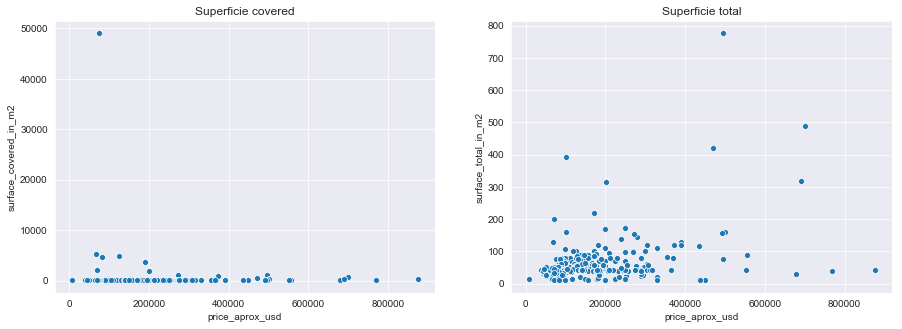

In [38]:
# Nos fijamos la relación de cubierto y descubierto con la variable precio en dólares
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
sns.scatterplot(x=df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')]['price_aprox_usd'],
                y=df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')]['surface_covered_in_m2'])
plt.title('Superficie covered')

plt.subplot(1, 2, 2)
sns.scatterplot(x=df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')]['price_aprox_usd'],
                y=df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')]['surface_total_in_m2'])
plt.title('Superficie total');

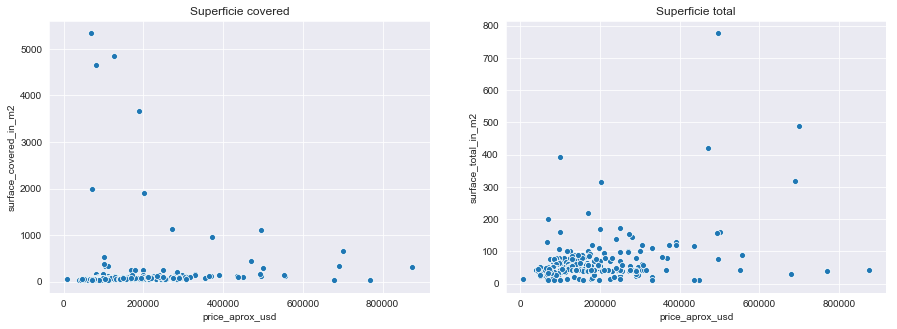

In [39]:
# Sacamos el valor de superficie cubierta que es demasiado alto y hacemos nuevamente los gráficos
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
sns.scatterplot(x=df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')\
                  & (df['surface_covered_in_m2']<40000)]['price_aprox_usd'],
                y=df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')\
                  & (df['surface_covered_in_m2']<40000)]['surface_covered_in_m2'])
plt.title('Superficie covered')

plt.subplot(1, 2, 2)
sns.scatterplot(x=df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')]['price_aprox_usd'],
                y=df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')]['surface_total_in_m2'])
plt.title('Superficie total');

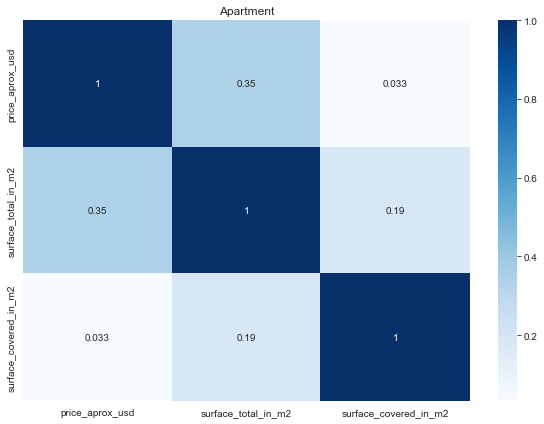

In [40]:
plt.figure(figsize=(10, 7))
sns.heatmap(df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')\
                  & (df['surface_covered_in_m2']<40000)][['price_aprox_usd','surface_total_in_m2','surface_covered_in_m2']].corr(method='pearson'),annot=True,cmap="Blues")
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Apartment');

Si sacamos el valor outlier, observando la estadística descriptiva, los gráficos y la correlación con precios en dólares, parecería que los datos correctos a tener en cuenta serían los que están en la columna total y no en la de superficie cubierta. 

Evaluamos qué sucede con la variable rooms para terminar de definir qué hacer con estas entradas

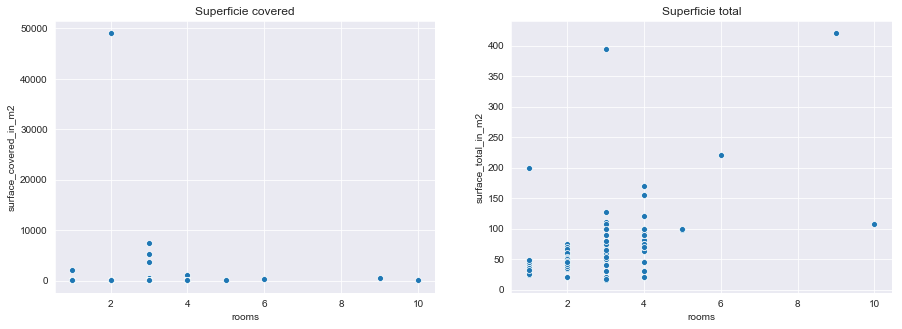

In [41]:
# Nos fijamos la relación de cubierto y descubierto con la variable rooms
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
sns.scatterplot(x=df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')]['rooms'],
                y=df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')]['surface_covered_in_m2'])
plt.title('Superficie covered')

plt.subplot(1, 2, 2)
sns.scatterplot(x=df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')]['rooms'],
                y=df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')]['surface_total_in_m2'])
plt.title('Superficie total');

In [42]:
# Repetimos el gráfico de arriba sacando el outlier de superficie cubierta (este valor es candidato a ser limpiado de la base ya que 
# un valor muy alto de superficie cubierta estaría vinculado a dos habitaciones únicamente)

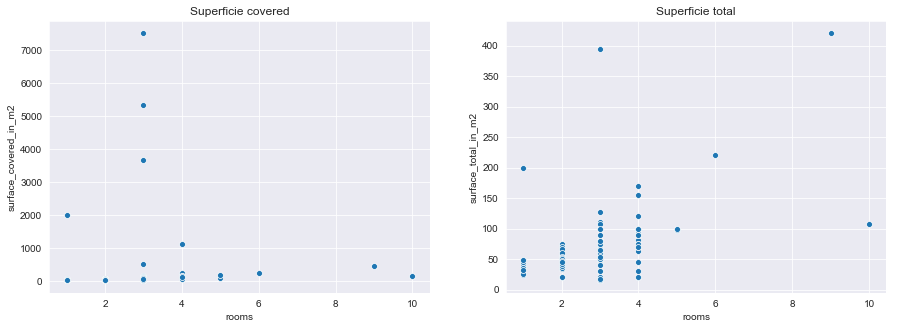

In [43]:
# Sacamos el valor de superficie cubierta que es demasiado alto y hacemos nuevamente los gráficos
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
sns.scatterplot(x=df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')\
                  & (df['surface_covered_in_m2']<40000)]['rooms'],
                y=df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')\
                  & (df['surface_covered_in_m2']<40000)]['surface_covered_in_m2'])
plt.title('Superficie covered')

plt.subplot(1, 2, 2)
sns.scatterplot(x=df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')]['rooms'],
                y=df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')]['surface_total_in_m2'])
plt.title('Superficie total');

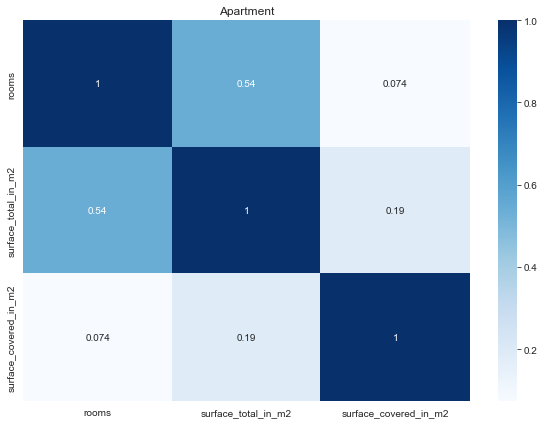

In [44]:
plt.figure(figsize=(10, 7))
sns.heatmap(df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')\
                  & (df['surface_covered_in_m2']<40000)][['rooms','surface_total_in_m2','surface_covered_in_m2']].corr(method='pearson'),annot=True,cmap="Blues")
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Apartment');

De nuevo, como en el caso anterior, los valores de superficie total parecerían ser los más correctos. Teniendo en cuenta estos gráficos, sumado a que hay valores extremos cuando se hacen las diferencias entre ambas variables, decidimos repetir, en estos casos de apartamentos, el valor total en el valor de la superficie cubierta. 

Antes de hacerlo, chequeamos el valor outlier para de superficie cubierta para ver si este no sería un valor a eliminar. 

In [45]:
df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')\
                  & (df['surface_covered_in_m2']==49000)]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
35151,35151,sell,apartment,Mar del Plata,|Argentina|Buenos Aires Costa Atlántica|Mar de...,Argentina,Buenos Aires Costa Atlántica,3430863.0,"-37.9898094428,-57.5477728296",-37.989809,-57.547773,74000.0,USD,1305693.0,74000.0,52.0,49000.0,1423.076923,1.510204,NaN,2.0,NaN,http://www.properati.com.ar/18dqk_venta_depart...,OPORTUNIDAD!!! VENTA DOS AMBIENTES FRENTE A PL...,oportunidad frente al mar!!!!,https://thumbs4.properati.com/9/eYTtojBrMLeOIU...


In [46]:
display(df.loc[35151,'description'])
display(df.loc[35151,'title'])

'OPORTUNIDAD!!! VENTA DOS AMBIENTES FRENTE A PLAZA ESPAÑA VENTA DEPARTAMENTO DE DPOS AMBIENTES FRENTE A LA PLAZA ESPAÑA EL MISMO CUENTA CON UN AMPLIO LIVING COMEDOR CON BALCON PASANTE A UN CONTRAFRENTRE ABIERTO UBICADO EN UN SEPTIMO PISO CUENTA CON UN DORMITORIOS CON AMPLIO VENTANAL Y PLACARES DE GENEROSAS DIMENSIONES Y MUY LUMINOSO BAÑO COMPLETO CON VANITORY Y BAÑERA CON MAMPARA AMPLIO LIVING COMEDOR CON VENTANALES DE PARED A PARED PASANTE , MUY LUMINOSO . PISOS DE CERÁMICO Sandra Laura Lara Marcos Jeremías Castello Reg. 3479 Santa Fe 1678 primer piso Of. A - 7600 Mar del Plata Tel: (0223) 494-2707 Cel:(0223) 155- 180331 Email: '

'oportunidad frente al  mar!!!!'

Por lo que se lee en la descripción el valor de 49000 es un error, así que en este caso también lo reemplazamos por el valor total

Hacemos el reempalza en un nuevo dataframe que creamos donde vamos a impactar los cambios df2. Igualamos TOTAL==COVERED, en los casos en que son apartamentos. 

In [47]:
df2 = df.copy()

In [48]:
index_aux=df[(df['surface_total_in_m2']<df['surface_covered_in_m2']) & (df['property_type']=='apartment')].index.values

In [49]:
df2.at[index_aux,'surface_covered_in_m2']=df2.loc[index_aux,'surface_total_in_m2']

- De la relación entre superficie total y cubierta, decidimos que aquellos casos en que TOTAL<CUBIERTA que correspondían a apartamentos, utilizar los datos de TOTAL para reemplazar los de cubierta. 
- Esto lo decidimos apoyándonos en la relación de estas variables con el precio en dólares y la cantidad de ambientes. 

## 2.2 Analizamos los valores outliers a la derecha para la Superficie total y la superficie cubierta

Acorde a los análisis de la PRIMERA ETAPA, 
    - La columna de superficie total tiene
            - un percentil 75 = 200
            - un percentil 95 = 316
            - un valor de threshold para outliers (pos) = 425
            - un valor máximo de = 200.000
    - La columna de superficie cubierta tiene
            - un percentil 75 = 150
            - un percentil 95 = 246
            - un valor de threshold para outliers (pos) = 307
            - un valor máximo de = 187000
            
Estos análisis los vamos a trabajar con el df2 que tiene impactados los cambios realizados en el punto anterior

In [50]:
# Nos fijamos la cantidad de valores que puedo considerar mayors del percentil 95 y del valor outliers
pd.DataFrame({'Cant entre 75%-95%': [len(df2[(df2['surface_total_in_m2']>=200) & (df2['surface_total_in_m2']<316)]),
                                     len(df2[(df2['surface_covered_in_m2']>=150) & (df2['surface_covered_in_m2']<246)])],
              'Cant entre 95%-out': [len(df2[(df2['surface_total_in_m2']>=316) & (df2['surface_total_in_m2']<425)]),
                                     len(df2[(df2['surface_covered_in_m2']>=246) & (df2['surface_covered_in_m2']<307)])],              
              'Cant >out': [len(df2[(df2['surface_total_in_m2']>=425)]),
                            len(df2[(df2['surface_covered_in_m2']>=307)])]},
             index=['Total','Covered'])

,Cant entre 75%-95%,Cant entre 95%-out,Cant >out
Total,9458,3700,7957
Covered,14837,4740,6694


In [51]:
# Calculamos la mediana de valores que puedo considerar mayors del percentil 95 y del valor outliers
pd.DataFrame({'Mediana entre 75%-95%': [np.nanmedian(df2[(df2['surface_total_in_m2']>=200) & (df2['surface_total_in_m2']<316)]['surface_total_in_m2']),
                                     np.nanmedian(df2[(df2['surface_covered_in_m2']>=150) & (df2['surface_covered_in_m2']<246)]['surface_covered_in_m2'])],
              'Mediana entre 95%-out': [np.nanmedian(df2[(df2['surface_total_in_m2']>=316) & (df2['surface_total_in_m2']<425)]['surface_total_in_m2']),
                                     np.nanmedian(df2[(df2['surface_covered_in_m2']>=246) & (df2['surface_covered_in_m2']<307)]['surface_covered_in_m2'])],              
              'Mediana >out': [np.nanmedian(df2[(df2['surface_total_in_m2']>=425)]['surface_total_in_m2']),
                            np.nanmedian(df2[(df2['surface_covered_in_m2']>=307)]['surface_covered_in_m2'])]},
             index=['Total','Covered'])

,Mediana entre 75%-95%,Mediana entre 95%-out,Mediana >out
Total,245.0,360.0,731.0
Covered,190.0,270.0,400.0


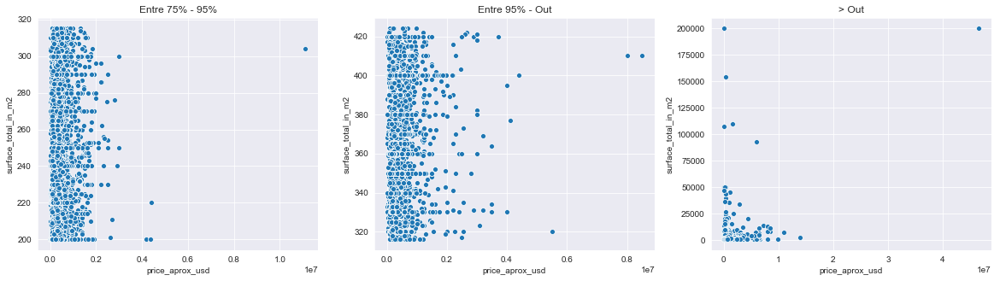

In [52]:
# Me fijo la relación con la variable de dolares totales para ver si son valores que tienen coherencia o si están mal ingresados.TOTAL 
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']>=200) & (df2['surface_total_in_m2']<316)]['price_aprox_usd'],
                y=df2[(df2['surface_total_in_m2']>=200) & (df2['surface_total_in_m2']<316)]['surface_total_in_m2'])
plt.title('Entre 75% - 95%')

plt.subplot(1, 3, 2)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']>=316) & (df2['surface_total_in_m2']<425)]['price_aprox_usd'],
                y=df2[(df2['surface_total_in_m2']>=316) & (df2['surface_total_in_m2']<425)]['surface_total_in_m2'])
plt.title('Entre 95% - Out')

plt.subplot(1, 3, 3)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']>=425)]['price_aprox_usd'],
                y=df2[(df2['surface_total_in_m2']>=425)]['surface_total_in_m2'])
plt.title('> Out');


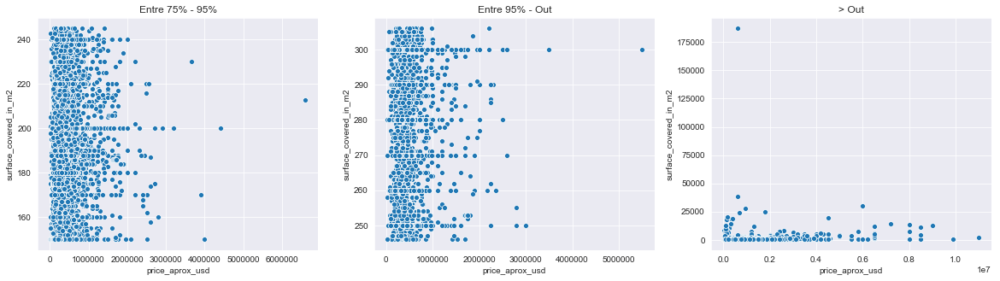

In [53]:
# Me fijo la relación con la variable de dolares totales para ver si son valores que tienen coherencia o si están mal ingresados.COVERED 
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_covered_in_m2']>=150) & (df2['surface_covered_in_m2']<246)]['price_aprox_usd'],
                y=df2[(df2['surface_covered_in_m2']>=150) & (df2['surface_covered_in_m2']<246)]['surface_covered_in_m2'])
plt.title('Entre 75% - 95%')

plt.subplot(1, 3, 2)
sns.scatterplot(x=df2[(df2['surface_covered_in_m2']>=246) & (df2['surface_covered_in_m2']<307)]['price_aprox_usd'],
                y=df2[(df2['surface_covered_in_m2']>=246) & (df2['surface_covered_in_m2']<307)]['surface_covered_in_m2'])
plt.title('Entre 95% - Out')

plt.subplot(1, 3, 3)
sns.scatterplot(x=df2[(df2['surface_covered_in_m2']>=307)]['price_aprox_usd'],
                y=df2[(df2['surface_covered_in_m2']>=307)]['surface_covered_in_m2'])
plt.title('> Out');


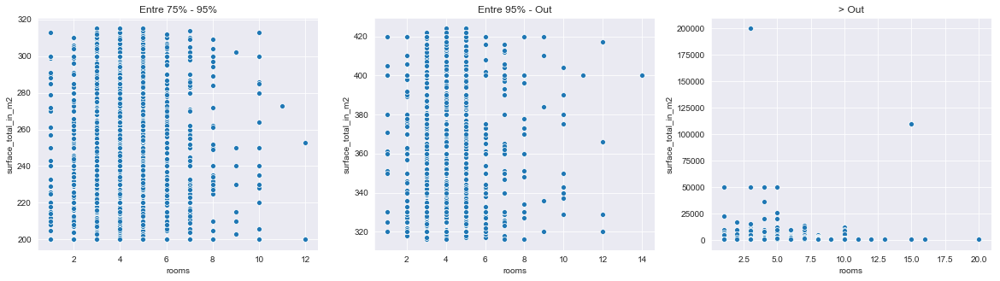

In [54]:
# Me fijo la relación con la variable de ROOMS para ver si son valores que tienen coherencia o si están mal ingresados.TOTAL 
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']>=200) & (df2['surface_total_in_m2']<316)]['rooms'],
                y=df2[(df2['surface_total_in_m2']>=200) & (df2['surface_total_in_m2']<316)]['surface_total_in_m2'])
plt.title('Entre 75% - 95%')

plt.subplot(1, 3, 2)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']>=316) & (df2['surface_total_in_m2']<425)]['rooms'],
                y=df2[(df2['surface_total_in_m2']>=316) & (df2['surface_total_in_m2']<425)]['surface_total_in_m2'])
plt.title('Entre 95% - Out')

plt.subplot(1, 3, 3)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']>=425)]['rooms'],
                y=df2[(df2['surface_total_in_m2']>=425)]['surface_total_in_m2'])
plt.title('> Out');

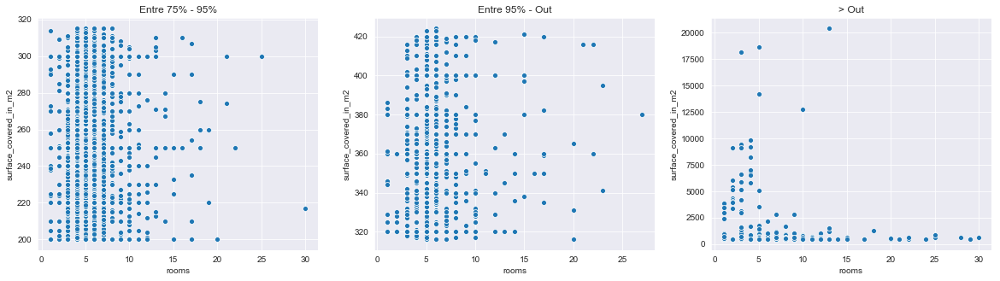

In [55]:
# Me fijo la relación con la variable de ROOMS para ver si son valores que tienen coherencia o si están mal ingresados.COVERED 
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_covered_in_m2']>=200) & (df2['surface_covered_in_m2']<316)]['rooms'],
                y=df2[(df2['surface_covered_in_m2']>=200) & (df2['surface_covered_in_m2']<316)]['surface_covered_in_m2'])
plt.title('Entre 75% - 95%')

plt.subplot(1, 3, 2)
sns.scatterplot(x=df2[(df2['surface_covered_in_m2']>=316) & (df2['surface_covered_in_m2']<425)]['rooms'],
                y=df2[(df2['surface_covered_in_m2']>=316) & (df2['surface_covered_in_m2']<425)]['surface_covered_in_m2'])
plt.title('Entre 95% - Out')

plt.subplot(1, 3, 3)
sns.scatterplot(x=df2[(df2['surface_covered_in_m2']>=425)]['rooms'],
                y=df2[(df2['surface_covered_in_m2']>=425)]['surface_covered_in_m2'])
plt.title('> Out');

Por lo que se observa, sobretodo viendo la cantidad de habitaciones, hay valores de superficie TOTAL y de COVERED por arriba de 10.000 metros cuadrados que están asociados con menos de 5 habitaciones, por lo menos. Dado que una manzana tiene aproximadamente 7000 metros cuadrados. Exploramos qué sucede quedándonos con los valores superiores a ese número

In [56]:
# Nos fijamos la cantidad de valores que puedo considerar mayors a 7000
pd.DataFrame({'Cant mayores 7000':[len(df2[df2['surface_total_in_m2']>=7000]),
                                   len(df2[df2['surface_covered_in_m2']>=7000])]},
             index=['Total','Covered'])
 

,Cant mayores 7000
Total,139
Covered,44


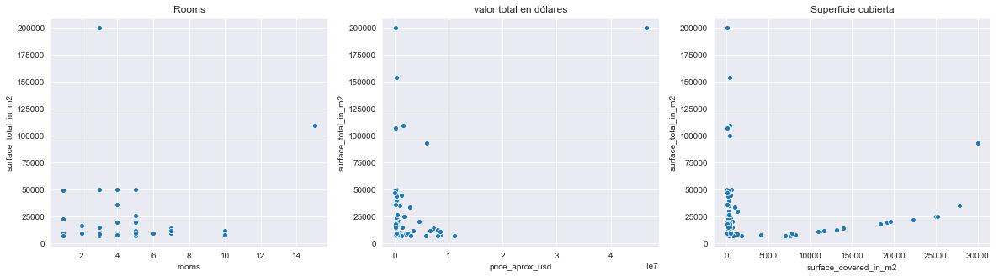

In [57]:
# Me fijo la relación con la variable de precios, rooms, para ver si son valores que tienen coherencia o si están mal ingresados.TOTAL 
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']>=7000)]['rooms'],
                y=df2[(df2['surface_total_in_m2']>=7000)]['surface_total_in_m2'])
plt.title('Rooms')

plt.subplot(1, 3, 2)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']>=7000)]['price_aprox_usd'],
                y=df2[(df2['surface_total_in_m2']>=7000)]['surface_total_in_m2'])
plt.title('valor total en dólares')

plt.subplot(1, 3, 3)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']>=7000)]['surface_covered_in_m2'],
                y=df2[(df2['surface_total_in_m2']>=7000)]['surface_total_in_m2'])
plt.title('Superficie cubierta');

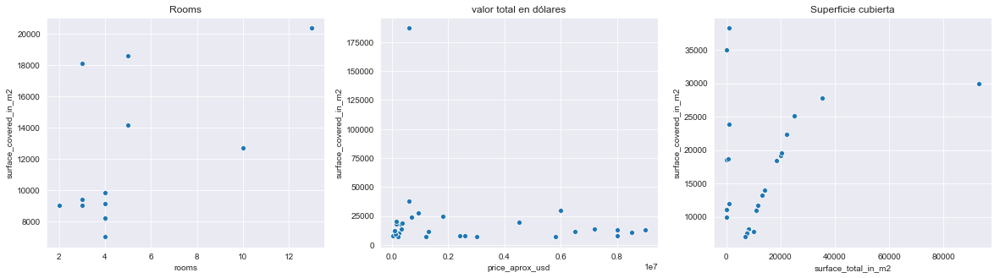

In [58]:
# Me fijo la relación con la variable de precios, rooms, para ver si son valores que tienen coherencia o si están mal ingresados.COVERED 
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_covered_in_m2']>=7000)]['rooms'],
                y=df2[(df2['surface_covered_in_m2']>=7000)]['surface_covered_in_m2'])
plt.title('Rooms')

plt.subplot(1, 3, 2)
sns.scatterplot(x=df2[(df2['surface_covered_in_m2']>=7000)]['price_aprox_usd'],
                y=df2[(df2['surface_covered_in_m2']>=7000)]['surface_covered_in_m2'])
plt.title('valor total en dólares')

plt.subplot(1, 3, 3)
sns.scatterplot(x=df2[(df2['surface_covered_in_m2']>=7000)]['surface_total_in_m2'],
                y=df2[(df2['surface_covered_in_m2']>=7000)]['surface_covered_in_m2'])
plt.title('Superficie cubierta');

Parecería que todos estos valores superiores a los 7000 metros cuadrados podríamos considerarlos como outliers, reemplazarlos por NaN y ver si podemos recuperarlos de la descripción y del título. 

Antes chequeamos que hay inmuebles que tiene >= 10 habitaciones para evaluar si en esos casos corresponden los valores de la superficie total y cubierta

In [59]:
for i,x in zip(df2[(df['rooms']>=10) & (df2['surface_total_in_m2']>=7000)]['description'],df2[(df['rooms']>=10) & (df2['surface_total_in_m2']>=7000)]['title']):
    print (i)
    print (x)
    print ()


Casa Quinta-Zona Santa Coloma Pilar, Ruta 6 , camino a Luján.Casa principal , Casa Caseros, Pileta Completa, Quincho.Lote parquizado 12200 m2Ideal proyecto de Cabañas , Restaurant de Campo, Retiros, etc-Melopropiedades Lujan
Casa en Venta Ruta 6 Pilar B°Santa Coloma 

Casa Quinta-Zona Santa Coloma Pilar, Ruta 6 , camino a Luján.Casa principal , Casa Caseros, Pileta Completa, Quincho.Lote parquizado 12200 m2Ideal proyecto de Cabañas , Restaurant de Campo, Retiros, etc-Melopropiedades Lujan
Casa en Venta Ruta 6 Pilar Santa Coloma 

Hermosa Casa Quinta en zona de Quintas Lujan-Casa Principal con Estilo-Ambientes Luminosos-Amplia Galeria-Pileta 10x5-Parrilla Cubierta-Casa Casero-Vestuarios-Galpon-Añeja Arboleda-Frutales-Zona de Rosales-Zona de Frutales-Zona de Jazmines-Cancha de Futbol Iluminada.Información Personalizada Melopropiedades Lujan 
Casa en Venta Lujan Zona Quintas

Hermosa Casa Quinta con todas las Comodidades-Gran Arboleda, Frutales y Parque-Superficie Terreno aproximado 1 Hec

La descripción muestra que en estos casos en los que tienen más de diez habitaciones corresponden a quintas, con lo cual estos valores no habría que corregirlos

In [60]:
for i,x in zip(df2[(df2['rooms']>=10) & (df2['surface_covered_in_m2']>=7000)]['description'],df2[(df2['rooms']>=10) & (df2['surface_covered_in_m2']>=7000)]['title']):
    print (i)
    print (x)
    print ()

Corredor Responsable: Maximiliano Vazquez - C.M.C.P.S.I 5119Contacto: Cristian Alvarez - MLS ID # 420101234-2Casa en dos plantas ideal dos familia o como inversión. Son dos P.H. con entrada independiente, se vende en conjunto.   Planta baja:  2 dormitorios. Cocina comedor. Sala de estar. Living. 2 habitaciones. 2 baños. Cuarto de guardado. Jardín con parrilla. Cochera.  Planta alta:  3 dormitorios. Living comedor. cocina. 1 baño completo. Lavadero. Altillo.  Terraza. Balcón.  Martillero y Corredor Responsable: Rebeca Stern CUCICBA 4824 / Maximiliano Vazquez CSI 5119     
Casa atípica, ideal 2 familias

Corredor Responsable: Matiaz Ruiz Moreno - CPCPI 4740Contacto: Cecilia Manzano - MLS ID # 420581067-17Esta casa se encuentra a 300m de ruta 38 y a 400m del centro,en un area residencial muy tranquila. Con gas natural. Tiene una cocina comedor,living dispuestos en un gran ambiente. 5 dormitorios,2 baños ,patio interno,lavadero grande con otro baño,entrada para auto techada,rejas en el fre

En los valores covered, tampoco habría que sacar estos valores ya que corresponden con el tipo de propiedad. 

Ahora chequeo aquellos que tienen menos de 10 dormitorios

In [61]:
for i,x,y in zip(df2[(df2['rooms']<10) & (df2['surface_total_in_m2']>=7000)]['description'],
               df2[(df2['rooms']<10) & (df2['surface_total_in_m2']>=7000)]['title'],
              df2[(df2['rooms']<10) & (df2['surface_total_in_m2']>=7000)].index.values):
    print (y)
    print (i)
    print (x)
    print ()

1577
Tres fracciones de tierra de 41 x 96,60 (dos de ellas unificadas) con frente a dos calles - Casa de tres ambientes con cocina y dos baños - 4 galpones (100, 140, 170 y 290 M2 cada uno) 3 invernaderos ( 920, 450 y 2760 M2 cada uno) y un Depósito (40 M2) - Base para un quinto galpón de 290 M2 - Trifásica - Bomba sumergible con riego y abastecimiento para los galpones e invernaderos - Galpones equipados para cría de conejos - Fácil acceso a 10 Km. de Mar del Plata y 1000 mts. de la Ruta Nacional Nº 2 _ Se otorgan facilidades de pago a convenir - Toma valores en parte de pago - Ideal para emprendimiento comercial, Granja, Casaquinta, Instituciones, etc.      Tres fracciones de tierra de 41 x 96,60 (dos de ellas unificadas) con frente a dos calles - Casa de tres ambientes con cocina y dos baños - 4 galpones (100, 140, 170 y 290 M2 cada uno) 3 invernaderos ( 920, 450 y 2760 M2 cada uno) y un Depósito (40 M2) - Base para un quinto galpón de 290 M2 - Trifásica - Bomba sumergible con riego

De los inmuebles revisados, las entradas 2249 (con 65m2) y la 24548 no tienen valores en la descripción que respalden los valores de superficie total. 

En la entrada 2249 agrego el 65m2 en superficie total. En la entrada 24548, ponemos un NaN en superficie total dado que no hay infomración para rescatar de la descripción 

In [62]:
df2.at[2249,'surface_total_in_m2']=65
df2.at[24548,'surface_total_in_m2']=np.nan

In [63]:
df2[(df['rooms']<10) & (df2['surface_covered_in_m2']>=7000)]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
78,78,sell,house,Posadas,|Argentina|Misiones|Posadas|,Argentina,Misiones,3429886.0,"-27.3554665957,-55.9021115026",-27.355467,-55.902112,5500000.0,ARS,5442626.35,308460.22,261.0,18615.0,1181.839923,295.460650,NaN,5.0,NaN,http://www.properati.com.ar/15byn_venta_casa_p...,"S/AVDA COSTANERA , NUEVA ZONA GASTRONOMICA...",Oportunidad! Casa zona Bahía el Brete,https://thumbs4.properati.com/2/18AMH0DDp4Xboq...
24013,24013,sell,apartment,Pinamar,|Argentina|Buenos Aires Costa Atlántica|Pinamar|,Argentina,Buenos Aires Costa Atlántica,3429971.0,"-37.127596,-56.904824",-37.127596,-56.904824,110000.0,USD,1940895.00,110000.00,NaN,9435.0,NaN,11.658718,NaN,3.0,NaN,http://www.properati.com.ar/17nd0_venta_depart...,Corredor Responsable: Daniel Aibe - CMCPD 1155...,Departamento en complejo cerrado,https://thumbs4.properati.com/3/ovF57ytb9aNhNq...
27214,27214,sell,apartment,Mendoza,|Argentina|Mendoza|,Argentina,Mendoza,3844419.0,"-32.899757,-68.787117",-32.899757,-68.787117,1100000.0,ARS,1088525.19,61692.04,NaN,9066.0,NaN,121.332451,1.0,2.0,NaN,http://www.properati.com.ar/17swd_venta_depart...,Corredor Responsable: Real Estate New Generati...,"Departamento en venta, Villa Nueva, Guaymallén",https://thumbs4.properati.com/0/no9nStcm49Zq1f...
27216,27216,sell,apartment,Mendoza,|Argentina|Mendoza|,Argentina,Mendoza,3844419.0,"-32.899757,-68.787117",-32.899757,-68.787117,1350000.0,ARS,1335917.32,75712.96,NaN,9066.0,NaN,148.908008,1.0,3.0,NaN,http://www.properati.com.ar/17swp_venta_depart...,Corredor Responsable: Real Estate New Generati...,"Departamento en venta, Villa Nueva, Guaymallén",https://thumbs4.properati.com/0/hRmaqUg3bF5a5s...
27217,27217,sell,apartment,Mendoza,|Argentina|Mendoza|,Argentina,Mendoza,3844419.0,"-32.899757,-68.787117",-32.899757,-68.787117,1100000.0,ARS,1088525.19,61692.04,NaN,9066.0,NaN,121.332451,1.0,2.0,NaN,http://www.properati.com.ar/17swq_venta_depart...,Corredor Responsable: Real Estate New Generati...,"Departamento en venta, Villa Nueva, Guaymallén",https://thumbs4.properati.com/5/d5MAIHzETOSv2J...
38271,38271,sell,house,Moreno,|Argentina|Bs.As. G.B.A. Zona Oeste|Moreno|Mor...,Argentina,Bs.As. G.B.A. Zona Oeste,3430550.0,"-34.586584,-58.849554",-34.586584,-58.849554,325000.0,USD,5734462.50,325000.00,NaN,14210.0,NaN,22.871217,NaN,5.0,NaN,http://www.properati.com.ar/18kts_venta_casa_m...,Corredor Responsable: Hernan Perrone - CMCPDJM...,Impecable casa estilo Country. Muy buen estado!,https://thumbs4.properati.com/8/HzQv-cpa_OJq6w...
56484,56484,sell,apartment,Monte Castro,|Argentina|Capital Federal|Monte Castro|,Argentina,Capital Federal,3430596.0,"-34.618411,-58.497949",-34.618411,-58.497949,138000.0,USD,2434941.00,138000.00,NaN,9152.0,NaN,15.078671,3.0,4.0,NaN,http://www.properati.com.ar/19r6g_venta_depart...,Corredor Responsable: Uno Bienes Raices SRL - ...,Excelente depto de 4 ambienes muy luminoso,https://thumbs4.properati.com/3/9cbQ2O2xogFYuP...
56791,56791,sell,house,Liniers,|Argentina|Capital Federal|Liniers|,Argentina,Capital Federal,3431333.0,"-34.642482,-58.528451",-34.642482,-58.528451,165000.0,USD,2911342.50,165000.00,NaN,8175.0,NaN,20.183486,NaN,4.0,NaN,http://www.properati.com.ar/19rpq_venta_casa_l...,Corredor Responsable: Jorge Salafia - CUCICBA ...,Venta casa 4 amb. c/cochera en Liniers,https://thumbs4.properati.com/5/fkQbchZwCeg_Vm...
57273,57273,sell,apartment,Villa Elvira,|Argentina|Bs.As. G.B.A. Zona Sur|La Plata|Vil...,Argentina,Bs.As. G.B.A. Zona Sur,3832749.0,"-34.954918,-57.88692",-34.954918,-57.886920,470000.0,ARS,465097.02,26359.32,NaN,8225.0,NaN,57.142857,2.0,4.0,NaN,http://www.properati.com.ar/19si6_venta_depart...,Corredor Responsable: Marcelo Di Girolamo - C....,Departamento 3

In [64]:
for i,x,y in zip(df2[(df['rooms']<10) & (df2['surface_covered_in_m2']>=7000)]['description'],
               df2[(df2['rooms']<10) & (df2['surface_covered_in_m2']>=7000)]['title'],
              df2[(df2['rooms']<10) & (df2['surface_covered_in_m2']>=7000)].index.values):
    print (y)
    print (i)
    print (x)
    print ()

78
S/AVDA   COSTANERA ,  NUEVA  ZONA GASTRONOMICA  FRENTE AL BALNEARIO EL BRETE. IDEAL VIVIENDA  FLIAR. MAS EMPRENDIMIENTO  COMERCIAL  APTO RESTAURANTE Y PARRILLA. PLANTA ALTA 3 DORM (1 EN SUITE)  PATIO FRENTE Y FONDO, $  5. 500.000.- SE RECIBE  INMUEBLE A CUENTA. TERRENO 24.14 x 10.78. CUENTA CON BAÑO PARA DISCAPACITADO, Y HABILITACION PARA COMERCIO GASTRONOMICO.
Oportunidad! Casa zona Bahía el Brete

24013
Corredor Responsable: Daniel Aibe - CMCPD 1155Contacto: Andrea Galeano - MLS ID # 420351025-69El complejo Portal Tomeg se encuentra a 25 cuadras del mar casi sobre la Ruta Nac. N° 11 en la Ciudad de Ostende. Se encuentra a 10 minutos de los principales puntos turísticos como Valeria del Mar, Mar de Ostende, Pinamar y Cariló con un fácil acceso.  Es un espacio cerrado con seguridad.  El complejo cuenta con parrilla, cochera asignada a cada unidad, un espacio recreativo con decks, bosque y pileta con vestuarios, duchas y baños en las mismas.  Está diseñado para disfrutar tanto de día

Casi todos estos casos tiene NaN en los valores de superficie total y tienen valores en cubierta; más adelante si no hay información que se recupere de la descripción, en estos casos repetiremos los valores en ambas columnas. 

En el 78 el valor en cubierta es un error, habría que reemplazarlo x nan

In [65]:
# realizamos los cambios en el df2
df2.at[78,'surface_covered_in_m2']=np.nan


Revisamos ahora si hay valores de superficie total asociados con valores de precios en forma inconsistente


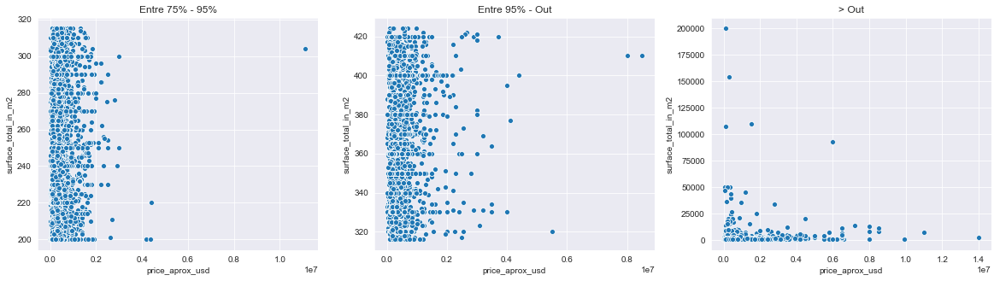

In [66]:
# Me fijo la relación con la variable de dolares totales para ver si son valores que tienen coherencia o si están mal ingresados.TOTAL 
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']>=200) & (df2['surface_total_in_m2']<316)]['price_aprox_usd'],
                y=df2[(df2['surface_total_in_m2']>=200) & (df2['surface_total_in_m2']<316)]['surface_total_in_m2'])
plt.title('Entre 75% - 95%')

plt.subplot(1, 3, 2)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']>=316) & (df2['surface_total_in_m2']<425)]['price_aprox_usd'],
                y=df2[(df2['surface_total_in_m2']>=316) & (df2['surface_total_in_m2']<425)]['surface_total_in_m2'])
plt.title('Entre 95% - Out')

plt.subplot(1, 3, 3)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']>=425)]['price_aprox_usd'],
                y=df2[(df2['surface_total_in_m2']>=425)]['surface_total_in_m2'])
plt.title('> Out');

1) Los precios más inconsistentes que muestran estos gráficos parecen los correspondientes a inmuebles con superficies totales muy grandes (mayores a 7000m2 que es el tamaño aprox. de una manzana) pero con precios que son menores a los 2.000.000 millones de dólares.

2) También hay precios muy elevados de 14.000.000 millones de dolares que parecerían estar asociados a superficies totales cercans a cero

- 1) Revisamos el punto 1

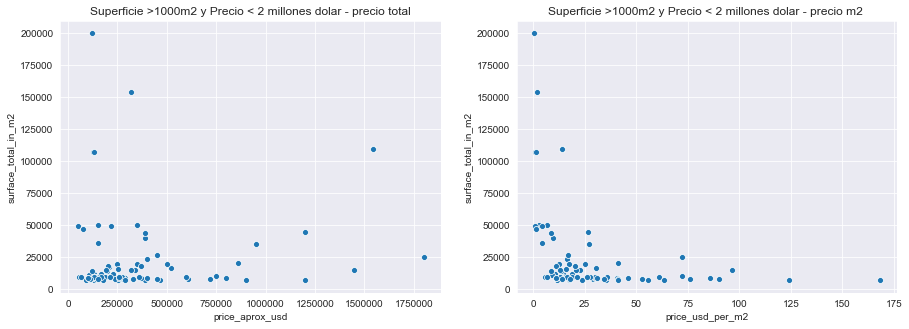

In [67]:
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']>=7000)&(df2['price_aprox_usd']<2000000)]['price_aprox_usd'],
                y=df2[(df2['surface_total_in_m2']>=7000)&(df2['price_aprox_usd']<2000000)]['surface_total_in_m2'])
plt.title('Superficie >1000m2 y Precio < 2 millones dolar - precio total');

plt.subplot(1, 2, 2)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']>=7000)&(df2['price_aprox_usd']<2000000)]['price_usd_per_m2'],
                y=df2[(df2['surface_total_in_m2']>=7000)&(df2['price_aprox_usd']<2000000)]['surface_total_in_m2'])
plt.title('Superficie >1000m2 y Precio < 2 millones dolar - precio m2 ');

Según estas relaciones, hay valores de superficie muy elevadas (25000) que están asociadas a precios bajos y a precios por metro cuadrado menores a 50 dólares. 

Revisamos qué sucede en estos casos. 

In [68]:
df2[(df2['surface_total_in_m2']>25000)][['price_aprox_usd','price_usd_per_m2']].describe().round(2)

,price_aprox_usd,price_usd_per_m2
count,21.00,21.00
mean,926568.43,15.77
std,1361945.47,21.21
min,49800.00,0.60
25%,150000.00,2.07
50%,390000.00,8.89
75%,1200000.00,16.96
max,6000000.00,82.04


C:\Users\Agustin Ibanez\Anaconda3\lib\site-packages\numpy\lib\histograms.py:754: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
C:\Users\Agustin Ibanez\Anaconda3\lib\site-packages\numpy\lib\histograms.py:755: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


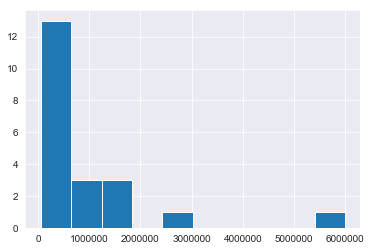

In [69]:
plt.hist(df2[(df2['surface_total_in_m2']>25000)]['price_aprox_usd']);

Hay 21 entradas con valores de superficie total mayores a 25000. Revisamos aquellos valores que están por debajo de los 3000000 millones de dólares

In [70]:
df2[(df2['surface_total_in_m2']>25000) & (df2['price_aprox_usd']<3000000)].pivot_table(index='property_type',
                                                   aggfunc={'price_aprox_usd':('median','mean','min','max','count'),
                                                            'surface_total_in_m2':('median','mean','min','max','count')}).round(2)

price_aprox_usd                                             \
                        count         max       mean    median       min   
property_type                                                              
apartment                   5   132357.47  100587.40  120000.0   49800.0   
house                      15  2800000.00  863666.67  450000.0  150000.0   

              surface_total_in_m2                                          
                            count       max       mean    median      min  
property_type                                                              
apartment                       5  200000.0  102170.00  107000.0  47050.0  
house                          15  154438.0   61992.07   45000.0  26536.0

In [71]:
index_aux=df2[(df2['surface_total_in_m2']>25000) & (df2['price_aprox_usd']<3000000)].index.values

In [72]:
for i,x,z,a,b in zip(df2.loc[index_aux,'description'],df2.loc[index_aux,'title'],index_aux,
                 df2.loc[index_aux,'price_aprox_usd'], df2.loc[index_aux,'surface_total_in_m2']):
    print (z)
    print (i)
    print (x)
    print ('Precio en usd = ' + str(a))
    print ('Sup total en m2 = ' + str(b))
    print ()

509
SEPTIEMBRE Excelente chacra sobre 4,5 Has en Belen de Escobar.Ubicacion: Belen de Escobar, bajada del km 54 de la Panamericana (ruta 9), ingresando por la calle Boote acceso al Barrio Cerrado San Sebastian. A 500 mts de la entrada del barrio.Nos encontramos con una Residencia construida por el estudio Lacroze Miguens Prati.Compuesta con living con hogar con puerta ventana a galeria. Comedor , escritorio, hall de distribucion vidriado. Dos dormitorios en planta baja, uno en suite, otro baÃ±o completo. Cocina, deposito, dependencias de servicio con baÃ±o.PA: Master suite con baÃ±o completo compartimentado y vestidor.Pisos entablonados en madera y microcemento alisado.Detalles de categoria.Casa de Caseros.Sector de parrila, fogon, quincho. Gimnasio.Deposito. Gran Pileta con filtro. Cancha de Tenis.Totalmente parquizado por paisajista Thays con arboles de diversas especies.Superficie Terreno: 4,5 hasCubierta: 500 m2
Casa 45000m² con 2 Plantas, Escobar, Belén de Escobar, por U$S 1.200.0

In [73]:
df2.head(1)

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
0,0,sell,PH,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6618237,-58.5088387",-34.661824,-58.508839,62000.0,USD,1093959.0,62000.0,55.0,40.0,1127.272727,1550.0,NaN,NaN,NaN,http://www.properati.com.ar/15bo8_venta_ph_mat...,"2 AMBIENTES TIPO CASA PLANTA BAJA POR PASILLO,...",2 AMB TIPO CASA SIN EXPENSAS EN PB,https://thumbs4.properati.com/8/BluUYiHJLhgIIK...


A partir de revisar estos inmuelbes particulare se encuentra que las entradas:
    - 11534 tiene el mismo valor en precio y en superficie total, se procede a reemplazar x nan el valor de superficie.
    - 13405 la descripción no coincide con e la superficie, se ponen nan en los valores de superficie
    - 99248 el m2 no corresponde a un dpto de la descripción del inmueble, se colocan nans en la superficie

In [74]:
df2.at[11534,'surface_total_in_m2']=np.nan

In [75]:
df2.at[13405,'surface_total_in_m2']=np.nan

In [76]:
df2.at[99248,'surface_total_in_m2']=np.nan

- 2) Reivsamos precios + de de 14.000.000 millones de dolares que parecerían estar asociados a superficies totales cercanas a 5000 m2 (que es veces una manzana aprox)

In [77]:
index_aux=df2[(df2['surface_total_in_m2']<5000)&(df2['price_aprox_usd']>10000000)].index.values

In [78]:
for i,x,z,a,b in zip(df2.loc[index_aux,'description'],df2.loc[index_aux,'title'],index_aux,
                 df2.loc[index_aux,'price_aprox_usd'], df2.loc[index_aux,'surface_total_in_m2']):
    print (z)
    print (i)
    print (x)
    print ('Precio en usd = ' + str(a))
    print ('Sup total en m2 = ' + str(b))
    print ()

34638
Excelente zona. Cerca de la Quinat Presidencial. Entre Uribelarrea y Villate. Zonificacion. Exclente lote con 43 mts de Frente sobre Libertador. ZONFICIACION: T3L. Apto PB y 7 pisos mÃ¡s. 8 pisos en total. FOT 2,65. FOZ 0,60. PREMIUM AA. Acepta pago en metros tambiÃ©n.
Casa 2079m² en Del Libertador, Av. 2200, Vicente López, Olivos, por U$S 14.000.000
Precio en usd = 14000000.0
Sup total en m2 = 2079.0

45689
CODIGO: 2062-670 ubicado en: URQUIZA 7900 -  Publicado por: INMOBILIARIA DEN/MARK . El precio es de USD 11111111 null. VENTA CASA AL FRENTE. 3 DORMITORIOS. 2 BAÑOS. LIVING. COCINA. PATIO JARDIN. COCHERA.  . Publicado a través de Mapaprop
VENTA CASA AL FRENTE. 3 DORMITORIOS. 2 BAÑOS. LIVING. COCINA. PATIO JARDIN. PILETA. COCHERA. 9 X 33.78
Precio en usd = 11111111.0
Sup total en m2 = 304.0

114131
CODIGO:  ubicado en: MONSEÑOR TERRERO , Ituzaingó, Buenos Aires. -  Publicado por: SABRINA ALVAREZ PROPIEDADES. El precio es de USD 12000000 null. EXCELENTE PROPIEDAD, APTA CREDITO H

Las entradas 45689 y 114131 parecerían presentar valores inconsistentes entre los m2 y el precio total, en estas variables se convierte en nan el precio. La entrada 34638 parecería corresponder x la zona y el tamaño con el precio del aviso

In [79]:
df2.at[45689,'price_aprox_usd']=np.nan

In [80]:
df2.at[114131,'price_aprox_usd']=np.nan

Por último, de la superficies cubiertas, revisamos un caso en el cual una superficie de más de 1750.000 metros está asociada con un costo menor de 2.000.000 millones 

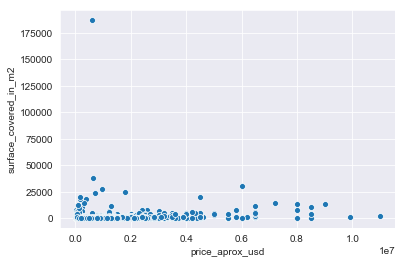

In [81]:
sns.scatterplot(x=df2[(df2['surface_covered_in_m2']>=307)]['price_aprox_usd'],
                y=df2[(df2['surface_covered_in_m2']>=307)]['surface_covered_in_m2']);

In [82]:
df2[(df2['surface_covered_in_m2']>175000)]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
76012,76012,sell,apartment,Barrio Norte,|Argentina|Capital Federal|Barrio Norte|,Argentina,Capital Federal,3436109.0,"-34.5945726028,-58.409166395",-34.594573,-58.409166,600000.0,USD,10586700.0,600000.0,NaN,187000.0,NaN,3.208556,NaN,NaN,11000.0,http://www.properati.com.ar/1ar12_venta_depart...,Barrio Norte EXCELENTE Semipiso al Frente Balc...,Excelente PISO en Barrio Norte,https://thumbs4.properati.com/0/Z9TPL-aDoGIWcI...


In [83]:
display(df2.loc[76012,'description'])
display(df2.loc[76012,'title'])

'Barrio Norte EXCELENTE Semipiso al Frente Balcón Corrido Superficie 187 metros todos los Ambientes Muy Luminosos y Soleados - Palier privado.  4 dormitorios - c/dependencia servicio - 4 bañosRecepción y Comedor,Cocina con Comedor Diario y Lavadero Cochera Fija y gran Baulera Sercios Centrales Edificio con Entrada de Cortesía Expensas Incluye Aysa y Vigilancia $11.000.- '

'Excelente PISO en Barrio Norte'

Encontramos un error en cómo fue anotada la superficie que pasamos a corregir

In [84]:
df2.at[76012,'surface_covered_in_m2']=187

- Encontramos que la mayoría de valores extremos en las superficies corresponden a inmuebles de gran tamaño. 

- En algunos casos, encontramos valores que no correspondían y que fueron reemplazados por sus valores correctos (en función de la descripción o del título), o por valores nan si no había información para hacer la corrección. 

- Estos valores se impactaron en el df2, que es el dataframe que se seguirá explorando en las próximas etapas, y en el que se impactaran los cambios. 

## 2.3 Analizamos los valores "0" o menores a 20m2 para la Superficie total y/o la superficie cubierta

In [85]:
# Nos fijamos la cantidad de valores que puedo considerarse iguales a 0 y menores a 30ms(lo revisamos en el dataframe corregido)
pd.DataFrame({'Cant 0': [len(df[(df2['surface_total_in_m2']==0)]),
                         len(df[(df2['surface_covered_in_m2']==0)])],
              'Cant >0 y <20': [len(df2[(df2['surface_total_in_m2']>0) & (df2['surface_total_in_m2']<=20)]),
                                len(df2[(df2['surface_covered_in_m2']>0) & (df2['surface_covered_in_m2']<=20)])]},
             index=['Total','Covered'])

,Cant 0,Cant >0 y <20
Total,383,251
Covered,2,1940


In [86]:
# Nos fijamos en las que tienen 0 en el total, qué valores tienen en superficie cubierta (para reemplazarlos considerando la cubierta, como la superficie total de la propiedad)
df2['surface_covered_in_m2'][df2['surface_total_in_m2']==0].isnull().sum()

383

En los casos que encontramos 0 en la superficie total, tenemos valores nan en la superficie cubierta. Para que queden identificados estos datos de la columna total como datos faltantes, los impactamos en el dataframe 2 como nans

In [87]:
indices_cero_values_total=df2['surface_total_in_m2'][df2['surface_total_in_m2']==0].index.values

In [88]:
df2.at[indices_cero_values_total,'surface_total_in_m2']=np.nan

In [89]:
# Nos fijamos en los dos casos que tiene 0 en la superficie covered
df2[df2['surface_covered_in_m2']==0]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
7949,7949,sell,apartment,Palermo Soho,|Argentina|Capital Federal|Palermo|Palermo Soho|,Argentina,Capital Federal,3430234.0,"-34.588889,-58.430556",-34.588889,-58.430556,102800.0,USD,1813854.6,102800.0,32.0,0.0,3212.500000,NaN,NaN,NaN,NaN,http://www.properati.com.ar/15zn5_venta_depart...,"A solo 1 cuadra de Av Córdoba y 2 de Honduras,...",Departamento - Palermo Soho,https://thumbs4.properati.com/2/eJHLQkDuQlnjln...
28938,28938,sell,apartment,San Telmo,|Argentina|Capital Federal|San Telmo|,Argentina,Capital Federal,3428113.0,"-34.6234536,-58.3764477",-34.623454,-58.376448,22400.0,USD,395236.8,22400.0,13.0,0.0,1723.076923,NaN,NaN,NaN,1800.0,http://www.properati.com.ar/17xm3_venta_depart...,"Departamento de 2 ambientes, con bajo mesada, ...",Departamento - San Telmo,https://thumbs4.properati.com/4/mvGoVviheZmfXv...


In [90]:
# revisamos el que tiene 13 m2 de superficie total de estos dos
display(df2.loc[28938,'description'])
display(df2.loc[28938,'title'])
print()

'Departamento de 2 ambientes, con bajo mesada, baño completo. domitorio con placars aire acondicionado. Edificio con gran potencial para alquilar por su ubicación y los amenities.Fideicomiso al costo Le Bleu Negocios InmobiliariosVirrey Olaguer y Feliú 2623 C.A.B.A.Tel:   PROP LBU4747 AP307661Nº Matrícula 5691 Colegio San Isidro CUCICBA 397'

'Departamento - San Telmo'

In [91]:
# revisamos el que tiene 32 m2 de superficie total de estos dos
display(df2.loc[7949,'description'])
display(df2.loc[7949,'title'])
print()

'A solo 1 cuadra de Av Córdoba y 2 de Honduras, cercano también a Scalabrini Ortiz, en justo equilibrio entre la vorágine del tránsito de la avenida y la serenidad que brindan las calles internas, el emprendimiento ofrecerá unidades amplias y luminosas de 1, 2 y 3 ambientes, con planta flexible y configuración customizada - de entre 30 a 70 m2 de superficie total - que podrán combinarse según las necesidades del usuario final.Por otra parte, su cercanía con la Universidad de Palermo y el Sanatorio Guemes lo convierte en una interesante propuesta de renta temporaria.Se trata de un edificio moderno y de calidad que reunirá importantes diferenciales: se ubica en un terreno de doble frente, contará con un Hall de Acceso en doble altura con exclusivos detalles decorativos y amenities de excelencia.Un producto de excelencia que aúna la arquitectura con el arte y lo expresivo a través de la inclusión de modernos vitraux.Un aporte que personaliza al proyecto al tiempo que amplía las prestacion

'Departamento - Palermo Soho'

Son dos departamentos, en los que la superficie total coincidiría con la superficie cubierta. En el que tiene 13m2 de superficie total, no se especifica información nueva en la descripción, así que asumimos que no es un error. 

Dado que son departamentos, asumimos que los datos cubiertos tienen que coincidir con los totales, así que los pisamos en el df2.

In [92]:
df2.at[7949,'surface_covered_in_m2']=df2.loc[7949,'surface_total_in_m2']
df2.at[28938,'surface_covered_in_m2']=df2.loc[28938,'surface_total_in_m2']

Revisamos ahora los valores totales que tienen menos de 20m2 para evaluar si hay datos erroneos (usamos el df2 que ya tiene impactado los cambios respecto de los valores cero que encontramos)

,surface_total_in_m2
20.0,86
18.0,43
19.0,21
10.0,21
16.0,15
17.0,15
14.0,14
12.0,12
15.0,10
11.0,8


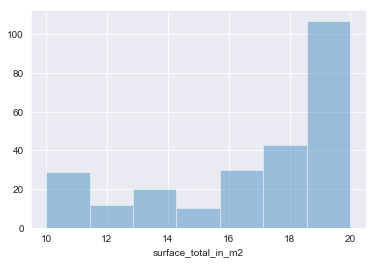

In [93]:
display(pd.DataFrame(df2['surface_total_in_m2'][(df2['surface_total_in_m2']>0) & (df2['surface_total_in_m2']<=20)].value_counts()))
sns.distplot(df2['surface_total_in_m2'][(df2['surface_total_in_m2']>0) & (df2['surface_total_in_m2']<=20)],kde=False);

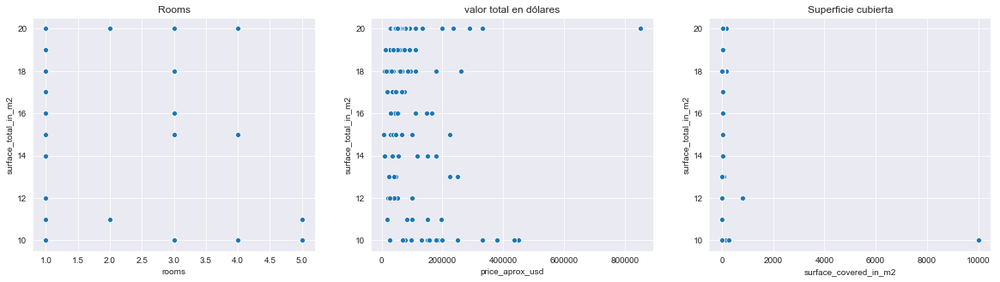

In [94]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']>0) & (df2['surface_total_in_m2']<=20)]['rooms'],
                y=df2[(df2['surface_total_in_m2']>0) & (df2['surface_total_in_m2']<=20)]['surface_total_in_m2'])
plt.title('Rooms')

plt.subplot(1, 3, 2)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']>0) & (df2['surface_total_in_m2']<=20)]['price_aprox_usd'],
                y=df2[(df2['surface_total_in_m2']>0) & (df2['surface_total_in_m2']<=20)]['surface_total_in_m2'])
plt.title('valor total en dólares')

plt.subplot(1, 3, 3)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']>0) & (df2['surface_total_in_m2']<=20)]['surface_covered_in_m2'],
                y=df2[(df2['surface_total_in_m2']>0) & (df2['surface_total_in_m2']<=20)]['surface_total_in_m2'])
plt.title('Superficie cubierta');

- Una vez eliminados los inmuebles con superficies totales =0, el valor mínimo es 10
- (i) En relación a la variable "rooms", hay algunos inmuebles que a pesar de tener <20m2 tiene 4 o más habitaciones. Vamos a revisar estos valores
- (ii) Vamos a revisar también que hay departamento de 10 m2 que tienen valores de precio muy alto
- (iii) Vamos a revisar también dptos que tienen 20m2 y tienen un costo de más de 800.000
- (iv) Hay departamentos que tienen 10m2 totales y un valor extremo de 10.000 cubiertos

In [95]:
#(i) En relación a la variable "rooms", hay algunos inmuebles que a pesar de tener <20m2 tiene 4 o más habitaciones. Vamos a revisar estos valores
df2[(df2['surface_total_in_m2']>0) & (df2['surface_total_in_m2']<=20) & (df2['rooms']>=4)]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
12625,12625,sell,apartment,Pinamar,|Argentina|Buenos Aires Costa Atlántica|Pinamar|,Argentina,Buenos Aires Costa Atlántica,3429971.0,"-37.0985665013,-56.8533657979",-37.098567,-56.853366,330000.0,USD,5822685.0,330000.0,20.0,20.0,16500.0,2357.142857,NaN,4.0,NaN,http://www.properati.com.ar/16mfp_venta_depart...,Moderno Departamento en exclusivo barrio cerra...,"Departamento en Barrio Cerrado ""Terrazas al Golf""",https://thumbs4.properati.com/2/oQml1_MJq45HyR...
14873,14873,sell,apartment,Villa Madero,|Argentina|Bs.As. G.B.A. Zona Oeste|La Matanza...,Argentina,Bs.As. G.B.A. Zona Oeste,3427405.0,"-34.7133000809,-58.5083357446",-34.713300,-58.508336,78000.0,USD,1376271.0,78000.0,10.0,10.0,7800.0,7800.000000,NaN,4.0,NaN,http://www.properati.com.ar/16te6_venta_depart...,Hermoso departamento ubicado en la localidad d...,Depto 4 Amb Ricchieri,https://thumbs4.properati.com/4/qOo2dsiz8s8r3N...
30447,30447,sell,apartment,La Tablada,|Argentina|Bs.As. G.B.A. Zona Oeste|La Matanza...,Argentina,Bs.As. G.B.A. Zona Oeste,NaN,"-34.7074825,-58.5382528",-34.707483,-58.538253,30000.0,USD,529335.0,30000.0,15.0,NaN,2000.0,NaN,NaN,4.0,NaN,http://www.properati.com.ar/181ds_venta_depart...,Habitacion prioncipal amplia2 Dormitorios1 Liv...,Departamento venta,https://thumbs4.properati.com/2/tlWpqLOyxtYFAN...
34083,34083,sell,PH,Ramos Mejía,|Argentina|Bs.As. G.B.A. Zona Oeste|La Matanza...,Argentina,Bs.As. G.B.A. Zona Oeste,3429617.0,NaN,NaN,NaN,160000.0,USD,2823120.0,160000.0,10.0,120.0,16000.0,1333.333333,NaN,4.0,NaN,http://www.properati.com.ar/18b9c_venta_ph_ram...,"Ph al frente, 3 dormitorios, living comedor, ...",PH en Venta Ramos Mejia / La Matanza (A108 6014),https://thumbs4.properati.com/3/ToO6eO4jGQqMUw...
34307,34307,sell,house,"Barrio Cerrado ""La Delfina""",|Argentina|Bs.As. G.B.A. Zona Norte|Pilar|Barr...,Argentina,Bs.As. G.B.A. Zona Norte,NaN,"-34.4552767,-58.867316",-34.455277,-58.867316,380000.0,USD,6704910.0,380000.0,10.0,270.0,38000.0,1407.407407,NaN,5.0,NaN,http://www.properati.com.ar/18bor_venta_casa_b...,"Preciosa casa en La delfina, consta de un dorm...",Casa venta,https://thumbs4.properati.com/2/vwzvqa5YMgOdNJ...
50675,50675,sell,house,Castelar,|Argentina|Bs.As. G.B.A. Zona Oeste|Morón|Cast...,Argentina,Bs.As. G.B.A. Zona Oeste,3435607.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11.0,NaN,NaN,NaN,NaN,5.0,NaN,http://www.properati.com.ar/19er4_venta_casa_b...,"CASTELAR NORTE, 5 DORMITORIOS,4 BAOS, COCINA C...",HERMOSA PROPIEDAD CASTELAR-COD 307,https://thumbs4.properati.com/0/nzaa65WWurOTP2...
50696,50696,sell,house,El Palomar,|Argentina|Bs.As. G.B.A. Zona Oeste|Morón|El P...,Argentina,Bs.As. G.B.A. Zona Oeste,3434509.0,NaN,NaN,NaN,180000.0,USD,3176010.0,180000.0,10.0,10.0,18000.0,18000.000000,NaN,4.0,NaN,http://www.properati.com.ar/19ery_venta_casa_b...,"Impecable propiedad en Palomar, frente a la ba...",HERMOSA PROPIEDAD EN PALOMAR CODIGO PA 02,https://thumbs4.properati.com/6/EGrAaBxkNQfjMZ...
62284,62284,sell,house,Haedo,|Argentina|Bs.As. G.B.A. Zona Oeste|Morón|Haedo|,Argentina,Bs.As. G.B.A. Zona Oeste,NaN,NaN,NaN,NaN,290000.0,USD,5116905.0,290000.0,20.0,150.0,14500.0,1933.333333,NaN,4.0,NaN,http://www.properati.com.ar/1a6x0_venta_casa_h...,Chalet en excelente ubicacion: haedo chico.el ...,Chalet en Venta Haedo / Moron (A195 1931),https://thumbs4.properati.com/6/ydSrWeQqFuuwgX...
120124,120124,sell,apartment,Pinamar,|Argentina|Buenos Aires Costa Atlántica|Pinamar|,Argentina,Buenos Aires Costa Atlántica,3429971.0,"-37.1143446221,-56.8624922624",-37.114345,-56.862492,235000.0,USD,4146457.5,235000.0,20.0,20.0,11750.0,1958.333333,NaN,4.0,NaN,http://www.properati.com.ar/1chjp_venta_depart...,"EL EDIFICIO CUENTA CON ENCARGADO PERMANENT

In [96]:
for i,x,z,a,b in zip(df2['description'][(df2['surface_total_in_m2']>0) & (df2['surface_total_in_m2']<=20) & (df2['rooms']>=4)],
               df2['title'][(df2['surface_total_in_m2']>0) & (df2['surface_total_in_m2']<=20) & (df2['rooms']>=4)],
               df2['title'][(df2['surface_total_in_m2']>0) & (df2['surface_total_in_m2']<=20) & (df2['rooms']>=4)].index.values,
               df2['rooms'][(df2['surface_total_in_m2']>0) & (df2['surface_total_in_m2']<=20) & (df2['rooms']>=4)],
               df2['surface_covered_in_m2'][(df2['surface_total_in_m2']>0) & (df2['surface_total_in_m2']<=20) & (df2['rooms']>=4)]):
    print (z)
    print ('Rooms ='+str(a))
    print ('Cubiertos ='+str(b))
    print (x)
    print (i)
    print ()

12625
Rooms =4.0
Cubiertos =20.0
Departamento en Barrio Cerrado "Terrazas al Golf"
Moderno Departamento en exclusivo barrio cerrado de 3 dormitorios dos en suite, Living-comedor, cocina integrada, baño completo. Deck con parrilla. Luminoso. Bien equipado. » PILETA CLIMATIZADA EN VERANO CON GUARDAVIDAS  » SOLARIUM  » SAUNA Y VESTUARIOS  » SALA DE EJERCICIOS  » ADMINISTRACION PERMANENTE  » PLAZA PARA NIÑOS  » SEGURIDAD PRIVADA LAS 24 HS.

14873
Rooms =4.0
Cubiertos =10.0
Depto 4 Amb Ricchieri
Hermoso departamento ubicado en la localidad de Ciudad Madero, el cual se distribuye en 3 dormitorios, cocina, comedor, sala de estar, baño, balcón y lavadero. También cabe destacar que cuenta con una cochera techada en la playa de estacionamiento de la planta baja, la cual cuenta con seguridad privada y portón automatizadoINMOBILIARIA PENNACCHIO /// Av. Velez Sarsfield 1157, Cdad. 

30447
Rooms =4.0
Cubiertos =nan
Departamento venta
Habitacion prioncipal amplia2 Dormitorios1 Living Comedor1 Baño1 C

Acorde a las descripciones, los valores estarían correctos dado que los inmuebles tienen superficies cubiertas mayores que las totales, o no tienen información especificada. 

En la entrada 50675 se encuentra sí un error a corregir, ya que en la descripción se especifica que el lote tiene 8.66 x 48 m2, dando un total redondeado de 415m2. Hacemos este reemplazo en el dataframe2

In [97]:
df2.at[50675,'surface_total_in_m2']=415

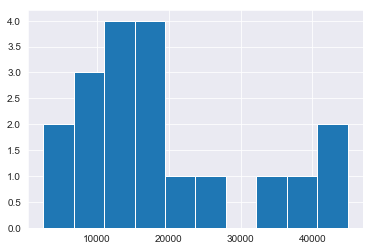

In [98]:
#(ii) Vamos a revisar también que hay departamento de 10 m2 que tienen valores de precio muy alto
plt.hist(df2['price_usd_per_m2'][(df2['surface_total_in_m2']>0) & (df2['surface_total_in_m2']<=10)]);

In [99]:
# Revisamos aquellos que están por arriba de los 30.000 dólares
df2[(df2['surface_total_in_m2']>0) & (df2['surface_total_in_m2']<=10) & (df2['price_usd_per_m2']>=30000)]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
21531,21531,sell,apartment,Recoleta,|Argentina|Capital Federal|Recoleta|,Argentina,Capital Federal,3429595.0,"-34.5932670646,-58.4127334423",-34.593267,-58.412733,330000.0,USD,5822685.0,330000.0,10.0,10.0,33000.0,2129.032258,NaN,NaN,12000.0,http://www.properati.com.ar/17fo6_venta_depart...,CODIGO: 1819-CON555 ubicado en: Billinghurst 1...,Billinghurst y Mansilla. Piso 165 m2. 4 Dorm. ...,https://thumbs4.properati.com/7/96H98ntlhR_jNv...
34307,34307,sell,house,"Barrio Cerrado ""La Delfina""",|Argentina|Bs.As. G.B.A. Zona Norte|Pilar|Barr...,Argentina,Bs.As. G.B.A. Zona Norte,NaN,"-34.4552767,-58.867316",-34.455277,-58.867316,380000.0,USD,6704910.0,380000.0,10.0,270.0,38000.0,1407.407407,NaN,5.0,NaN,http://www.properati.com.ar/18bor_venta_casa_b...,"Preciosa casa en La delfina, consta de un dorm...",Casa venta,https://thumbs4.properati.com/2/vwzvqa5YMgOdNJ...
107057,107057,sell,apartment,Palermo,|Argentina|Capital Federal|Palermo|,Argentina,Capital Federal,3430234.0,"-34.5832756,-58.426027",-34.583276,-58.426027,449000.0,USD,7922380.5,449000.0,10.0,10.0,44900.0,4581.632653,NaN,NaN,NaN,http://www.properati.com.ar/1bxbi_venta_depart...,CODIGO: 1237-69 ubicado en: Paraguay 4700 - P...,"Departamento en Venta en Palermo, Capital Federal",https://thumbs4.properati.com/9/SW14tH2nD5p8RX...
107059,107059,sell,apartment,Palermo,|Argentina|Capital Federal|Palermo|,Argentina,Capital Federal,3430234.0,"-34.5832756,-58.426027",-34.583276,-58.426027,436400.0,USD,7700059.8,436400.0,10.0,10.0,43640.0,4453.061224,NaN,NaN,NaN,http://www.properati.com.ar/1bxbk_venta_depart...,CODIGO: 1237-70 ubicado en: Paraguay 4700 - P...,"Departamento en Venta en Palermo, Capital Federal",https://thumbs4.properati.com/8/cRrlh3-FNOzGFY...


Por lo que se observa son todas casas que tienen construcciones cubiertas de mayor metraje que las totales, con lo que no habría que hacer ningún cambio ni reemplazo

In [100]:
#(iii) Vamos a revisar también dptos que tienen 20m2 y tienen un costo de más de 800.000
df2[(df2['surface_total_in_m2']>0) & (df2['surface_total_in_m2']<=20) & (df2['price_aprox_usd']>800000)]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
26761,26761,sell,apartment,Rosario,|Argentina|Santa Fe|Rosario|,Argentina,Santa Fe,3838574.0,"-32.9572895,-60.6453584",-32.95729,-60.645358,850000.0,USD,14997825.0,850000.0,20.0,20.0,42500.0,42500.0,NaN,1.0,NaN,http://www.properati.com.ar/17rge_venta_depart...,*Monoambiente*Ideal estudiantes.*Seguridad per...,Monoambiente en excelente zona,https://thumbs4.properati.com/0/hknpRgl5Y3MKzB...


In [101]:
display(df2.loc[26761,'description'])
display(df2.loc[26761,'title'])
display(df2.loc[26761,'properati_url'])

'*Monoambiente*Ideal estudiantes.*Seguridad permanente, cmaras de control en todos los niveles.* 9 Piso. .Publicado por Mario Rosa Propiedades a traves INMOMAP'

'Monoambiente en excelente zona'

'http://www.properati.com.ar/17rge_venta_departamento_rosario_mario-rosa-propiedades'

Esta entrada corresponde a un monoambiente que no puede valr 850.000 dólares, teniendo 20m2 y sin expensas. Para descartar este valor, llenamos toda la fila de Nans y después lo dropeamos al final del proceso

In [102]:
df2.at[26761,:]=np.nan

In [103]:
#(iv) Hay departamentos que tienen 10m2 totales y un valor extremo de 10.000 cubiertos
df2[(df2['surface_total_in_m2']>0) & (df2['surface_total_in_m2']<=20) & (df2['surface_covered_in_m2']>500)]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
61895,61895.0,sell,house,Moreno,|Argentina|Bs.As. G.B.A. Zona Oeste|Moreno|,Argentina,Bs.As. G.B.A. Zona Oeste,3430550.0,"-34.5857572291,-58.8392803148",-34.585757,-58.83928,NaN,NaN,NaN,NaN,12.0,803.0,NaN,NaN,NaN,NaN,NaN,http://www.properati.com.ar/1a6c3_venta_casa_m...,La propiedad se encuentra dentro Country San D...,Casa Club de Campo San Diego,https://thumbs4.properati.com/5/RLcBV7UVUbja6A...
97175,97175.0,sell,store,Trelew,|Argentina|Chubut|Trelew|,Argentina,Chubut,3833883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.0,10000.0,NaN,NaN,NaN,NaN,NaN,http://www.properati.com.ar/1bjp0_venta_local_...,Parque Industrial Pesado - Trelew (Chubut)Nave...,Nave Industrial - Trelew,https://thumbs4.properati.com/6/-X_ionMG1Xfzf9...


In [104]:
display(df2.loc[61895,'description'])
display(df2.loc[61895,'title'])

'La propiedad se encuentra dentro Country San Diego. Este club de campo elegante y tradicional a sólo 35 minutos de Capital Federal, cuenta con un acceso directo al country con bajada directa desde la autopista. San Diego tiene master plan de 454 hectáreas, la infraestructura está conformada por un completo menú de instalaciones sociales y deportivas. Posee 2 canchas de golf de 9 y 18 hoyos, 5 canchas de fútbol, 1 de rugby y otra de hockey.Un polideportivo con piso de parquet con canchas de básquet, futsal, y vóley;16 canchas de tenis de polvo de ladrillo y 6 de cemento. Además 6 canchas de polo, pista de Cross Hípico, pistas de salto de césped y arena, más de 400 boxes de hipismo y polo, un health club con gimnasio y un moderno spa. Cada deporte cuenta con su club house con vestuarios y confiterías Restaurante de 240 m2, 2 salones de eventos y proshop.'

'Casa Club de Campo San Diego'

In [105]:
display(df2.loc[97175,'description'])
display(df2.loc[97175,'title'])

'Parque Industrial Pesado - Trelew (Chubut)Nave industrial. Además cuenta con oficinas, recepción, baños privados y personal, depósito con planta de tratamiento de efluentes. Todo en excelente estado.Superficie construida 10.000 M2.-Terreno de 53.000 m2.'

'Nave Industrial - Trelew'

Encontramos 2 errores. 

En el caso de la entrada de 61895, corresponde a una casa en un country en la cual parece que se sumaron los metros2 de todas las instalaciones para llegar a los m2. Dado que no tiene un precio y nada de información de precios en la descripción y título, procedemos a ponerles NaN a toda la entrada para después borrarla. 

En el caso de la entrada 97175, se refiere a un parque industrial y está mal lasuperficie total ya que tendría que ser de 53000

In [106]:
df2.at[61895,:]=np.nan

In [107]:
df2.at[97175,'surface_total_in_m2']=53000

#### Evaluamos ahora la superficie cubierta de aquellos que tienen más de 0 y menos de 20 m2

,surface_covered_in_m2
20.0,1317
1.0,367
19.0,40
18.0,38
10.0,23
17.0,20
12.0,17
15.0,16
16.0,16
5.0,15


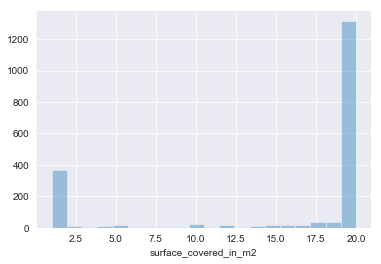

In [108]:
display(pd.DataFrame(df2['surface_covered_in_m2'][(df2['surface_covered_in_m2']>0) & (df2['surface_covered_in_m2']<=20)].value_counts()))
sns.distplot(df2['surface_covered_in_m2'][(df2['surface_covered_in_m2']>0) & (df2['surface_covered_in_m2']<=20)],kde=False);

Revisamos qué sucede con aquellos departamentos que tienen una superficie cubierta de menos de 10m2 (en especial para verificar la relación de los valores de 1m2)

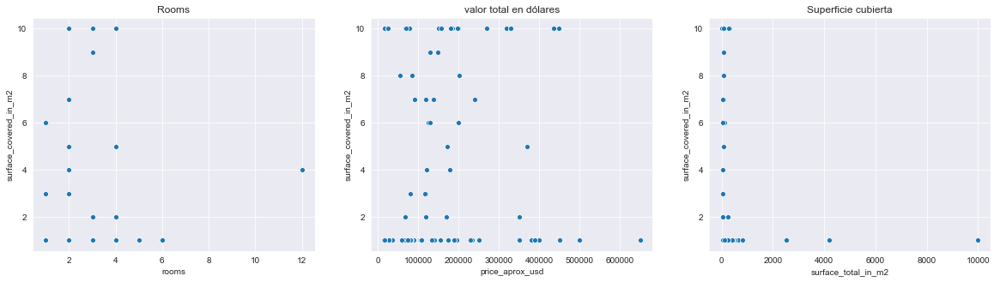

In [109]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_covered_in_m2']>0) & (df2['surface_covered_in_m2']<=10)]['rooms'],
                y=df2[(df2['surface_covered_in_m2']>0) & (df2['surface_covered_in_m2']<=10)]['surface_covered_in_m2'])
plt.title('Rooms')

plt.subplot(1, 3, 2)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']>0) & (df2['surface_covered_in_m2']<=10)]['price_aprox_usd'],
                y=df2[(df2['surface_total_in_m2']>0) & (df2['surface_covered_in_m2']<=10)]['surface_covered_in_m2'])
plt.title('valor total en dólares')

plt.subplot(1, 3, 3)
sns.scatterplot(x=df2[(df2['surface_covered_in_m2']>0) & (df2['surface_covered_in_m2']<=10)]['surface_total_in_m2'],
                y=df2[(df2['surface_covered_in_m2']>0) & (df2['surface_covered_in_m2']<=10)]['surface_covered_in_m2'])
plt.title('Superficie cubierta');

In [110]:
# Chequeamos aquellos valores que tienen una superficite total de más de 2000 metros
df2[(df2['surface_covered_in_m2']>0) & (df2['surface_covered_in_m2']<=10) & (df2['surface_total_in_m2']>2000)]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
3301,3301.0,sell,house,Los Pingüinos Country Club,|Argentina|Bs.As. G.B.A. Zona Oeste|Ituzaingó|...,Argentina,Bs.As. G.B.A. Zona Oeste,NaN,"-34.61462021,-58.68421173",-34.614620,-58.684212,NaN,NaN,NaN,NaN,4200.0,1.0,NaN,NaN,NaN,5.0,NaN,http://www.properati.com.ar/15l0t_venta_casa_l...,"Excelente casaquinta, Living comedor, escritor...",U$D 750.000 - Casa en Venta - Av. Udaondo ...,https://thumbs4.properati.com/0/hqSWTAxdTGU2Ge...
3331,3331.0,sell,house,Los Pingüinos Country Club,|Argentina|Bs.As. G.B.A. Zona Oeste|Ituzaingó|...,Argentina,Bs.As. G.B.A. Zona Oeste,NaN,"-34.620327,-58.700737",-34.620327,-58.700737,NaN,NaN,NaN,NaN,2530.0,1.0,NaN,NaN,NaN,5.0,NaN,http://www.properati.com.ar/15l1z_venta_casa_l...,Casaquinta de estilo tradicional con living co...,U$D 315.000 - Casa en Venta - Julian Balbin ...,https://thumbs4.properati.com/0/QiE0RIQxUu5850...
3781,3781.0,sell,house,Villa Carlos Paz,|Argentina|Córdoba|Villa Carlos Paz|,Argentina,Córdoba,3832791.0,"-31.42078209,-64.49921417",-31.420782,-64.499214,NaN,NaN,NaN,NaN,10000.0,1.0,NaN,NaN,NaN,5.0,NaN,http://www.properati.com.ar/15liw_venta_casa_v...,Casona antigua para reciclar 6 dormitorios 5 b...,U$D 1.900.000 - Casa en Venta - Villa Del Lago...,https://thumbs4.properati.com/7/XcJUwy8C2Ue157...


In [111]:
display(df2.loc[3301,'description'])
display(df2.loc[3301,'title'])

'Excelente casaquinta, Living comedor, escritorio, toilette, quincho, suite, dormitorios, baño completo, cocina , lavadero, dependencia de servicio, cochera y garage, vestuario, piscina con filtro, cancha de paddle, calefacción central, garita de vigilancia.Información Adicional: Luminosidad: Muy luminosoCancha deportes'

'U$D 750.000 - Casa en Venta - Av. Udaondo       3300'

In [112]:
display(df2.loc[3331,'description'])
display(df2.loc[3331,'title'])

'Casaquinta de estilo tradicional con living comedor, cocina, dep. de servicio, 3 dormitorios, baño completo. PA: 3 dormitorios c/plac., 2 baños, terraza, pileta grande. Excelente parque. FM2376/7Información Adicional: Luminosidad: Muy luminoso'

'U$D 315.000 - Casa en Venta - Julian Balbin      3600'

In [113]:
display(df2.loc[3781,'description'])
display(df2.loc[3781,'title'])

'Casona antigua para reciclar 6 dormitorios 5 baños Living comedor Cocina grandes Galerías Balcones con muy linda vista al lago Está ubicada en un predio de 10.000 metros Terreno de valor CONSULTAR PRECIO: 054'

'U$D 1.900.000 - Casa en Venta - Villa Del Lago 0     0'

In [114]:
df2[(df2['surface_covered_in_m2']>0) & (df2['surface_covered_in_m2']<=10)].pivot_table(index='surface_covered_in_m2',aggfunc={'surface_total_in_m2':('median','mean','min','max','count')})

surface_total_in_m2                                  
                                    count      max        mean median   min
surface_covered_in_m2                                                      
1.0                                    98  10000.0  324.459184   81.0  19.0
2.0                                     7    260.0  137.428571   82.0  28.0
3.0                                     3     43.0   38.333333   39.0  33.0
4.0                                     2     40.0   39.500000   39.5  39.0
5.0                                    10    110.0   76.000000   75.0  50.0
6.0                                     4    100.0   77.750000   78.0  55.0
7.0                                     4     67.0   54.500000   52.5  46.0
8.0                                     3     73.0   66.666667   71.0  56.0
9.0                                     2     71.0   70.500000   70.5  70.0
10.0                                   21    300.0   54.000000   10.0  10.0

In [115]:
# En ninguno de estos casos la superficie cubierta es mayor que la superficie total
df[(df2['surface_covered_in_m2']>0) & (df2['surface_covered_in_m2']<=20) & (df2['surface_total_in_m2']<df2['surface_covered_in_m2'])]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail


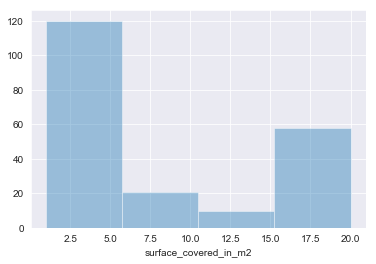

In [116]:
sns.distplot(df['surface_covered_in_m2'][(df2['surface_covered_in_m2']>0) & (df2['surface_covered_in_m2']<=20) & (df2['surface_total_in_m2']>df2['surface_covered_in_m2'])],kde=False)

In [117]:
# Vemos la distribución de estos valores en función del tipo de propiedad
df2[(df2['surface_covered_in_m2']>0) & (df2['surface_covered_in_m2']<=14)].pivot_table(index='surface_covered_in_m2',
                                                                                       columns='property_type',
                                                                                       aggfunc={'property_type':('count'),'surface_total_in_m2':('median','min')})

property_type                         \
                              count                          
property_type                    PH apartment  house store   
surface_covered_in_m2                                        
1.0                            31.0     161.0  146.0  29.0   
2.0                             NaN       6.0    4.0   2.0   
3.0                             NaN       4.0    2.0   1.0   
4.0                             NaN       8.0    2.0   NaN   
5.0                             NaN       7.0    8.0   NaN   
6.0                             1.0       7.0    NaN   NaN   
7.0                             NaN       4.0    NaN   NaN   
8.0                             NaN       3.0    1.0   1.0   
9.0                             NaN       2.0    NaN   2.0   
10.0                            NaN      11.0   11.0   1.0   
11.0                            NaN       5.0    2.0   NaN   
12.0                            2.0       6.0    1.0   8.0   
13.0                            NaN       3.0    NaN   2.0   
14.0                            1.0       5.0    1.0   2.0   

                      surface_total_in_m2                                \
                                   median                           min   
property_type                          PH apartment  house  store    PH   
surface_covered_in_m2                                                     
1.0                                  56.0      59.0  260.0   90.0  50.0   
2.0                                   NaN      48.5  252.5  250.0   NaN   
3.0                                   NaN      39.0    NaN    NaN   NaN   
4.0                                   NaN      39.5    NaN    NaN   NaN   
5.0                                   NaN      80.0   75.0    NaN   NaN   
6.0                                  56.0     100.0    NaN    NaN  56.0   
7.0                                   NaN      52.5    NaN    NaN   NaN   
8.0                                   NaN      63.5   73.0    NaN   NaN   
9.0                                   NaN      70.5    NaN    NaN   NaN   
10.0                                  NaN      10.0   10.0   10.0   NaN   
11.0                                  NaN      11.0   11.0    NaN   NaN   
12.0                                 81.0      67.5  450.0   12.0  81.0   
13.0                                  NaN      13.0    NaN   13.0   NaN   
14.0                                 44.0      14.0   14.0   14.0  44.0   

                                               
                                               
property_type         apartment  house  store  
surface_covered_in_m2                          
1.0                        38.0   42.0   19.0  
2.0                        28.0  245.0  250.0  
3.0                        33.0    NaN    NaN  
4.0                        39.0    NaN    NaN  
5.0                        50.0   75.0    NaN  
6.0                        55.0    NaN    NaN  
7.0                        46.0    NaN    NaN  
8.0                        56.0   73.0    NaN  
9.0                        70.0    NaN    NaN  
10.0                       10.0   10.0   10.0  
11.0                       11.0   11.0    NaN  
12.0                       12.0  450.0   12.0  
13.0                       13.0    NaN   13.0  
14.0                       14.0   14.0   14.0

En la tabla agregada se pueden observar varias cosas: 
- Aquellos que tienen una superficie cubierta de 1 (que son la mayoría de los casos, 161) corresponden principalmente a casas, y el mínimo de la superficie total es de 19m2 (correspondiente a los store). 
- Hasta los de 11 de superficie cubierta, los valores totales de superficie superan los cubiertos, y corresponden principalmente a casas y departamentos. Dado que una superficie cubierta de 11 m2 para una casa/apartamento es un espacio mínimo, asumimos que en estos casos la superficie cubierta es un dato erróneo. A partir de los 12 podrían ser construcciones pequeñas en terrenos más grandes (superficie total del terreno). 
- Si vemos algunos de los ejemplos de valores extremos, tenemos casas que tienen terrenos grandes y en cuya descripción se mencionan construcciones cubiertas pero no hay información de m2 cubiertos
- La estrategia más conservadora para evitar errores, es pasar todos los valores de superficie cubierta que son menores a 10m2 a valores NaN y luego intentar reemplazarlos a partir de la información que se obtenga de las columnas de descripción y título. Luego, si estos datos no se recuperan, en el caso de los departamentos vamos a utilizar los valores de superficie total para completar los cubiertos

In [118]:
len(df2[(df2['surface_covered_in_m2']>0) & (df2['surface_covered_in_m2']<10)])

432

In [119]:
index_covered_menor_diez=df2['surface_covered_in_m2'][(df2['surface_covered_in_m2']>0) & (df2['surface_covered_in_m2']<10)].index.values

In [120]:
df2.at[index_covered_menor_diez,'surface_covered_in_m2']=np.nan

## 2.4 Evaluamos si hay columnas de precios y de superficies que tengan el mismo valor

In [121]:
df2.head(1)

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
0,0.0,sell,PH,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6618237,-58.5088387",-34.661824,-58.508839,62000.0,USD,1093959.0,62000.0,55.0,40.0,1127.272727,1550.0,NaN,NaN,NaN,http://www.properati.com.ar/15bo8_venta_ph_mat...,"2 AMBIENTES TIPO CASA PLANTA BAJA POR PASILLO,...",2 AMB TIPO CASA SIN EXPENSAS EN PB,https://thumbs4.properati.com/8/BluUYiHJLhgIIK...


Comparamos primero la columna de total m2 contra el resto

In [122]:
print ('Price aprox usd == Totalm2 : '+str(np.sum(df2['price_aprox_usd']==df2['surface_total_in_m2'])))
print ('Price  == Totalm2 : '+str(np.sum(df2['price']==df2['surface_total_in_m2'])))
print ('price_aprox_local_currency  == Totalm2 : '+str(np.sum(df2['price_aprox_local_currency']==df2['surface_total_in_m2'])))
print ('price_usd_per_m2  == Totalm2 : '+str(np.sum(df2['price_usd_per_m2']==df2['surface_total_in_m2'])))
print ('price_per_m2  == Totalm2 : '+str(np.sum(df2['price_per_m2']==df2['surface_total_in_m2'])))

Price aprox usd == Totalm2 : 0
Price  == Totalm2 : 0
price_aprox_local_currency  == Totalm2 : 0
price_usd_per_m2  == Totalm2 : 23
price_per_m2  == Totalm2 : 8


Observamos que hay 23 valores en los cuales se repite el precio por metro en usd y los valores totales del terreno. Analizamos estas variables.

In [123]:
df2[df2['price_usd_per_m2']==df2['surface_total_in_m2']][['surface_total_in_m2','price_usd_per_m2','price_aprox_usd']].describe().round(2)

,surface_total_in_m2,price_usd_per_m2,price_aprox_usd
count,23.00,23.00,23.00
mean,430.43,430.43,200434.78
std,125.90,125.90,117801.00
min,300.00,300.00,90000.00
25%,300.00,300.00,90000.00
50%,500.00,500.00,250000.00
75%,500.00,500.00,250000.00
max,700.00,700.00,490000.00


Para evaluar a qué valor corresponden, nos fijamos en inmuebles que tengan valores en dolares que estén cercanos a la media del precio total de esta distribución para ver qué valor reflejan

In [124]:
df2[(df2['price_aprox_usd']>200000) & (df2['price_aprox_usd']>300000)][['surface_total_in_m2','price_usd_per_m2']].describe().round()

,surface_total_in_m2,price_usd_per_m2
count,15363.0,15364.0
mean,476.0,3358.0
std,2422.0,5323.0
min,10.0,2.0
25%,151.0,1275.0
50%,250.0,1967.0
75%,430.0,3311.0
max,154438.0,206333.0


Por lo que se observa, los valores parecerían ser más similares a los de superficie total. Siendo así en estos casos pasamos a NaN los valores de precio en usd, y luego (en la etapa en que analicemos la variable precio) completamos estos datos faltantes con la división entre el precio total en dólares y los m2 totales

In [125]:
index_aux=df2[df2['price_usd_per_m2']==df2['surface_total_in_m2']].index.values

In [126]:
df2.at[index_aux,'price_usd_per_m2']=np.nan

Observamos ahora los 8 que se repiten entre total y precio en metros en moneda local

In [127]:
df2[df2['price_per_m2']==df2['surface_total_in_m2']]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
430,430.0,sell,house,Luján,|Argentina|Buenos Aires Interior|Luján|,Argentina,Buenos Aires Interior,3430982.0,"-34.4960690535,-59.0801049084",-34.496069,-59.080105,150000.0,USD,2646675.0,150000.0,1500.0,100.0,100.0,1500.0,NaN,NaN,5500.0,http://www.properati.com.ar/15eje_venta_casa_l...,"CODIGO: 2016-CV302 ubicado en: Ruta 192 km 7,5...",Casa en venta. 3 dormitorios. B° Lomas de San ...,https://thumbs4.properati.com/9/PHwmltK3ZIP9mm...
29238,29238.0,sell,house,Pilar,|Argentina|Bs.As. G.B.A. Zona Norte|Pilar|,Argentina,Bs.As. G.B.A. Zona Norte,3429979.0,"-34.4399186,-58.8768625",-34.439919,-58.876863,240000.0,USD,4234680.0,240000.0,1000.0,240.0,240.0,1000.0,NaN,6.0,NaN,http://www.properati.com.ar/17yil_venta_casa_p...,"Hermosa Casa en Barrio LOS MIRASOLES , con exc...",Casa venta,https://thumbs4.properati.com/8/_UKUecs7U3jN84...
31844,31844.0,sell,house,Muñiz,|Argentina|Bs.As. G.B.A. Zona Norte|San Miguel...,Argentina,Bs.As. G.B.A. Zona Norte,3430513.0,"-34.5584464246,-58.7139928713",-34.558446,-58.713993,180000.0,USD,3176010.0,180000.0,1000.0,180.0,180.0,1000.0,NaN,NaN,NaN,http://www.properati.com.ar/185a3_venta_casa_m...,Venta de casa quinta 5 ambientes en Muñiz.La c...,CASA EN VENTA,https://thumbs4.properati.com/0/eb_trDpLeb3_a4...
36669,36669.0,sell,house,General Rodríguez,|Argentina|Bs.As. G.B.A. Zona Oeste|General Ro...,Argentina,Bs.As. G.B.A. Zona Oeste,3433780.0,"-34.5965557762,-58.9402341843",-34.596556,-58.940234,110000.0,USD,1940895.0,110000.0,1100.0,100.0,100.0,1100.0,NaN,NaN,NaN,http://www.properati.com.ar/18hfv_venta_casa_g...,CODIGO: 969-005 ubicado en: LOS AROMOS - Publ...,"Casa en Venta en General Rodriguez, General Ro...",https://thumbs4.properati.com/4/7a-p1ZXA79Q4dO...
56076,56076.0,sell,house,Delta,|Argentina|Bs.As. G.B.A. Zona Norte|Tigre|Delta|,Argentina,Bs.As. G.B.A. Zona Norte,NaN,"-34.405724,-58.570284",-34.405724,-58.570284,85000.0,USD,1499782.5,85000.0,1700.0,50.0,50.0,1700.0,NaN,4.0,NaN,http://www.properati.com.ar/19q5b_venta_casa_d...,"Casa 3 DORMITORIOS en Delta, Tigre. Muy linda ...",CASA EN VENTA,https://thumbs4.properati.com/7/RXIeUaIthm2MFF...
58616,58616.0,sell,house,Ibarlucea,|Argentina|Santa Fe|Ibarlucea|,Argentina,Santa Fe,3853938.0,"-32.8560604,-60.7741731",-32.856060,-60.774173,180000.0,USD,3176010.0,180000.0,1000.0,180.0,180.0,1000.0,NaN,6.0,NaN,http://www.properati.com.ar/19w0u_venta_casa_i...,Casa estilo moderno desarrollada en planta baj...,Casa venta,https://thumbs4.properati.com/6/Diq0SA06OLN_0L...
116473,116473.0,sell,house,Open Door,|Argentina|Buenos Aires Interior|Luján|Open Door|,Argentina,Buenos Aires Interior,3430287.0,"-34.4971739,-59.0789221",-34.497174,-59.078922,50000.0,USD,882225.0,50000.0,250.0,200.0,200.0,250.0,NaN,5.0,NaN,http://www.properati.com.ar/1ccd1_venta_casa_o...,Venta sólo contado SIN FINANCIACIÓN. Casa fren...,Casa venta,https://thumbs4.properati.com/0/55k936lt3OhSjR...
116474,116474.0,sell,house,Open Door,|Argentina|Buenos Aires Interior|Luján|Open Door|,Argentina,Buenos Aires Interior,3430287.0,"-34.4971739,-59.0789221",-34.497174,-59.078922,50000.0,USD,882225.0,50000.0,250.0,200.0,200.0,250.0,NaN,5.0,NaN,http://www.properati.com.ar/1ccd2_venta_casa_o...,Venta sólo contado SIN FINANCIACIÓN. Casa fren...,Casa venta,https://thumbs4.properati.com/4/9Wc-Lr9p0t0hN1...


In [128]:
df2[df2['price_per_m2']==df2['surface_total_in_m2']][['price_per_m2','surface_total_in_m2','price_aprox_usd','price_usd_per_m2']].describe().round(2)

,price_per_m2,surface_total_in_m2,price_aprox_usd,price_usd_per_m2
count,8.00,8.00,8.00,8.00
mean,975.00,975.00,130625.00,156.25
std,516.86,516.86,68370.71,65.01
min,250.00,250.00,50000.00,50.00
25%,812.50,812.50,76250.00,100.00
50%,1000.00,1000.00,130000.00,180.00
75%,1200.00,1200.00,180000.00,200.00
max,1700.00,1700.00,240000.00,240.00


Dado que las columnas de precio total en dólares y la de precio en dólares por metro cuadrado estarían correctas, haciendo la división podríamos recuperar el valor de las superficies totales y así corroborar cuál es el dato correcto. 

In [129]:
aux=df2[df2['price_per_m2']==df2['surface_total_in_m2']]['price_aprox_usd']/df2[df2['price_per_m2']==df2['surface_total_in_m2']]['price_usd_per_m2']
aux==df2[df2['price_per_m2']==df2['surface_total_in_m2']]['surface_total_in_m2']

430       True
29238     True
31844     True
36669     True
56076     True
58616     True
116473    True
116474    True
dtype: bool

In [130]:
for i,x,a,b in zip(df2[df2['price_per_m2']==df2['surface_total_in_m2']]['description'],
                   df2[df2['price_per_m2']==df2['surface_total_in_m2']]['title'],
                   df2[df2['price_per_m2']==df2['surface_total_in_m2']]['surface_total_in_m2'],
                   df2[df2['price_per_m2']==df2['surface_total_in_m2']]['surface_covered_in_m2']):
    print (i)
    print (x)
    print ('Total m2 = '+str(a))
    print ('Covered m2 = '+str(b))
    print ()   

CODIGO: 2016-CV302 ubicado en: Ruta 192 km 7,5.  Barrio Lomas de San Francisco. Open Door. 	 -  Publicado por: PROPIEDADES PADRÓ. SERVICIOS INMOBILIARIOS. El precio es de USD 150000 null. Inmueble de una planta, con 3 dormitorios con uno en suite, living comedor con hogar, cocina y baño. Calefacción central. Aberturas de aluminio con doble vidrio hermético y parrilla. Amplio lote. Accesible. Apta Crédito. Tiene posibilidades de ampliación y tambien previsto en el plano a construir  45 m2 semicubiertos de galeria. Ubicada en el lote 78 del Barrio Lomas de San Francisco.   El Barrio cuenta con 100 lotes entre los cuales encontramos 36 casas, 8 obras en construcción y 3 proyectos con planos presentados, ocupando un total de 19 Has.  El barrio está a ubicado en la Ruta 192 km 7,5, a 10 kms dela ciudad de Lujan y a 60 minutos por autopista de la Ciudad Autónoma de Buenos Aires. Se puede acceder al mismo desde Acceso Oeste o desde Autopista Panamericana.  Cuenta con cancha de tenis, piscina,

El resultado nos muestra que los datos pertenecen a la superficie total. Además, la descripción también coincide ya que los valores de la superficie total aparecen en la descripción y/o título. Siendo el caso, los valores de la variable de metros cuadrados en pesos argentinos lo convertimos en nan (igual es probable que esta columna la eliminemos por ser redundante). Además, los datos de superficie cubierta están repetidos con los de el precio en metro cuadrado en dólares, así que ya en este paso los completamos con nan para luego tratar de recuperarlos

In [131]:
index_aux=df2[df2['price_per_m2']==df2['surface_total_in_m2']].index.values

In [132]:
df2.at[index_aux,'price_per_m2']=np.nan

In [133]:
df2.at[index_aux,'surface_covered_in_m2']=np.nan

Comparamos ahora la columna de covered en m2 contra el resto

In [134]:
print ('Price aprox usd == Coveredm2 : '+str(np.sum(df2['price_aprox_usd']==df2['surface_covered_in_m2'])))
print ('Price  == Coveredm2 : '+str(np.sum(df2['price']==df2['surface_covered_in_m2'])))
print ('price_aprox_local_currency  == Coveredm2 : '+str(np.sum(df2['price_aprox_local_currency']==df2['surface_covered_in_m2'])))
print ('price_usd_per_m2  == Coveredm2 : '+str(np.sum(df2['price_usd_per_m2']==df2['surface_covered_in_m2'])))
print ('price_per_m2  == Coveredm2 : '+str(np.sum(df2['price_per_m2']==df2['surface_covered_in_m2'])))

Price aprox usd == Coveredm2 : 0
Price  == Coveredm2 : 0
price_aprox_local_currency  == Coveredm2 : 0
price_usd_per_m2  == Coveredm2 : 0
price_per_m2  == Coveredm2 : 2


Revisamos los dos casos en que la superficie cubierta coincide con los valores en m2 de precios argentinos

In [135]:
df2[df2['price_per_m2']==df2['surface_covered_in_m2']]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
12993,12993.0,sell,house,San Andrés de Giles,|Argentina|Buenos Aires Interior|San Andrés de...,Argentina,Buenos Aires Interior,3429308.0,"-34.4452541,-59.4467803",-34.445254,-59.44678,10000.0,USD,176445.0,10000.0,227.0,100.0,44.052863,100.0,NaN,5.0,NaN,http://www.properati.com.ar/16nul_venta_casa_s...,"DESCRIPCIÓNMuy buena ubicación, a dos cuadras ...",Casa venta,https://thumbs4.properati.com/9/DmJAnmvHnu5w10...
114950,114950.0,sell,house,Valle Hermoso,|Argentina|Córdoba|Valle Hermoso|,Argentina,Córdoba,3833211.0,NaN,NaN,NaN,250000.0,USD,4411125.0,250000.0,NaN,500.0,NaN,500.0,NaN,11.0,NaN,http://www.properati.com.ar/1cajd_venta_casa_v...,"Propiedad Amplia, con aptitud comercial/turist...",Complejo de 4 cabañas +Vivienda con Piscina + ...,https://thumbs4.properati.com/4/JuXmG6Kd4b0Rl-...


In [136]:
df2.loc[12993,'description']

'DESCRIPCIÓNMuy buena ubicación, a dos cuadras del centro. Oportunidad de adquirir un inmueble céntrico, ubicado sobre calle Maipú, entre las calles Quintana y Pellegrini, ofrece una excelente posibilidad de invertir en un propiedad con alto valor rentable debido a la proximidad del centro local.El inmueble se encuentra edificado sobre un lote de terreno de 227 m2, con 9.30 metros de frente y se compone de la siguiente manera: 3 dormitorios contiguos entre sí, cocina, living-comedor y baño, también cuenta con entrada de vehículos.'

In [137]:
df2.loc[114950,'description']

'Propiedad Amplia, con aptitud comercial/turistica, sobre Ruta Nacional 38.El inmueble se asienta sobre un lote esquina de 1350 metros cuadrados de superficie con frente la Ruta Nacional 38.Con 500 metros cuadrados cubiertos aproximadamente.Doble ingreso, uno para la vivienda particular y otro para el sector de Cabañas.En pleno funcionamientoo de todas sus unidades funcionales y en excelente estado de conservacion y equipamiento.Vivienda:La misma cuenta con 2 dormitorios amplios, baño amplio y completo, living comedor, cocina comedor, deposito/lavadero.Jardin de ingreso, patio con piscina de fibra de 3 x 7 metros, servicios instalados y en funcionamiento.Parque con arboles frutales completamente cercado.\xa0Garaje cerrado con porton en el frente, con espacio de guardado de herramientas.Cabañas:4 viviendas distribuidas en unidades de un ambiente con cocina zoonificada, baño completo, instalacion de agua fria y caliente; alterna conunidad de 1 dormitorio, comedor cocina y baño totalmente

Por las descripciones, la superficie cubierta sería el dato correcto; con lo que se pasan los valores en metros en pesos argentinos a valores nan

In [138]:
index_aux=df2[df2['price_per_m2']==df2['surface_covered_in_m2']].index.values

In [139]:
df2.at[index_aux,'price_per_m2']=np.nan

## 2.5 Recuperamos valores de description y title para reemplazar los nans que tenemos en cada variable

In [140]:
import re

Primero chequeamos nuevamente cuántos valores nan tienen estas variables en función de los cambios que hemos realizado

In [141]:
index_search_nan_total=df2[df2['surface_total_in_m2'].isnull()].index.values
len(index_search_nan_total)

39717

#### Comenzamos a buscar nans de los metros TOTALES

In [142]:
# Armamos las distintsa expresiones regulares para buscar información de metros cuadrados o superficies no asociadas
# a la palabra "cubierto"
# ignoro los valores con . o , porque suelen responder a la descripción específica de áreas
regex = re.compile("(\d+)\s*mts\s*2(?!\s*cub)" #65mts2
                   "|(\d+)\s*mt2\s*(?!\s*cub)" #65mt2
                   "|(\d+)\s*metros\s*2(?!\s*cub)" #65 metros2 o 65 metros 2
                   "|(\d+)\s*metros\s*cuad?\w+\b(?!\s*cub)" #65 metroscuadrados o 65 metros cuadrados
                   "|(\d+)\s*m\s*2(?!\s*cub)"#22m2
                   "|(\d+)\s*m\s*2(?!\s*cub)" # esto evita  que si aparece c o cubierto 65m2    (?!\s*c)
                   "|(\d+)\s*metros\s*2\s*sup?\w+\s*tot?\w+\b(?!\s*cub)" #65 metros 2 sup tot cu 
                   "|(\d+)\s*metros\s*sup?\w+\s*tot?\w+\b(?!\s*cub)" # 65 metros sup tot
                   "|(\d+)\s*mts\s*2\s*sup?\w+\s*tot?\w+\b(?!\s*cub)" #65 mts 2 sup tot cu
                   "|(\d+)\s*mts\s*sup?\w+\s*tot?\w+\b(?!\s*cub)" #65 mts 2 sup tot cu
                   "|(\d+)\s*m\s*2\s*sup?\w+\s*tot?\w+\b(?!\s*cub)" #65 m 2 sup tot cu
                   "|(\d+)\s*m\s*sup?\w+\s*tot?\w+\b(?!\s*cub)" #65 m 2 sup tot cu
                   "|mts\s*2\s*(\d+)\b(?!\s*cub)" #mts2 65
                   "|mt\s*2\s*(\d+)\b(?!\s*cub)" #mt2 65
                   "|metros\s*2\s*(\d+)\b(?!\s*cub)" #metros 2 65
                   "|metros\s*cuad?\w+\s*(\d+)\b(?!\s*cub)" # metroscuadrados 65 o metros cuadrados 65
                   "|m\s*2\s*(\d+)\b(?!\s*cub)" #metros 2 65
                   "|sup?\w+\s*tot?\w+\s*(\d+)\s*metros\s*2\b(?!\s*cub)" #superficie total 65 metros 2
                   "|sup?\w+\s*tot?\w+\s*(\d+)\s*metros\b(?!\s*cub)" #superficie total 65 metros
                   "|sup?\w+\s*tot?\w+\s*(\d+)\s*mts\s*2\b(?!\s*cub)" #superficie total 65 mts 2
                   "|sup?\w+\s*tot?\w+\s*(\d+)\s*mts\b(?!\s*cub)" #superficie total 65 mts
                   "|sup?\w+\s*tot?\w+\s*(\d+)\s*m\s*2\b(?!\s*cub)" #superficie total 65 m2
                   "|sup?\w+\s*tot?\w+\s*(\d+)\s*m\b(?!\s*cub)" #superficie total 65 m
                   "|sup?\w+\s*(\d+)\s*metros\s*2\b(?!\s*cub)" #superficie 65 metros 2
                   "|sup?\w+\s*(\d+)\s*metros\b(?!\s*cub)" #superficie 65 metros
                   "|sup?\w+\s*(\d+)\s*mts\s*2\b(?!\s*cub)" #superficie 65 mts 2
                   "|sup?\w+\s*(\d+)\s*m\s*2\b(?!\s*cub)" #superficie 65 m2
                   "|sup?\w+\s*(\d+)\s*m\b(?!\s*cub)" #superficie 65 m
                  ,flags = re.IGNORECASE) #lo compilo

In [143]:
# Dado que en la columna description hay dos valores Nan (como vimos en la primera etapa) + los que agregamos en las etapas anteriores, 
# los reemplazamos por una palabra para que no arroje error el extraer las superficies.
# Reemplazo los nans por un string "NCIV" que significa "NCIV"
df2.at[df2[df2['description'].isnull()].index.values,'description']="NCIV"

In [144]:
# Repetimos lo mismo pero para la columan title (por los nans que agregamos)
df2.at[df2[df2['title'].isnull()].index.values,'title']="NCIV"

In [145]:
# Busco los nans en el df2 que es el dataframe en la que impacte los cambios de outliers
nan_index_values=[]
list_total_des=[]
list_total_title=[]
existence_total_value=[]

for i,x,z in zip(df2['description'][df2['surface_total_in_m2'].isnull()],
               df2['title'][df2['surface_total_in_m2'].isnull()],
               df2[df2['surface_total_in_m2'].isnull()].index.values):
    
    aux_list_total_des=regex.findall(i)
    list_total_des.append(aux_list_total_des)
    
    aux_list_total_title=regex.findall(x)
    list_total_title.append(aux_list_total_title)
    nan_index_values.append(z)
    
    # Este if está pensado como un paso intermedio para ir evaluando en forma rápida cuántos valores capturamos en total
    if (len(aux_list_total_des)==0) and (len(aux_list_total_title)==0):
        existence_total_value.append(0)
    else:
        existence_total_value.append(1)

# Evaluamos cuántos valores encontramos de las columnas description and title
np.sum(existence_total_value)    

8754

In [146]:
# Hacemos un for convertir en números las listas de tuplas que capturamos en el paso anterior. Lo hacemos primero para los valores
# de la descripción. Tomamos como condición que sólo se haya encontrado 1 valor, aunque con esto perdemos información, nos aseguramos
# evitar capturar datos que sea de multiplicación de m2; o de la descripción de m2 x distintos ambients
list_total_des_number=[]
for i in list_total_des:
    if len(i)==1:
        for elements in i:
            #print (elements)
            list_total_des_number.append([int(x) for x in elements if x !=""][0])
    else:
        list_total_des_number.append(0)

In [147]:
# Lo hacemos para los titulos
list_total_title_number=[]
for i in list_total_title:
    if len(i)==1:
        for elements in i:
            #print (elements)
            list_total_title_number.append([int(x) for x in elements if x !=""][0])
    else:
        list_total_title_number.append(0)

In [148]:
# Generamos un DataFrame que tenga los datos; vamos a tener valores 0 en donde no hayamos encontramos valores en la descripción
recover_sup_total=pd.DataFrame({"Total_descip_recov": list_total_des_number,"Total_title_recov": list_total_title_number},index=nan_index_values)

In [149]:
recover_sup_total.head(5)

,Total_descip_recov,Total_title_recov
1,0,0
3,0,0
9,0,0
11,0,0
65,0,0


In [150]:
# Comenzamos a chequear la validez de los datos recuperados de total para hacerles una limpieza si hay valores extremos
recover_sup_total.describe().round(2)

,Total_descip_recov,Total_title_recov
count,39717.00,39717.00
mean,84.78,7.17
std,6866.95,175.08
min,0.00,0.00
25%,0.00,0.00
50%,0.00,0.00
75%,0.00,0.00
max,1300200.00,19200.00


En la primera descripción parecerían surgir por lo menos valores máximos muy extremos. Hacemos una distribución para evaluar estos valores

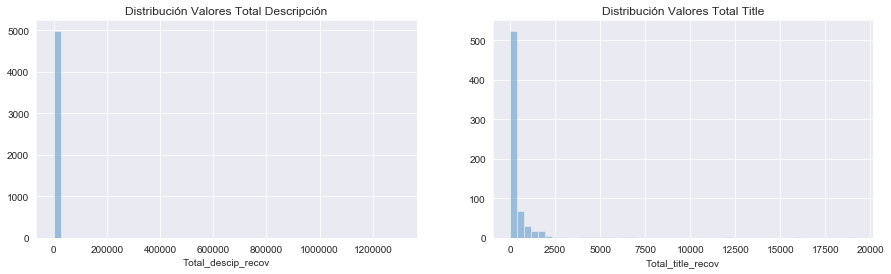

In [151]:
plt.figure(figsize=(15, 4))
plt.subplot(1, 2, 1)
sns.distplot(recover_sup_total['Total_descip_recov'][recover_sup_total['Total_descip_recov']>0],kde=False)
plt.title('Distribución Valores Total Descripción')

plt.subplot(1, 2, 2)
sns.distplot(recover_sup_total['Total_title_recov'][recover_sup_total['Total_title_recov']>0],kde=False)
plt.title('Distribución Valores Total Title');

La gran mayoría de valores parecerían estar "cerca del 0", así que repetimos los gráficos para ver la distribución sin los outliers.
Usamos como criterio ver dos veces la media de total aprox

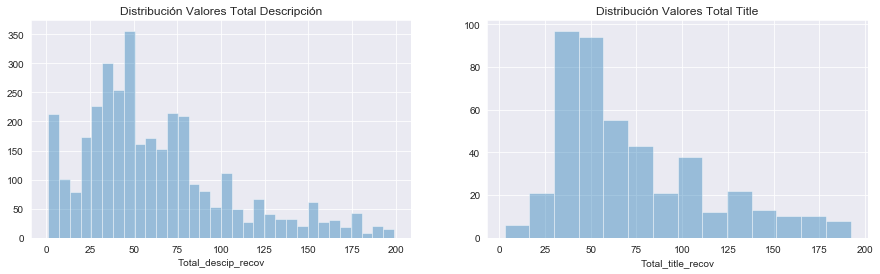

In [152]:
plt.figure(figsize=(15, 4))
plt.subplot(1, 2, 1)
sns.distplot(recover_sup_total['Total_descip_recov'][(recover_sup_total['Total_descip_recov']>0) & (recover_sup_total['Total_descip_recov']<200)],
             kde=False)
plt.title('Distribución Valores Total Descripción')

plt.subplot(1, 2, 2)
sns.distplot(recover_sup_total['Total_title_recov'][(recover_sup_total['Total_title_recov']>0) & (recover_sup_total['Total_title_recov']<200)],
             kde=False)
plt.title('Distribución Valores Total Title');

Las distribuciones parecen mostrar valores de superficie total menores a 14 mts2; dado que estas superficies serían muy pequeñas, las analizamos
dado que podrían ser un error

In [153]:
recover_sup_total[['Total_descip_recov']][(recover_sup_total['Total_descip_recov']>0) & (recover_sup_total['Total_descip_recov']<14)].describe()

,Total_descip_recov
count,313.000000
mean,6.300319
std,3.118272
min,1.000000
25%,5.000000
50%,6.000000
75%,9.000000
max,13.000000


Encontramos 310 valore que están por debajo de <14mts; en estos casos consideramos que podrían ser un error del proceso de extracción, así que
los pasamos a 0 para no tener los en cuenta cuando impactemos los resultados 

In [154]:
aux_index=recover_sup_total[['Total_descip_recov']]\
          [(recover_sup_total['Total_descip_recov']>0) & (recover_sup_total['Total_descip_recov']<14)].index.values

In [155]:
recover_sup_total.at[aux_index,'Total_descip_recov']=0

Además, las distribuciones parecen mostrar valores de superficie total muy altos (>7000); las analizamos dado que podrían ser un error (usamos como criterio el doble de la media de esta variable)

In [156]:
recover_sup_total[['Total_descip_recov']][(recover_sup_total['Total_descip_recov']>200)].describe().round(2)


,Total_descip_recov
count,1489.00
mean,2108.75
std,35416.60
min,201.00
25%,313.00
50%,561.00
75%,978.00
max,1300200.00


Hasta el percintil 75 podrían ser datos razonables. Los cruzamos con los datos del precio en usd en dólares para evaluar correspondencias

In [157]:
indice_auxiliar_tot=recover_sup_total[['Total_descip_recov']][(recover_sup_total['Total_descip_recov']>980)].index.values

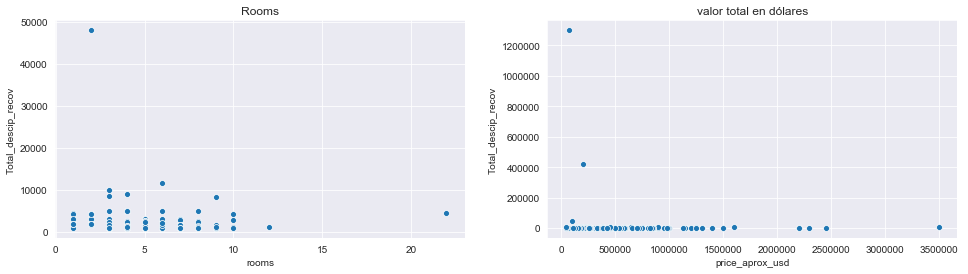

In [158]:
plt.figure(figsize=(25, 4))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2.loc[indice_auxiliar_tot,'rooms'],
                y=recover_sup_total.loc[indice_auxiliar_tot,'Total_descip_recov'])
plt.title('Rooms')

plt.subplot(1, 3, 2)
sns.scatterplot(x=df2.loc[indice_auxiliar_tot,'price_aprox_usd'],
                y=recover_sup_total.loc[indice_auxiliar_tot,'Total_descip_recov'])
plt.title('valor total en dólares');

Parecería que los valores superiores a los 10.000 metros cuadrados parecerían ser outliers x la relación con el precio y la cant. de habitacione

In [159]:
indice_auxiliar_tot=recover_sup_total[['Total_descip_recov']][(recover_sup_total['Total_descip_recov']>10000)].index.values

In [160]:
recover_sup_total.loc[indice_auxiliar_tot]

,Total_descip_recov,Total_title_recov
13157,420158,0
22057,48000,0
114912,1300200,0
114938,20000,0
115241,11578,0
119820,10028,0


Buscamos estos valores extraños en el df2 para evaluar qué hacemos con estos casos. 

In [161]:
for i,x in zip(df2.loc[indice_auxiliar_tot]['description'],df2.loc[indice_auxiliar_tot]['title']):
    print (i)
    print (x)
    print ()

Corredor Responsable: Daniel Acosta - CUCICBA 2406Contacto: Daniela Abelson - MLS ID # 420158 m2 en una sola planta ABL y Aysa: $700.- Alquilado hasta Marzo 2019 La mejor zona de Palermo Soho, a una cuadra de Plaza Armenia.  DANIEL ACOSTA CUCICBA 2406 / CSI 5953"En cumplimiento de la Ley 2340 CUCICBA, Ley 10.973 de la Prov.Bs.As., Ley Nacional 25.028, Ley 22.802 de Lealtad Comercial, Ley 24.240 de Defensa al Consumidor, las normas del Código Civil y Comercial de la Nación y Constitucionales, los agentes NO ejercen el corretaje inmobiliario. Todas las operaciones inmobiliarias son objeto de intermediacion y conclusión por parte de los martilleros y corredores colegiados, cuyos datos se exhiben debajo del nombre de la inmobiliaria."
Impecable local

Corredor Responsable: Martin Manias - CMCLZ 4037Contacto: Ariel Morales - MLS ID # 420541028-58UF-146 / DUO  DUPLEX APTO CREDITO!!! BARRIO CERRADO- LISTO PARA MUDARSE Planta Baja: Living comedor y cocina, espacio lavadero, 1 Baño, amplio vent

Por lo que se observa en las descripciones, en las entradas se refiere a m2 de terrenos que no corresponderían a los totales 

- 13157 (es un tamaño muy grande para el tipo de departamento que se describe)
- 22057 (que refiere a los m2 totales del barrio cerrado)
- 114912 (parecería que el valor correcto es el de cubiertos de 120c que lo capturamos cuando saquemos estos valores)
- 115241 (que refiere a un parque para construir más unidades pero no puede inferirse que se refiera al tamaño total)

Pasamos estos datos a 0

In [162]:
recover_sup_total.at[[13157,22057,114912,115241],'Total_descip_recov']=0

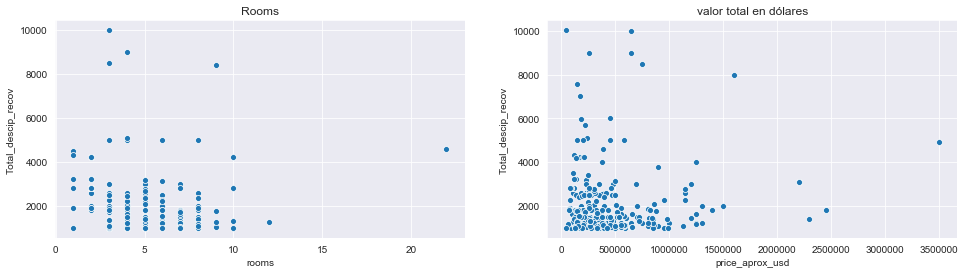

In [163]:
# volvemos a plotear los valores que quedan arriban del 75%
indice_auxiliar_tot=recover_sup_total[['Total_descip_recov']][(recover_sup_total['Total_descip_recov']>980)].index.values
plt.figure(figsize=(25, 4))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2.loc[indice_auxiliar_tot,'rooms'],
                y=recover_sup_total.loc[indice_auxiliar_tot,'Total_descip_recov'])
plt.title('Rooms')

plt.subplot(1, 3, 2)
sns.scatterplot(x=df2.loc[indice_auxiliar_tot,'price_aprox_usd'],
                y=recover_sup_total.loc[indice_auxiliar_tot,'Total_descip_recov'])
plt.title('valor total en dólares');

Parecería que los valores superiores a los 4500 metros cuadrados parecerían ser outliers (son la mitad de una manza) x la relación con el precio y la cant. de habitaciones

In [164]:
indice_auxiliar_tot=recover_sup_total[['Total_descip_recov']][(recover_sup_total['Total_descip_recov']>4500)].index.values
recover_sup_total.loc[indice_auxiliar_tot].describe().head()

,Total_descip_recov,Total_title_recov
count,33.000000,33.000000
mean,7379.030303,288.060606
std,2868.987272,1152.314680
min,4600.000000,0.000000
25%,5000.000000,0.000000


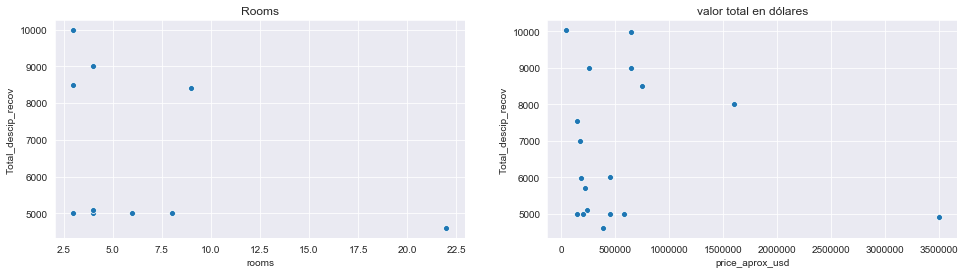

In [165]:
# chequeamos la relación de rooms y price de estos valores
#indice_auxiliar_tot=recover_sup_total[['Total_descip_recov']][(recover_sup_total['Total_descip_recov']>4500)].index.values
plt.figure(figsize=(25, 4))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2.loc[indice_auxiliar_tot,'rooms'],
                y=recover_sup_total.loc[indice_auxiliar_tot,'Total_descip_recov'])
plt.title('Rooms')

plt.subplot(1, 3, 2)
sns.scatterplot(x=df2.loc[indice_auxiliar_tot,'price_aprox_usd'],
                y=recover_sup_total.loc[indice_auxiliar_tot,'Total_descip_recov'])
plt.title('valor total en dólares');

Parecería que hay un valor extremo que tiene 5000 m2 de superficie, pero un valor elevado aprox 3.500.000. Evaluamos este valor

In [166]:
index_aux=recover_sup_total[(recover_sup_total['Total_descip_recov']>4500) & (recover_sup_total['Total_descip_recov']<5000)].index.values

In [167]:
aux_df=df2.loc[index_aux]
aux_df

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
68110,68110.0,sell,house,Córdoba,|Argentina|Córdoba|,Argentina,Córdoba,3860255.0,NaN,NaN,NaN,384000.0,USD,6775488.0,384000.0,NaN,170.0,NaN,2258.823529,NaN,NaN,NaN,http://www.properati.com.ar/1agcm_venta_casa_c...,Te invitamos a conocer:En el pueblo de San Jav...,"***Viví en San Javier, casa-campo gran parque***",https://thumbs4.properati.com/3/2CKcIcm3V-ka0S...
68836,68836.0,sell,store,Florida,|Argentina|Bs.As. G.B.A. Zona Norte|Vicente Ló...,Argentina,Bs.As. G.B.A. Zona Norte,3433908.0,NaN,NaN,NaN,3500000.0,USD,61755750.0,3500000.0,NaN,4906.0,NaN,713.412148,NaN,NaN,NaN,http://www.properati.com.ar/1ahfu_venta_local_...,Vicente López - Florida - CÓDIGO 0301 (4906) E...,Excelente edificio comercial de 4906 m2 en Flo...,https://thumbs4.properati.com/5/LMuZbVXPm6143c...
102054,102054.0,sell,house,Rosario,|Argentina|Santa Fe|Rosario|,Argentina,Santa Fe,3838574.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,189.0,NaN,NaN,NaN,NaN,NaN,http://www.properati.com.ar/1bq51_venta_casa_r...,"Chalet de 3 dormitorios (principal en suite), ...",Casa en Roldan,https://thumbs4.properati.com/9/7VtcQ2qTRP11xC...
115604,115604.0,sell,house,Córdoba,|Argentina|Córdoba|Córdoba|,Argentina,Córdoba,3860259.0,"-31.356778,-64.258036",-31.356778,-64.258036,NaN,NaN,NaN,NaN,NaN,600.0,NaN,NaN,NaN,22.0,NaN,http://www.properati.com.ar/1cbe5_venta_casa_c...,EXCEPCIONAL PROPIEDAD UBICADA EN EL CORAZON DE...,VENDE - JOULE 6300 -VILLA BELGRANO- 4 Dorm. TE...,https://thumbs4.properati.com/1/isXH4O9dWYSwz_...


In [168]:
display(aux_df.loc[68836,'description'])
display(aux_df.loc[68836,'title'])

'Vicente López - Florida - CÓDIGO 0301 (4906) EVEdificio comercial sobre Av. Bme. Mitre, Florida, actualmente esta siendo ocupado como deposito con oficinas, posee un terreno de 1880  metros cuadrados con un frente sobre la Av. Mitre de cerca de 70 metros lineales, posee una sólida estructura de hormigón armado, esta distribuido en plata baja y tres pisos, que hacen un total aproximado de 4906 m2, posee  monta cargas,playa de estacionamiento privada, ordenanza municipal que autoriza uso exclusivo de calle que ahi termina y todos los servicios. ZONA COMERCIAL C1 .-'

'Excelente edificio comercial de 4906 m2 en Florida - Vicente López'

In [169]:
recover_sup_total.loc[68836]

Total_descip_recov    4906
Total_title_recov     4906
Name: 68836, dtype: int64

Los metros cuadrados del caso con un costo de 3.500.000 millones estarían correctamente identificados, y no hay información que permita indicar que el repcio de la propiedad es erróneo

Por último, antes de impactar estos resultados en el dataframe, corroboramos datos repetidos que hayamos capturados en el dataframe "recover_sup_total"

In [170]:
#Para evitar errores, todos los resultados que están repetidos en descrip y title, en title los paso a cero.
index_aux=recover_sup_total[recover_sup_total['Total_descip_recov']==recover_sup_total['Total_title_recov']]['Total_title_recov'].index.values

In [171]:
recover_sup_total.at[index_aux,'Total_title_recov']=0

In [172]:
# Ahora probamos multiplicando entre sí las variables del dataframe para encontrar aquellas columnas en las que hay dos valores en las columnas
# pero son distintos entre sí
aux_df=pd.Series(recover_sup_total['Total_descip_recov']*recover_sup_total['Total_title_recov']!=0)
aux_df.value_counts()

False    39684
True        33
dtype: int64

In [173]:
recover_sup_total[aux_df].index.values

array([  5159,   7100,  14724,  16573,  19707,  20829,  23380,  27172,
        37494,  40109,  41194,  41391,  45600,  45897,  47134,  47218,
        47621,  48706,  52472,  52499,  57393,  69464,  78465,  83634,
        92392,  93169,  96268, 110889, 114833, 115416, 115990, 116333,
       119712], dtype=int64)

In [174]:
# En 33 lugares encontramos que los valores encontramos en el título y en la descripción co coinciden
recover_sup_total[aux_df]

,Total_descip_recov,Total_title_recov
5159,48,238
7100,50,54
14724,900,1800
16573,30,90
19707,15,14
20829,50,5
23380,36,38
27172,23,47
37494,53,23
40109,35,350


Dado que estamos buscando datos para reemplazar los datos de superficie total, de cada una de estas columnas nos quedamos con el valor más grande

In [175]:
for des,tit,indices in zip(recover_sup_total[aux_df]['Total_descip_recov'],
                           recover_sup_total[aux_df]['Total_title_recov'],
                           recover_sup_total[aux_df].index.values):
    if des > tit:
        recover_sup_total.at[indices,'Total_title_recov']=0
    elif des < tit:
        recover_sup_total.at[indices,'Total_descip_recov']=0

In [176]:
recover_sup_total[aux_df]

,Total_descip_recov,Total_title_recov
5159,0,238
7100,0,54
14724,0,1800
16573,0,90
19707,15,0
20829,50,0
23380,0,38
27172,0,47
37494,53,0
40109,0,350


Para terminar, juntamos las dos columnas en una nueva en el dataframe e impactamos los cambios en los valores nan del df2

In [177]:
recover_sup_total['Suma_total']=recover_sup_total['Total_descip_recov']+recover_sup_total['Total_title_recov']
recover_sup_total.head(10)

,Total_descip_recov,Total_title_recov,Suma_total
1,0,0,0
3,0,0,0
9,0,0,0
11,0,0,0
65,0,0,0
68,0,0,0
70,0,0,0
71,0,0,0
72,0,0,0
77,85,0,85


In [178]:
indices_to_replace=recover_sup_total[recover_sup_total['Suma_total']>0].index.values

In [179]:
df2.at[indices_to_replace,'surface_total_in_m2']=recover_sup_total.loc[indices_to_replace,'Suma_total']

#### Comenzamos a buscar nans de los metros CUBIERTOS

In [180]:
# Armamos las distintsa expresiones regulares para buscar información de metros cuadrados o superficies no asociadas
# a la palabra "cubierto"
# ignoro los valores con . o , porque suelen responder a la descripción específica de áreas
regex = re.compile("(\d+)\s*mts\s*2(?=\s*cub)" #65mts2 cub
                   "(\d+)\s*mts\s*2(?=c)" #65mts2c
                   "|(\d+)\s*mt2\s*(?=\s*cub)" #65mt2
                   "|(\d+)\s*mt2\s*(?=c)" #65mt2c
                   "|(\d+)\s*metros\s*2(?=\s*cub)" #65 metros2 o 65 metros 2
                   "|(\d+)\s*metros\s*2(?=c)" #65 metros2c o 65 metros 2c
                   "|(\d+)\s*metros\s*cuad?\w+\b(?=\s*cub)" #65 metroscuadrados o 65 metros cuadrados
                   "|(\d+)\s*m\s*2(?=\s*cub)"#22m2
                   "|(\d+)\s*m\s*2(?=c)" # 65m2c    
                   "|(\d+)\s*metros\s*2\s*sup?\w+\s*tot?\w+\b(?=\s*cub)" #65 metros 2 sup tot cu 
                   "|(\d+)\s*metros\s*sup?\w+\s*tot?\w+\b(?=\s*cub)" # 65 metros sup tot
                   "|(\d+)\s*mts\s*2\s*sup?\w+\s*tot?\w+\b(?=\s*cub)" #65 mts 2 sup tot cu
                   "|(\d+)\s*mts\s*sup?\w+\s*tot?\w+\b(?=\s*cub)" #65 mts 2 sup tot cu
                   "|(\d+)\s*m\s*2\s*sup?\w+\s*tot?\w+\b(?=\s*cub)" #65 m 2 sup tot cu
                   "|(\d+)\s*m\s*sup?\w+\s*tot?\w+\b(?=\s*cub)" #65 m 2 sup tot cu
                   "|mts\s*2\s*cub\s*(\d+)" #mts2 cub 65
                   "|mts\s*2\s*c\s*(\d+)" #mts2 c 65
                   "|mt\s*2\s*cub\s*(\d+)" 
                   "|mt\s*2\s*c\s*(\d+)" 
                   "|metros\s*2\s*c\s*(\d+)" #metros 2 65
                   "|metros\s*cuad?\w+\s*cub\s*(\d+)" # metroscuadrados 65 o metros cuadrados 65
                   "|metros\s*cuad?\w+\s*c\s*(\d+)"
                   "|m\s*2\s*cub\s*(\d+)" 
                   "|m\s*2\s*c\s*(\d+)"
                   "|sup?\w+\s*tot?\w+\s*cub\w*\s*(\d+)\s*metros" #superficie total 65 metros 
                   "|sup?\w+\s*tot?\w+\s*cub\w*\s*(\d+)\s*mts" #superficie total 65 metros
                   "|sup?\w+\s*tot?\w+\s*cub\w*\s*(\d+)\s*mt" #superficie total 65 metros
                   "|sup?\w+\s*tot?\w+\s*cub\w*\s*(\d+)\s*m" #superficie total 65 metros
                   "|sup?\w+\s*tot?\w+\s*(\d+)\s*metros\b(?=\s*cub)" #superficie total 65 metros
                   "|sup?\w+\s*tot?\w+\s*(\d+)\s*mts\s*2\b(?=\s*cub)" #superficie total 65 mts 2
                   "|sup?\w+\s*tot?\w+\s*(\d+)\s*mts\b(?=\s*cub)" #superficie total 65 mts
                   "|sup?\w+\s*tot?\w+\s*(\d+)\s*m\s*2\b(?=\s*cub)" #superficie total 65 m2
                   "|sup?\w+\s*tot?\w+\s*(\d+)\s*m\b(?=\s*cub)" #superficie total 65 m
                   "|sup?\w+\s*(\d+)\s*metros\s*2\b(?=\s*cub)" #superficie 65 metros 2
                   "|sup?\w+\s*(\d+)\s*metros\b(?=\s*cub)" #superficie 65 metros
                   "|sup?\w+\s*(\d+)\s*metros\b(?=\s*c)" #superficie 65 metros
                   "|sup?\w+\s*(\d+)\s*mts\s*2\b(?=\s*cub)" #superficie 65 mts 2
                   "|sup?\w+\s*(\d+)\s*mts\s*2\b(?=\s*c)" #superficie 65 mts 2
                   "|sup?\w+\s*(\d+)\s*m\s*2\b(?=\s*cub)" #superficie 65 m2
                   "|sup?\w+\s*(\d+)\s*m\s*2\b(?=\s*c)" #superficie 65 m2
                   "|sup?\w+\s*(\d+)\s*m\b(?=\s*cub)" #superficie 65 m
                   "|sup?\w+\s*(\d+)\s*m\b(?=\s*c)" #superficie 65 m
                  ,flags = re.IGNORECASE) #lo compilo

In [181]:
# Busco los nans en el df2 que es el dataframe en la que impacte los cambios de outliers
nan_index_values=[]
list_total_des=[]
list_total_title=[]
existence_total_value=[]

for i,x,z in zip(df2['description'][df2['surface_covered_in_m2'].isnull()],
               df2['title'][df2['surface_covered_in_m2'].isnull()],
               df2[df2['surface_covered_in_m2'].isnull()].index.values):
    
    aux_list_total_des=regex.findall(i)
    list_total_des.append(aux_list_total_des)
    
    aux_list_total_title=regex.findall(x)
    list_total_title.append(aux_list_total_title)
    nan_index_values.append(z)
    
    # Este if está pensado como un paso intermedio para ir evaluando en forma rápida cuántos valores capturamos en total
    if (len(aux_list_total_des)==0) and (len(aux_list_total_title)==0):
        existence_total_value.append(0)
    else:
        existence_total_value.append(1)

# Evaluamos cuántos valores encontramos de las columnas description and title
np.sum(existence_total_value)    

465

In [182]:
# Hacemos un for convertir en números las listas de tuplas que capturamos en el paso anterior. Lo hacemos primero para los valores
# de la descripción. Tomamos como condición que sólo se haya encontrado 1 valor, aunque con esto perdemos información, nos aseguramos
# evitar capturar datos que sea de multiplicación de m2; o de la descripción de m2 x distintos ambients
list_total_des_number=[]
for i in list_total_des:
    if len(i)==1:
        for elements in i:
            #print (elements)
            list_total_des_number.append([int(x) for x in elements if x !=""][0])
    else:
        list_total_des_number.append(0)

In [183]:
# Lo hacemos para los titulos
list_total_title_number=[]
for i in list_total_title:
    if len(i)==1:
        for elements in i:
            #print (elements)
            list_total_title_number.append([int(x) for x in elements if x !=""][0])
    else:
        list_total_title_number.append(0)

In [184]:
# Generamos un DataFrame que tenga los datos; vamos a tener valores 0 en donde no hayamos encontramos valores en la descripción
recover_sup_total=pd.DataFrame({"Total_descip_recov": list_total_des_number,"Total_title_recov": list_total_title_number},index=nan_index_values)

In [185]:
# Comenzamos a chequear la validez de los datos recuperados de total para hacerles una limpieza si hay valores extremos
recover_sup_total.describe().round(2)

,Total_descip_recov,Total_title_recov
count,20350.00,20350.00
mean,25.18,0.34
std,2946.64,44.22
min,0.00,0.00
25%,0.00,0.00
50%,0.00,0.00
75%,0.00,0.00
max,420180.00,6300.00


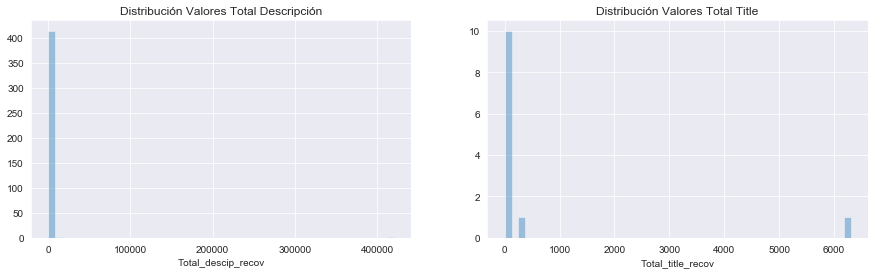

In [186]:
plt.figure(figsize=(15, 4))
plt.subplot(1, 2, 1)
sns.distplot(recover_sup_total['Total_descip_recov'][recover_sup_total['Total_descip_recov']>0],kde=False)
plt.title('Distribución Valores Total Descripción')

plt.subplot(1, 2, 2)
sns.distplot(recover_sup_total['Total_title_recov'][recover_sup_total['Total_title_recov']>0],kde=False)
plt.title('Distribución Valores Total Title');

Hacemos zoom en los valores más pequeños de la distribución

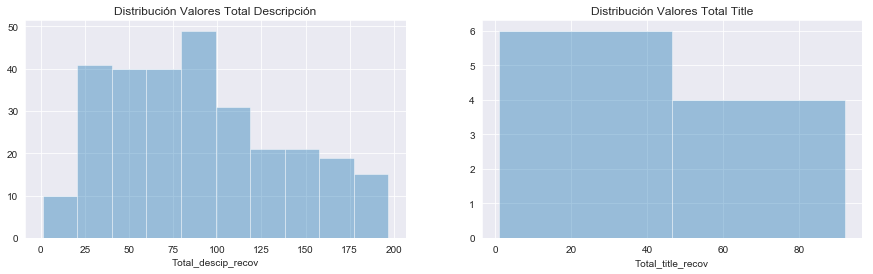

In [187]:
plt.figure(figsize=(15, 4))
plt.subplot(1, 2, 1)
sns.distplot(recover_sup_total['Total_descip_recov'][(recover_sup_total['Total_descip_recov']>0) & (recover_sup_total['Total_descip_recov']<200)],
             kde=False)
plt.title('Distribución Valores Total Descripción')

plt.subplot(1, 2, 2)
sns.distplot(recover_sup_total['Total_title_recov'][(recover_sup_total['Total_title_recov']>0) & (recover_sup_total['Total_title_recov']<200)],
             kde=False)
plt.title('Distribución Valores Total Title');

Observamos algunos valores entre 0 y 20; dado que estos son valores pequeños que aparecen en pocos casos, los pasamos a valores cero porque podrían ser errores de los datos que recuperamos

In [188]:
index_aux=recover_sup_total['Total_descip_recov'][(recover_sup_total['Total_descip_recov']>0) & (recover_sup_total['Total_descip_recov']<21)].index.values

In [189]:
recover_sup_total.at[index_aux,'Total_descip_recov']=0

In [190]:
index_aux=recover_sup_total['Total_title_recov'][(recover_sup_total['Total_title_recov']>0) & (recover_sup_total['Total_title_recov']<21)].index.values

In [191]:
recover_sup_total.at[index_aux,'Total_title_recov']=0

Evaluamos los valores de la descripción que parecerían ser extremos (arriba de los 10.000m2 cubiertos)

In [192]:
recover_sup_total['Total_descip_recov'][(recover_sup_total['Total_descip_recov']>10000)]

41113    420180
Name: Total_descip_recov, dtype: int64

In [193]:
df2.loc[[41113]]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
41113,41113.0,sell,house,San Lorenzo,|Argentina|Santa Fe|San Lorenzo|,Argentina,Santa Fe,3837090.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.0,NaN,http://www.properati.com.ar/18te1_venta_casa_s...,Corredor Responsable: Jesica Tobio - CI Mat. N...,Casa 4 dormitorios Puerto Roldan APTO CREDITO,NaN


In [194]:
display(df2.loc[41113,'description'])
display(df2.loc[41113,'title'])

'Corredor Responsable: Jesica Tobio - CI Mat. N° 405Contacto: María Antonia Ruiz Díaz - MLS ID # 420180 m2 cubiertos (110 x planta) 80 m2 de galerías y cochera Construida con doble pared de ladrillo portante y aislante (30 cms) Calefacción por losa radiante con caldera italiana Baxi, más radiadores en lavadero y baños Piso de hormigón llaneado en PB y de ingeniería de Lapacho en PA Baños de microcemento y Venecitas Aberturas de aluminio DVH en toda la casa. En living aberturas de pinotea también con doble vidrio Todas las puertas antiguas de madera recicladas Enormes placares todos con interiores pileta de 7 x 3,5 mas solarium Planta potabilizadora por ósmosis inversa que alimenta a toda la casa Conexión eléctrica para generador Lote parquizado de 800 m2 orientación sur norte   PB : hall ingreso, Habitación/Playroom, Living comedor, cocina comedor diario, Baño de recepción, baulera, lavadero, depósito/Habitación de servicio con baño, galería, parrillero, lugar para tender, cochera dobl

'Casa 4 dormitorios Puerto Roldan APTO CREDITO'

Por la descripción que figura el dato estaría correcto, así que no sería un outlier

Evaluamos en los datos obtenidos de título, valores superiores a los 1000 mts2

In [195]:
recover_sup_total['Total_title_recov'][(recover_sup_total['Total_title_recov']>1000)]

115990    6300
Name: Total_title_recov, dtype: int64

In [196]:
df2.loc[[115990]]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
115990,115990.0,sell,house,Valle Hermoso,|Argentina|Córdoba|Valle Hermoso|,Argentina,Córdoba,3833211.0,NaN,NaN,NaN,2500000.0,ARS,2473921.05,140209.19,6300.0,NaN,NaN,NaN,NaN,4.0,NaN,http://www.properati.com.ar/1cbsc_venta_casa_v...,"Barrio Bosques del Peñón, calle Diaguitas esq....",BOSQUES DEL PEÑON - VALLE HERMOSO 5 Lotes 6300...,https://thumbs4.properati.com/2/elNfmP_SG4jv8g...


In [197]:
display(df2.loc[115990,'description'])
display(df2.loc[115990,'title'])

'Barrio Bosques del Peñón, calle Diaguitas esq. Huarpes. 5 lotes que en total hacen 6.316 m2, salida a dos calles, cabaña con cocina, estar comedor, entre piso, habitación y baño. Cochera doble cubierta. Luz y agua.'

'BOSQUES DEL PEÑON - VALLE HERMOSO 5 Lotes 6300 mt2 Cabaña 1 dormitorio, estar/comedor y baño. Cochera doble cubierta.'

Este dato no corresponde a un dato cubierto, evidentemente fue tomado por las expresiones regulares dado que cabaña comienza con C. Este dato lo ponemos en cero así no lo reemplazamos en forma errónea. 

In [198]:
recover_sup_total.at[115990,'Total_title_recov']=0

Dado que ya chequeamos la distribución de los valores encontrados y corregimos los errores, pasamos a impactar los mismos en el df2

In [199]:
#Para evitar errores, todos los resultados que están repetidos en descrip y title, en title los paso a cero.
index_aux=recover_sup_total[recover_sup_total['Total_descip_recov']==recover_sup_total['Total_title_recov']]['Total_title_recov'].index.values
recover_sup_total.at[index_aux,'Total_title_recov']=0

In [200]:
# Ahora probamos multiplicando entre sí las variables del dataframe para encontrar aquellas columnas en las que hay dos valores en las columnas
# pero son distintos entre sí
aux_df=pd.Series(recover_sup_total['Total_descip_recov']*recover_sup_total['Total_title_recov']!=0)
aux_df.value_counts()

False    20350
dtype: int64

In [201]:
# Dado que no encontramos valores que sean distintos de cero, procedemos entonces a impactar los resultados en el df2
recover_sup_total['Suma_total']=recover_sup_total['Total_descip_recov']+recover_sup_total['Total_title_recov']
recover_sup_total.head(10)

,Total_descip_recov,Total_title_recov,Suma_total
1,0,0,0
3,0,0,0
5,0,0,0
9,0,0,0
10,0,0,0
11,0,0,0
15,0,0,0
65,0,0,0
66,0,0,0
67,0,0,0


In [202]:
indices_to_replace=recover_sup_total[recover_sup_total['Suma_total']>0].index.values


In [203]:
df2.at[indices_to_replace,'surface_covered_in_m2']=recover_sup_total.loc[indices_to_replace,'Suma_total']

## 2.6 Chequear relación precio y m2, para evaluar cómo fue estimado el USD_m2

- (i) Dado lo encontrado en el punto anterior, chequeamos que SIN corregir los m2 totales, podemos recuperar los USD_m2. Si esto falla en aquellos valores que identificamos que los m2 TOTALES son menores que los cubiertos, esto sería un indicativo de que hay que corregir estos valores

In [204]:
#recupero usando el precio en USD y la surface total
pd.DataFrame((df['price_aprox_usd']/df['surface_total_in_m2'])-df['price_usd_per_m2']).describe().round(6)

,0
count,68617.0
mean,-0.0
std,0.0
min,-0.0
25%,0.0
50%,0.0
75%,0.0
max,0.0


In [205]:
# Creo un df auxiliar para evaluar aún más la coincidencia en la recuperación de la variable
df2_own_usd_per_m2=df.copy()
df2_own_usd_per_m2['own_usd_per_m2']=df['price_aprox_usd']/df['surface_total_in_m2']

In [206]:
df2_own_usd_per_m2[['own_usd_per_m2','price_usd_per_m2']].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 121220 entries, 0 to 121219
Data columns (total 2 columns):
own_usd_per_m2      68866 non-null float64
price_usd_per_m2    68617 non-null float64
dtypes: float64(2)
memory usage: 1.8 MB


Se observa que en la variable recuperada tenemos más valores non-null que en la existente. Esto se debe a que en algunas propiedades, como vimos en la etapa inicial, price_usd_per_m2, tiene más missing data que "price_aprox_usd" "surface_total_in_m2'". Esto es importante porque significa que podemos recuperar algunos missing data de los valores de "price_usd_per_m2" usando nuestro calculo

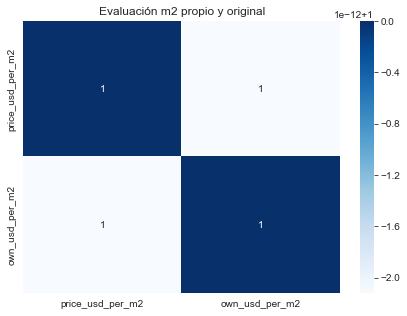

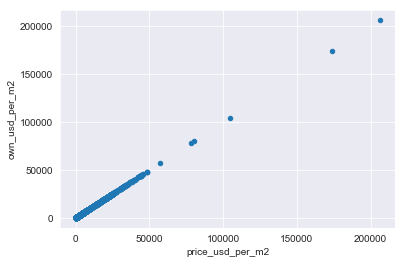

In [207]:
#Probamos la correlacion
plt.figure(figsize=(7.1, 5))
sns.heatmap((df2_own_usd_per_m2[['price_usd_per_m2','own_usd_per_m2']].corr(method='spearman')),annot=True,cmap="Blues")
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Evaluación m2 propio y original')

df2_own_usd_per_m2.plot.scatter('price_usd_per_m2','own_usd_per_m2');


Por lo que se observa hay una correlación perfecta (siendo que la función de corr de pandas ignora los pares con valores nan); lo que nos permite concluir que la columna "price_usd_per_m2" está estimada sobre la columna "surface_total_in_m2". Esto refuerza la idea de que podemos recuperar valores faltantes de "price_usd_per_m2", si tenemos el precio total en dólares y la superficie total (lo cual ocurre ya que en la etapa uno vimos que "surface_total_in_m2" tiene menos missing data que "price_usd_per_m2"

Probamos qué sucede si recuperamos la columna usando el "price_aprox_local_currency", y lo comparamos con "price_per_m2"

In [208]:
df2_own_usd_per_m2['own_curren_per_m2']=df['price_aprox_local_currency']/df['surface_total_in_m2']
df2_own_usd_per_m2[['own_curren_per_m2','price_per_m2']].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 121220 entries, 0 to 121219
Data columns (total 2 columns):
own_curren_per_m2    68866 non-null float64
price_per_m2         87658 non-null float64
dtypes: float64(2)
memory usage: 1.8 MB


Tal como en el caso anterior, se observa que tenemos más missing data en la columna que viene por default, que en aquella que recién estimamos

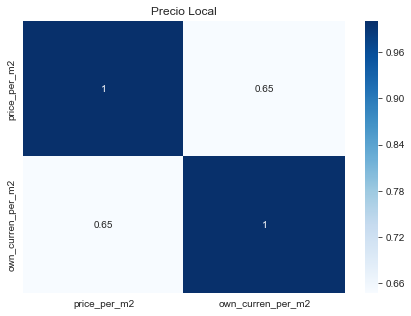

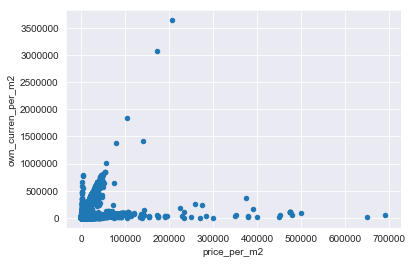

In [209]:
#Probamos la correlacion
plt.figure(figsize=(7.2, 5))
sns.heatmap(df2_own_usd_per_m2[['price_per_m2','own_curren_per_m2']].corr(method='spearman'),annot=True,cmap="Blues")
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Precio Local')
df2_own_usd_per_m2.plot.scatter('price_per_m2','own_curren_per_m2');

Se observa que no hay una relación directa positiva tan extrema como en el caso anterior, lo que refuerza la idea de no utilizar la variable que tiene la transformación de la moneda local, sino que conviene usar la que tiene el precio dolarizado (ver etapa siguiente de análsis de precio)

Vemos que usando la columna que tiene la superficie total, recuperamos el precio x m2 en USD (no sucede lo mismo cuando usamos el precio aproximado en moneda local comparado con el precio por m2 en moneda local).

- (i) Chequeamos que sucede con aquellas entradas que tienen un m2 cubierto mayor que el total (vemos si recuperamos o no el costo en dolares)

In [210]:
df_covered_mayor_total=df2_own_usd_per_m2[(df2_own_usd_per_m2['surface_total_in_m2']-df2_own_usd_per_m2['surface_covered_in_m2'])<0]

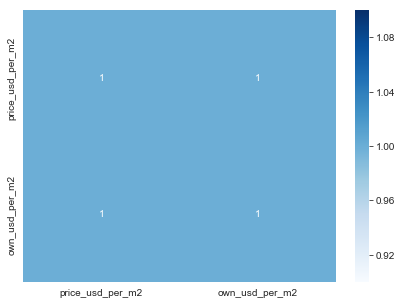

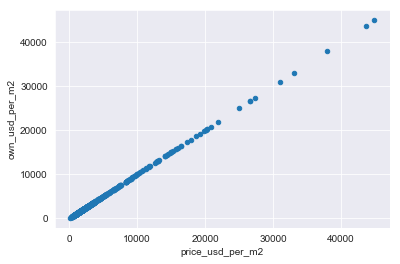

In [211]:
#Probamos la correlacion, para chequear que tb recuperamos el precio
plt.figure(figsize=(7.0, 5))
sns.heatmap(df_covered_mayor_total[['price_usd_per_m2','own_usd_per_m2']].corr(method='spearman'),annot=True,cmap="Blues")
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")

df_covered_mayor_total.plot.scatter('price_usd_per_m2','own_usd_per_m2');

- Los análisis anteriores muestran que el precio del m2 ("price_usd_per_m2") está calculado en función de la división entre las columnas "price_aprox_usd" y "surface_total_in_m2". 
- Ahora bien, dado que hay 1106 entradas en las cuales la superficie cubierta es mayor que la total, hay que tomar una serie de decisiones respecto de estos valores. en función de los análisis anteriores, vamos a aplicar una estrategia conservadora en la que en los departamentos vamos a equiparar el valor total y el valor cubierto; mientras que en el resto de los inmuebles vamos a dejar los cuales tal como están.

## 2.7 Resolución casos en que TOTAL<COVER
En estos casos, sólo ponemos los mismos valores en TOTAL que en COVER cuando se trata de departmentos

In [212]:
df2[df2['surface_total_in_m2']<df2['surface_covered_in_m2']][['surface_total_in_m2','surface_covered_in_m2']].describe()

,surface_total_in_m2,surface_covered_in_m2
count,1515.000000,1515.000000
mean,130.924092,368.818482
std,217.695065,1681.480350
min,8.000000,20.000000
25%,40.000000,88.000000
50%,74.000000,164.000000
75%,161.000000,293.500000
max,4290.000000,38240.000000


In [213]:
df2[df2['surface_total_in_m2']<df2['surface_covered_in_m2']].pivot_table(index='property_type', aggfunc={'property_type':('count')})

,property_type
property_type,
PH,93
apartment,359
house,965
store,98


Hay 359 departamentos en los que el COVERED > TOTAL. Antes de hacer el reemplazo para equiparar ambas variables para esta clase de inmuebles, chequeamos la distribución de las diferencias

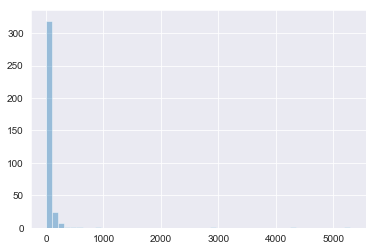

In [214]:
sns.distplot(df2[(df2['surface_total_in_m2']<df2['surface_covered_in_m2']) & (df2['property_type']=='apartment')]['surface_covered_in_m2']-\
             df2[(df2['surface_total_in_m2']<df2['surface_covered_in_m2']) & (df2['property_type']=='apartment')]['surface_total_in_m2'],
             kde=False)

Dado que hay diferencias muy extremas (mayores a los 500m2), evaluamos qué sucede en estos casos

In [215]:
aux_df_dif=pd.DataFrame(df2[(df2['surface_total_in_m2']<df2['surface_covered_in_m2']) & (df2['property_type']=='apartment')]['surface_covered_in_m2']-\
                        df2[(df2['surface_total_in_m2']<df2['surface_covered_in_m2']) & (df2['property_type']=='apartment')]['surface_total_in_m2'],
                        columns=['Dif'])
aux_df_dif[aux_df_dif['Dif']>500]

,Dif
7100,5296.0
12646,550.0
14355,944.0
43808,4300.0
63093,2904.0


Revisamos estos casos

In [216]:
index_aux=aux_df_dif[aux_df_dif['Dif']>500].index.values
for i,z,a,b,c in zip(df2.loc[index_aux,'description'],
                     df2.loc[index_aux,'title'],
                     df2.loc[index_aux,'surface_total_in_m2'],
                     df2.loc[index_aux,'surface_covered_in_m2'],
                     index_aux):
    print (i)
    print (z)        
    print ('Total = ' + str(a))
    print ('Total = ' + str(b))
    print (c)
    print ()                 

Corredor Responsable: Mónica Silvia Martinuzzi - CUCICBA 5172Contacto: Cecilia Berasay - MLS ID # 420621025-31ULTIMO DEPARTAMENTO DEL EDIFICIO !! AMPLIO DEPARTAMENTO DE 2 AMB. de 53,50 m2 CON AMENITIES (solarium, jacuzzi en la terraza, parrilla)      Cocheras opcionales Excelente relación calidad constructiva - precio  ACLARACION : Las fotos corresponden a otro emprendimiento Bahia Blanca 2100 ya terminado de la misma constructora. Los departamentos van a tener las mismas características.  MUY BUENAS TERMINACIONES Y CALIDAD CONSTRUCTIVA   PISOS Piso de porcellanato en ambientes, baños y cocinas; y piso con ceramicos Cerro Negro, San Lorenzo y/o similar en balcones. Porcellanato en los palieres y entrada del edificio.  CIELORRASOS Aplicados de yeso c/buñas y armados en baños y sector cocinas.  REVOQUES Yeso en interiores de los departamentos y palieres. En el resto de las partes comunes del edificio fino a la cal. Terminación en el exterior del edificio con salpicado plastico tipo Quimt

En todos los casos se observa que los valore cubiertos son erróneos. En estos casos dejamos usamos el valor TOTAL para reemplazar el cubierto dadoque son departamentos (en los dos últimos casos el reemplazo se hace específico por el valor que figura en la descripción, y también pisamos el cubierto con el total dado que son departamentos

In [217]:
df2.loc[63093,'surface_total_in_m2']=30
df2.loc[43808,'surface_total_in_m2']=43
df2.loc[63093,'surface_covered_in_m2']=30
df2.loc[43808,'surface_covered_in_m2']=43
df2.loc[7100,'surface_covered_in_m2']=df2.loc[7100,'surface_total_in_m2']
df2.loc[12646,'surface_covered_in_m2']=df2.loc[12646,'surface_total_in_m2']
df2.loc[14355,'surface_covered_in_m2']=df2.loc[14355,'surface_total_in_m2']

Antes de hacer el reemplazo de TOTAL == COVER, evalúamos cómo se relacionan los valores de cover y de total con el precio en dólares en estos casos (TOTAL<COVER)

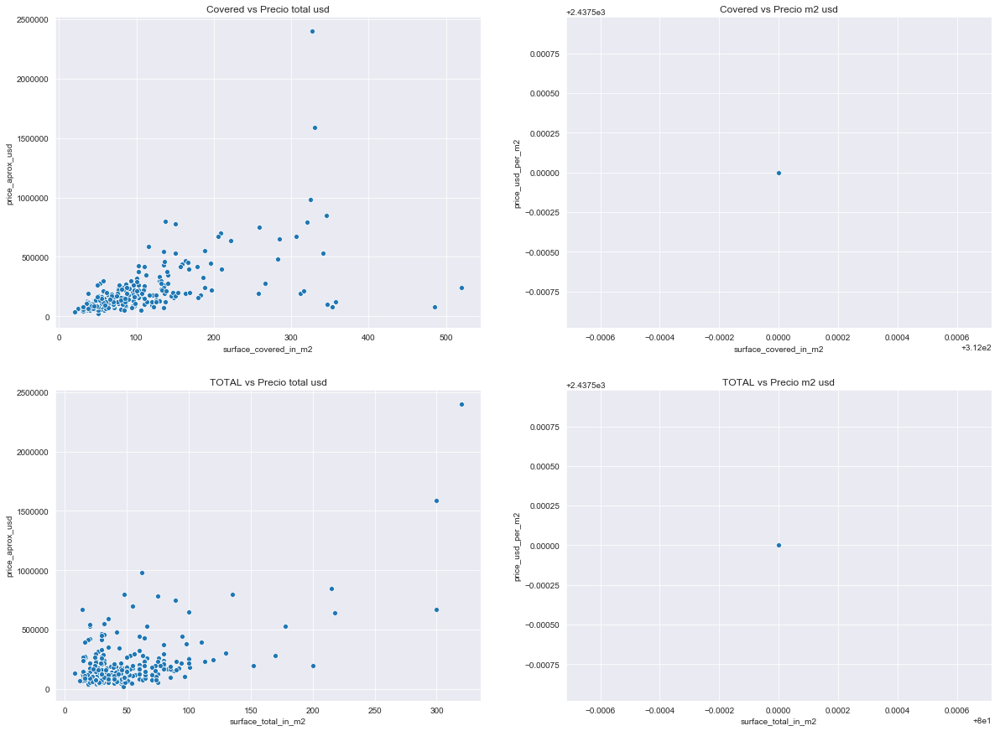

In [218]:
plt.figure(figsize=(20, 15))
plt.subplot(2, 2, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']<df2['surface_covered_in_m2']) & (df2['property_type']=='apartment')]['surface_covered_in_m2'],
                y=df2[(df2['surface_total_in_m2']<df2['surface_covered_in_m2']) & (df2['property_type']=='apartment')]['price_aprox_usd'])
plt.title('Covered vs Precio total usd')

plt.subplot(2, 2, 2)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']<df2['surface_covered_in_m2']) & (df2['property_type']=='apartment')]['surface_covered_in_m2'],
                y=df2[(df2['surface_total_in_m2']<df2['surface_covered_in_m2']) & (df2['property_type']=='apartment')]['price_usd_per_m2'])
plt.title('Covered vs Precio m2 usd')


plt.subplot(2, 2, 3)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']<df2['surface_covered_in_m2']) & (df2['property_type']=='apartment')]['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2']<df2['surface_covered_in_m2']) & (df2['property_type']=='apartment')]['price_aprox_usd'])
plt.title('TOTAL vs Precio total usd')

plt.subplot(2, 2, 4)
sns.scatterplot(x=df2[(df2['surface_total_in_m2']<df2['surface_covered_in_m2']) & (df2['property_type']=='apartment')]['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2']<df2['surface_covered_in_m2']) & (df2['property_type']=='apartment')]['price_usd_per_m2'])
plt.title('TOTAL vs Precio m2 usd');


In [219]:
df2[(df2['surface_total_in_m2']<df2['surface_covered_in_m2']) & (df2['property_type']=='apartment')]['price_usd_per_m2'].value_counts(dropna=False)

NaN        352
 2437.5      2
Name: price_usd_per_m2, dtype: int64

Lo primero que observamos que en casi todos los valores de metros cuadrados por usd tienen valores Nans. las distribuciones parecerían indicar que los cubiertos tienen una mejor relación con el precio. Hacemos unas correlaciones para evaluar esto

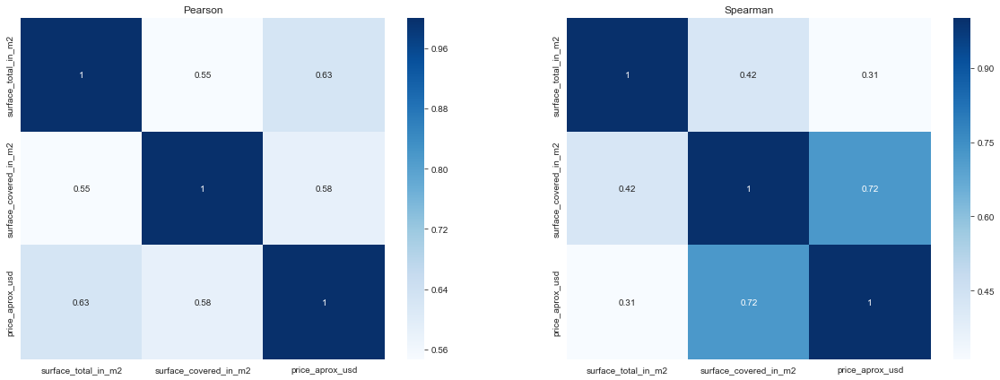

In [220]:
fig = plt.figure(figsize=(20, 7))
plt.subplot(1, 2, 1)
sns.heatmap(df2[(df2['surface_total_in_m2']<df2['surface_covered_in_m2']) & (df2['property_type']=='apartment')][['surface_total_in_m2','surface_covered_in_m2','price_aprox_usd']]\
.corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 2, 2)
sns.heatmap(df2[(df2['surface_total_in_m2']<df2['surface_covered_in_m2']) & (df2['property_type']=='apartment')][['surface_total_in_m2','surface_covered_in_m2','price_aprox_usd']]\
.corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');



Si observamos los valores de correlación, con pearson casi no hay diferencia entre cover y total; sin embargo, cuando usamos spearman que no es susceptible a los valore extremos, la relación cambia muchísimo y la superficie cubierta tiene una mejor relación con el precio. 

En función de esto, decidimos en los departamentos que identificamos que TOTAL<COVERED, utilizar los valores de COVERED para reemplazar en total

In [221]:
aux_df_dif=pd.DataFrame(df2[(df2['surface_total_in_m2']<df2['surface_covered_in_m2']) & (df2['property_type']=='apartment')]['surface_covered_in_m2']-\
                        df2[(df2['surface_total_in_m2']<df2['surface_covered_in_m2']) & (df2['property_type']=='apartment')]['surface_total_in_m2'],
                        columns=['Dif'])

In [222]:
index_aux=df2[(df2['surface_total_in_m2']<df2['surface_covered_in_m2']) & (df2['property_type']=='apartment')].index.values

In [223]:
df2.loc[index_aux,'surface_total_in_m2']=df2.loc[index_aux,'surface_covered_in_m2']

## 2.8 Resolver existencia de valores missing en TOTAL y no en COVER (y visceversa)
- (i) En los casos en los que tenemos NANen TOTAL y tenemos valores en COVER, usamos los de COVER para reemplazar los de nan solo en el caso de los departamentos; en el resto de los casos tratamos de recuperarlo a partir del valor total y el valor de los m2 (esto último lo vamos a hacer dps de analizar la variable precios en la próxima etapa)


In [224]:
df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull())].\
pivot_table(index='property_type', aggfunc={'property_type':('count')})

,property_type
property_type,
PH,1325
apartment,11878
house,9351
store,678


Tenemos 11878 departamentos en los cuales teniendo nans en valores totales, tenemos valores en cover. Si usamos la variable cover podríamos recuperar estos valores. Antes de hacerlo analizamos su relación con la varible precio

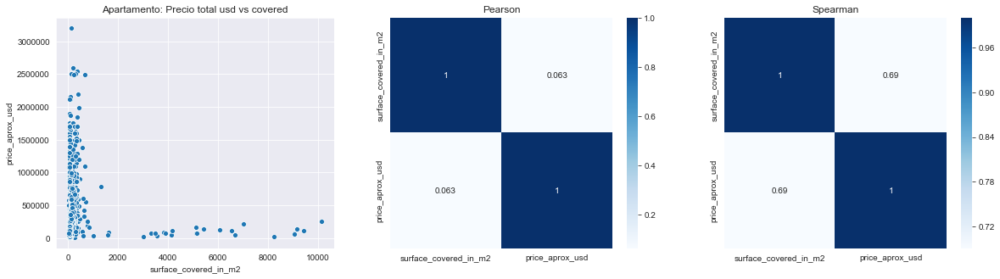

In [225]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) & (df2['property_type']=='apartment')]\
                ['surface_covered_in_m2'],
                y=df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) & (df2['property_type']=='apartment')]\
                ['price_aprox_usd'])
plt.title('Apartamento: Precio total usd vs covered')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) & (df2['property_type']=='apartment')]\
            [['surface_covered_in_m2','price_aprox_usd']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) & (df2['property_type']=='apartment')]\
            [['surface_covered_in_m2','price_aprox_usd']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');



Debido a los valores outliers no se llega a ver qué sucede antes de los 1000 metros de superficie. Exploramos estos valores

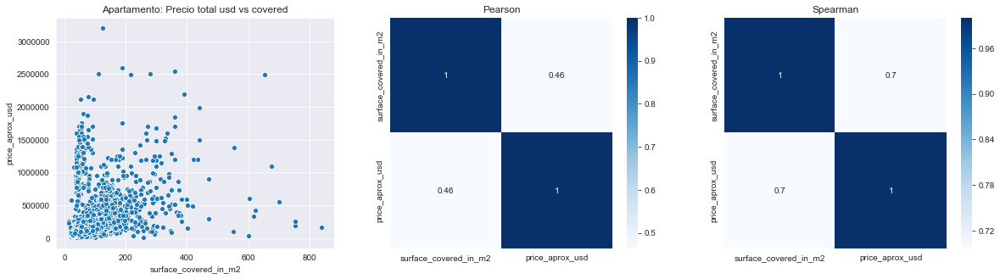

In [226]:
fig=plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) &\
                      (df2['property_type']=='apartment') & (df2['surface_covered_in_m2']<1000)]['surface_covered_in_m2'],
                y=df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) &\
                      (df2['property_type']=='apartment') & (df2['surface_covered_in_m2']<1000)]['price_aprox_usd'])
plt.title('Apartamento: Precio total usd vs covered')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) &\
                (df2['property_type']=='apartment') & (df2['surface_covered_in_m2']<1000)][['surface_covered_in_m2','price_aprox_usd']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) &\
                (df2['property_type']=='apartment') & (df2['surface_covered_in_m2']<1000)][['surface_covered_in_m2','price_aprox_usd']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

In [227]:
fig.savefig("sup_distri.png", bbox_inches='tight', dpi=300)

Analizamos los valores extremos

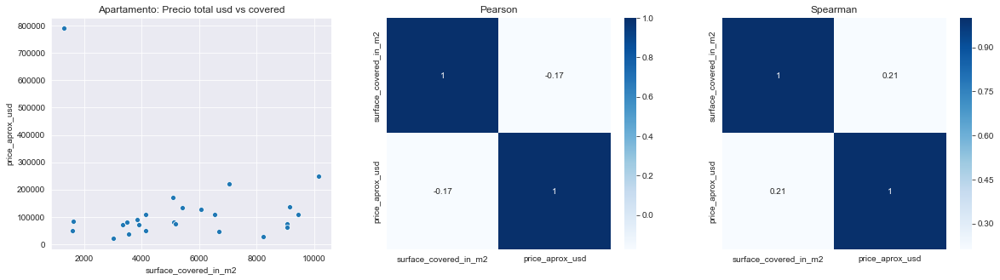

In [228]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) &\
                      (df2['property_type']=='apartment') & (df2['surface_covered_in_m2']>1000)]['surface_covered_in_m2'],
                y=df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) &\
                      (df2['property_type']=='apartment') & (df2['surface_covered_in_m2']>1000)]['price_aprox_usd'])
plt.title('Apartamento: Precio total usd vs covered')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) &\
                (df2['property_type']=='apartment') & (df2['surface_covered_in_m2']>1000)][['surface_covered_in_m2','price_aprox_usd']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) &\
                (df2['property_type']=='apartment') & (df2['surface_covered_in_m2']>1000)][['surface_covered_in_m2','price_aprox_usd']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

Por lo que se ve en ambos gráficos, parecería existir una relación entre la superficie cubierta y el precio en usd. hay un solo valor extremo que procedemos a analizar antes de hacer cualquier reemplazo

In [229]:
df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) &\
                (df2['property_type']=='apartment') & (df2['surface_covered_in_m2']>1000) & (df2['price_aprox_usd']>700000)]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
119355,119355.0,sell,apartment,Punilla,|Argentina|Córdoba|Punilla|,Argentina,Córdoba,3839996.0,"-31.415698,-64.511077",-31.415698,-64.511077,790000.0,USD,13939155.0,790000.0,NaN,1300.0,NaN,607.692308,NaN,18.0,NaN,http://www.properati.com.ar/1cgiw_venta_depart...,Corredor Responsable: Edgardo Tamarit - CPCPI ...,VENTA EXCELENTE COMPLEJO DPTOS - VILLA CARLOS...,https://thumbs4.properati.com/3/CXgWihwNwPCT7J...


In [230]:
display(df2.loc[119355,'description'])
display(df2.loc[119355,'title'])

'Corredor Responsable: Edgardo Tamarit - CPCPI 4228Contacto: Mariana Boras - MLS ID # 420401102-5VENTA DE EXCELENTE COMPLEJO EN VILLA CARLOS PAZ  ¡ ATENCIÓN INVERSORES !  REMAX ofrece una excelente oportunidad   en VILLA CARLOS PAZ  El complejo cuenta con: - 3 departamentos de 1 dormitorio, cocina comedor, baño .  - 2 departamentos de 2 dormitorios, cocina comedor, baño -Terraza con asadores  -Deck con HERMOSA VISTA  a la ciudad  - Garage para 4 autos  - Gran patio con piscina de 10x6  - Una casa de categoría distribuida en dos plantas  PB: living comedor, cocina, baño PA: 2 dormitorios, baño en suite   Las habitaciones de todas la unidades están equipadas con las comodidades necesarias para una estadía muy agradable.   Las instalaciones sanitarias son de primer nivel y están totalmente equipadas.  Escuchamos ofertas!! Se reciben departamentos de interés    Si pensas en una buena Inversión esta es tu oportunidad!!!!  No esperes más!! Llámanos y la Visitamos!!     '

'VENTA EXCELENTE COMPLEJO DPTOS  - VILLA CARLOS PAZ'

La entrada corresponde a un complejo de cabañas. Dado que corresponde a la categoría casa, le cambiamos el tipo de propiedad y en pasos posteriores intentamos estimar su superficie en función del precio del metro cuadrado en ARS. 

In [231]:
df2.loc[119355,'property_type']='house'

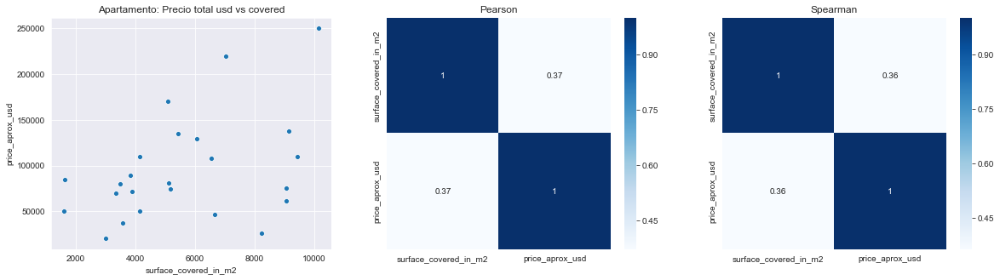

In [232]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) &\
                      (df2['property_type']=='apartment') & (df2['surface_covered_in_m2']>1000)]['surface_covered_in_m2'],
                y=df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) &\
                      (df2['property_type']=='apartment') & (df2['surface_covered_in_m2']>1000)]['price_aprox_usd'])
plt.title('Apartamento: Precio total usd vs covered')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) &\
                (df2['property_type']=='apartment') & (df2['surface_covered_in_m2']>1000)][['surface_covered_in_m2','price_aprox_usd']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) &\
                (df2['property_type']=='apartment') & (df2['surface_covered_in_m2']>1000)][['surface_covered_in_m2','price_aprox_usd']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

Volvemos a plotear los valores outliers y observamos que la relación mejora; teniendo en cuenta esto, para el caso de los apartamentos en los que hay valores NAN en la columna total, los pisamos con los valores covered.

In [233]:
index_aux=df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) & (df2['property_type']=='apartment')].index.values

In [234]:
df2.loc[index_aux,'surface_total_in_m2']=df2.loc[index_aux,'surface_covered_in_m2']

- (ii) En los casos en los que tenemos NANenCOVER y valores en  total, solo usamos los valores de totales para recuperar cover en el caso de departamentos; y vemos qué hacemos en los otros casos

In [235]:
df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull())].\
pivot_table(index='property_type', aggfunc={'property_type':('count'),'price_aprox_usd':('median')})

,price_aprox_usd,property_type
property_type,,
PH,90000.0,268
apartment,95000.0,5463
house,165000.0,2297
store,180000.0,555


Tenemos 5463 departamentos en los que tenemos superficie total pero no cubierta. Antes de hacer el reemplazo, chequeamos la relación con la variable precio

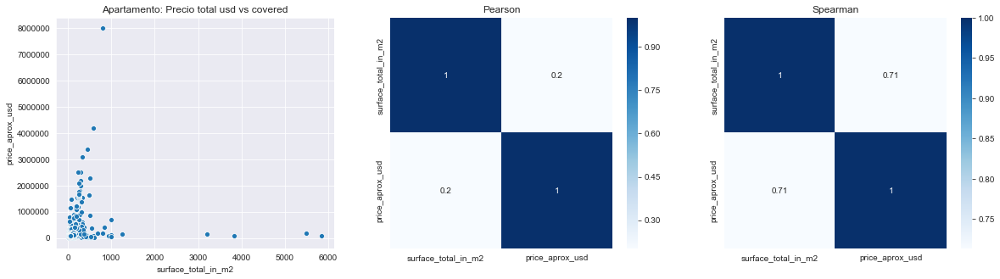

In [236]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='apartment')]\
                ['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='apartment')]\
                ['price_aprox_usd'])
plt.title('Apartamento: Precio total usd vs covered')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='apartment')]\
            [['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='apartment')]\
            [['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

Tal como en el caso anterior, nos encontramos con valores outliers, exploramos ambos extremos de la distribución

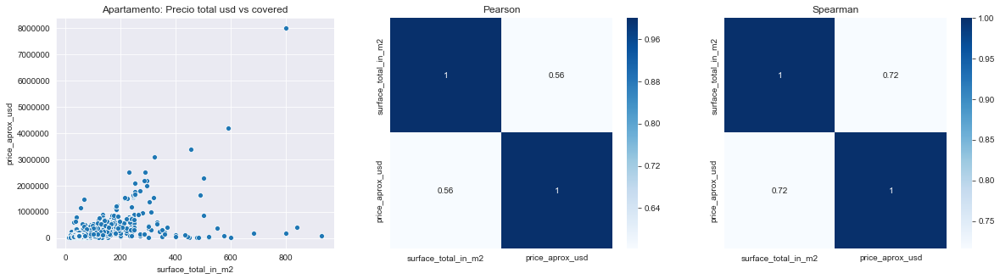

In [237]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']=='apartment') & (df2['surface_total_in_m2']<1000)]['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']=='apartment') & (df2['surface_total_in_m2']<1000)]['price_aprox_usd'])
plt.title('Apartamento: Precio total usd vs covered')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                (df2['property_type']=='apartment') & (df2['surface_total_in_m2']<1000)][['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                (df2['property_type']=='apartment') & (df2['surface_total_in_m2']<1000)][['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

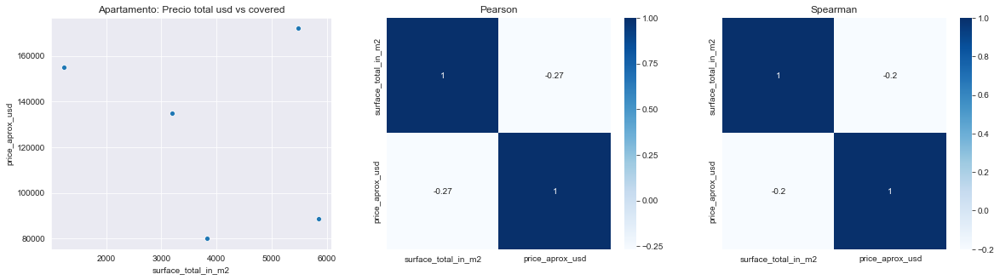

In [238]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']=='apartment') & (df2['surface_total_in_m2']>1000)]['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']=='apartment') & (df2['surface_total_in_m2']>1000)]['price_aprox_usd'])
plt.title('Apartamento: Precio total usd vs covered')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                (df2['property_type']=='apartment') & (df2['surface_total_in_m2']>1000)][['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                (df2['property_type']=='apartment') & (df2['surface_total_in_m2']>1000)][['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

Tenemos pocos valores outliers, que parecerían no afectar nuestro razonamiento de pisar en estos apartamentos la superficie cubierta con la superficie total. 


Analizamos por las dudas un valor extremo del primer gráfico en el que observamos las superficies totales <1000

In [239]:
df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
    (df2['property_type']=='apartment') & (df2['surface_total_in_m2']<1000) & (df2['price_aprox_usd']>7000000)]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
73029,73029.0,sell,apartment,Palermo,|Argentina|Capital Federal|Palermo|,Argentina,Capital Federal,3430234.0,NaN,NaN,NaN,8000000.0,USD,141156000.0,8000000.0,800.0,NaN,10000.0,NaN,NaN,NaN,NaN,http://www.properati.com.ar/1an6j_venta_depart...,VENTA DEPARTAMENTO PISO DE 2 UNIDADES ANEXADAS...,Departamento en Palermo,https://thumbs4.properati.com/4/T9CAnudwEqNIA0...


In [240]:
display(df2.loc[73029,'description'])
display(df2.loc[73029,'title'])

'VENTA DEPARTAMENTO PISO DE 2 UNIDADES ANEXADAS DE CATEGORIA CON 6 COCHERAS EN EMBLEMATICA TORRE LE PARCExcelente ubicación a dos cuadras de los Bosques de PalermoPalier privado. Doble circulación. Entrada de servicio. Excelente luminosidad y estado general. Piso, planta única. Dos departamentos anexados. Hall y placard de recepción. Amplios ambientes. Pasillo de distribución con amplios placares. Master suite con vestidor. Dos dormitorios en suite. Dependencia de servicio doble con baño. Baños y cocina con porcellanato italiano. Gran cocina con antecocina y comedor diario. Escritorio. Seis cocheras. (Fotos y plano de Unidad Similar)AMENITIES: Cancha de Ténis - Cancha de Paddle - Squash - Piscina Climatizada - Sauna - Hidromasaje - Vigilancia - Grupo Electrógeno - Salón para Niños - Estacionamiento de Cortesía.IMPORTANTE: ESTOS PRECIOS ESTAN A SUJETOS A APROBACION DEL PROPIETARIO'

'Departamento en Palermo'

Por la descripción parecería que el precio elevado está vinculado a la zona (palermo), y la calidad del edificio (torre le parc). Dejamos esta entrada sin modificar.

Recuperamos en estos apartamentos, usando los valores totales para reemplazar los cover

In [241]:
aux_index=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='apartment')].index.values

In [242]:
df2.loc[aux_index,'surface_covered_in_m2']=df2.loc[aux_index,'surface_total_in_m2']

(ii) Evaluamos los otros casos en los que nan en cover y valores en total para ver qué hacemos con estos missing data

In [243]:
df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull())].\
pivot_table(index='property_type', aggfunc={'property_type':('count'),'price_aprox_usd':('median')})

,price_aprox_usd,property_type
property_type,,
PH,90000.0,268
house,165000.0,2297
store,180000.0,555


Dado que corregimos ya los valores de departamento, no aparecen aquí. Empezamos a revisar los datos de las otras propiedades

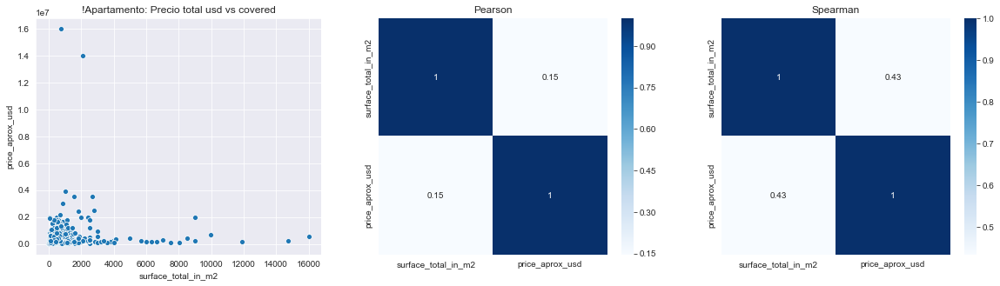

In [244]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']!='apartment')]\
                ['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']!='apartment')]\
                ['price_aprox_usd'])
plt.title('!Apartamento: Precio total usd vs covered')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']!='apartment')]\
            [['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']!='apartment')]\
            [['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

Tal como en el caso anterior, sacamos los valores extremos

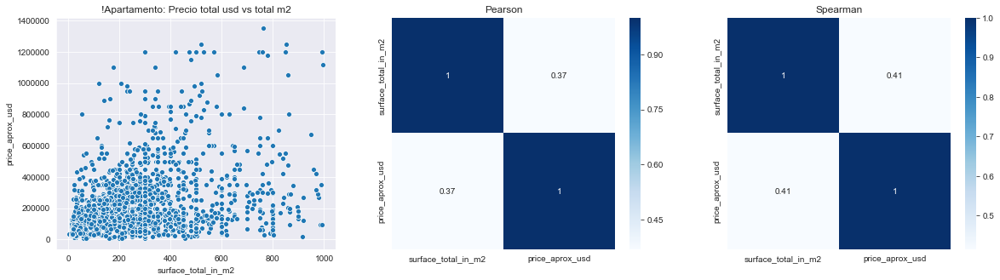

In [245]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']!='apartment') & (df2['surface_total_in_m2']<1000) &\
                      (df2['price_aprox_usd']<1400000)]['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']!='apartment') & (df2['surface_total_in_m2']<1000) &\
                      (df2['price_aprox_usd']<1400000)]['price_aprox_usd'])
plt.title('!Apartamento: Precio total usd vs total m2')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                (df2['property_type']!='apartment') & (df2['surface_total_in_m2']<1000) &\
                (df2['price_aprox_usd']<1400000)][['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                (df2['property_type']!='apartment') & (df2['surface_total_in_m2']<1000) &\
                (df2['price_aprox_usd']<1400000)][['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

Parecería existir una relación bastante directa, con lo que podríamos reemplazar los valores cubiertos x los totales para recuperar esta información. Vemos las mismas relaciones pero con las habitaciones para ver si podemos inferir algo respecto de la cant. de construcciones y el hecho de la superficie cubierta

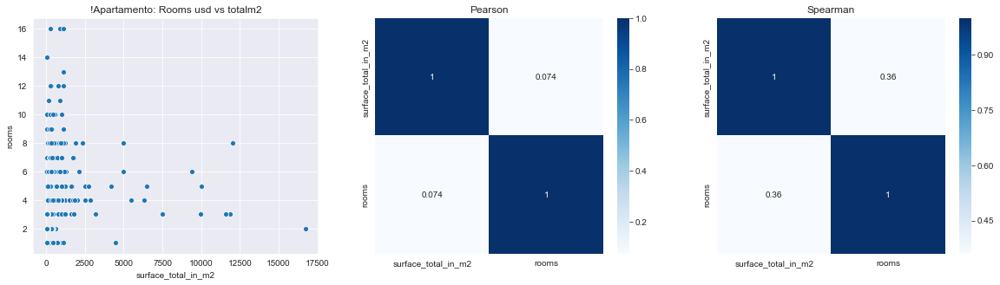

In [246]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']!='apartment')]\
                ['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']!='apartment')]\
                ['rooms'])
plt.title('!Apartamento: Rooms usd vs totalm2')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']!='apartment')]\
            [['surface_total_in_m2','rooms']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']!='apartment')]\
            [['surface_total_in_m2','rooms']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

Sacamos valores extremos de superficie total 

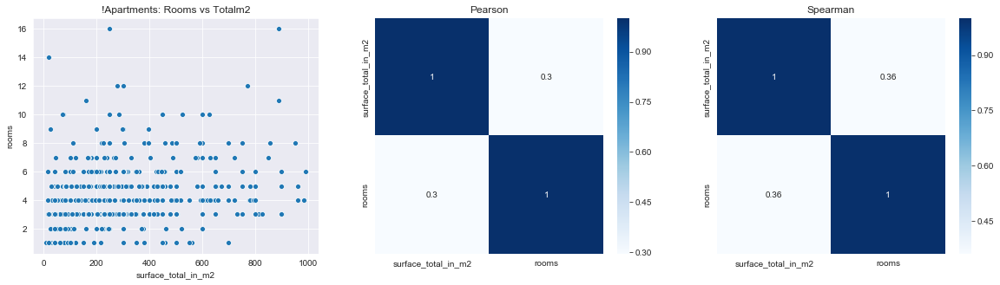

In [247]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']!='apartment') & (df2['surface_total_in_m2']<1000)]['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']!='apartment') & (df2['surface_total_in_m2']<1000)]['rooms'])
plt.title('!Apartments: Rooms vs Totalm2')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                (df2['property_type']!='apartment') & (df2['surface_total_in_m2']<1000)][['surface_total_in_m2','rooms']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                (df2['property_type']!='apartment') & (df2['surface_total_in_m2']<1000)][['surface_total_in_m2','rooms']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

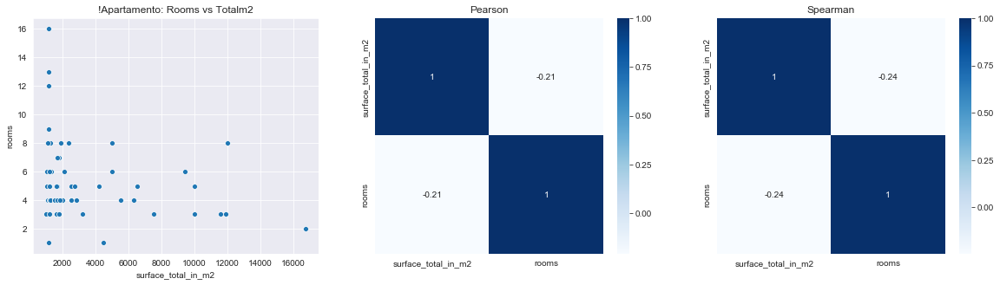

In [248]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']!='apartment') & (df2['surface_total_in_m2']>1000)]['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']!='apartment') & (df2['surface_total_in_m2']>1000)]['rooms'])
plt.title('!Apartamento: Rooms vs Totalm2')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                (df2['property_type']!='apartment') & (df2['surface_total_in_m2']>1000)][['surface_total_in_m2','rooms']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                (df2['property_type']!='apartment') & (df2['surface_total_in_m2']>1000)][['surface_total_in_m2','rooms']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

Las correlaciones no son demasiado altas, nos fijamos en los casos particulares de cada propiedad. 

Primero vemos las casas

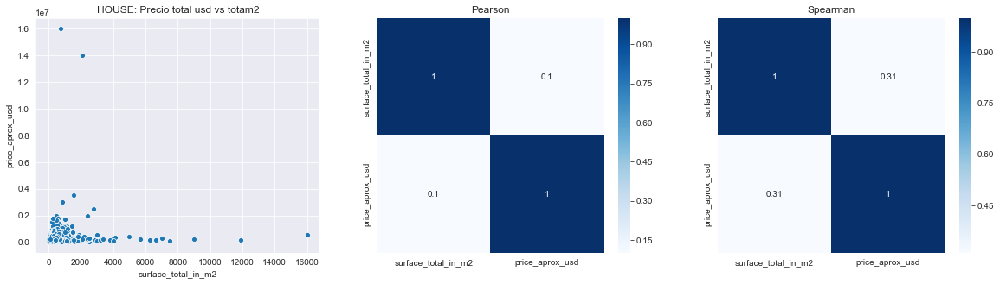

In [249]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='house')]\
                ['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='house')]\
                ['price_aprox_usd'])
plt.title('HOUSE: Precio total usd vs totam2')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='house')]\
            [['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='house')]\
            [['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

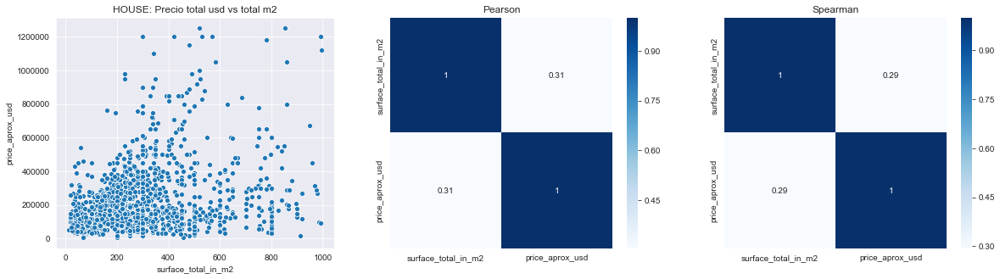

In [250]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']=='house') & (df2['surface_total_in_m2']<1000) &\
                      (df2['price_aprox_usd']<1400000)]['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']=='house') & (df2['surface_total_in_m2']<1000) &\
                      (df2['price_aprox_usd']<1400000)]['price_aprox_usd'])
plt.title('HOUSE: Precio total usd vs total m2')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                (df2['property_type']=='house') & (df2['surface_total_in_m2']<1000) &\
                (df2['price_aprox_usd']<1400000)][['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                (df2['property_type']=='house') & (df2['surface_total_in_m2']<1000) &\
                (df2['price_aprox_usd']<1400000)][['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

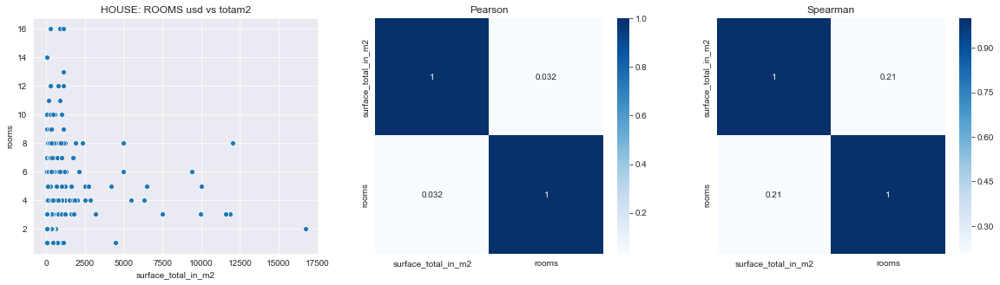

In [251]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='house')]\
                ['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='house')]\
                ['rooms'])
plt.title('HOUSE: ROOMS usd vs totam2')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='house')]\
            [['surface_total_in_m2','rooms']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='house')]\
            [['surface_total_in_m2','rooms']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

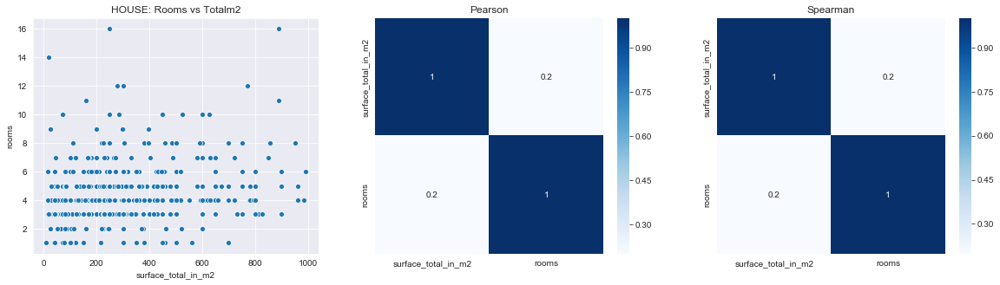

In [252]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']=='house') & (df2['surface_total_in_m2']<1000)]['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']=='house') & (df2['surface_total_in_m2']<1000)]['rooms'])
plt.title('HOUSE: Rooms vs Totalm2')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                (df2['property_type']=='house') & (df2['surface_total_in_m2']<1000)][['surface_total_in_m2','rooms']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                (df2['property_type']=='house') & (df2['surface_total_in_m2']<1000)][['surface_total_in_m2','rooms']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

Ahora vemos los PH

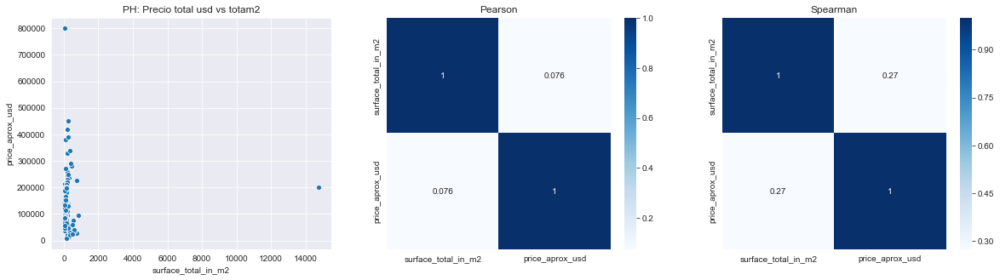

In [253]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='PH')]\
                ['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='PH')]\
                ['price_aprox_usd'])
plt.title('PH: Precio total usd vs totam2')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='PH')]\
            [['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='PH')]\
            [['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

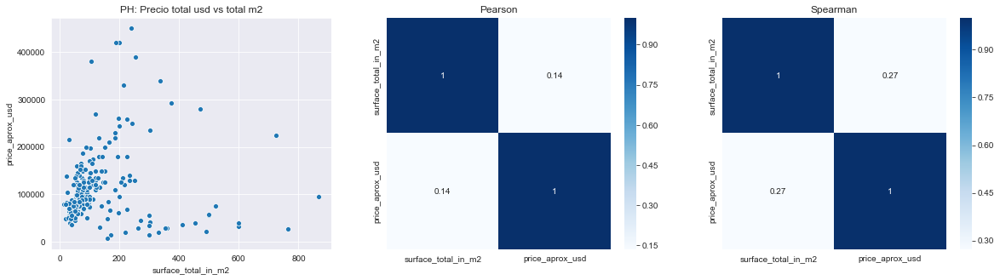

In [254]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']=='PH') & (df2['surface_total_in_m2']<1000) &\
                      (df2['price_aprox_usd']<500000)]['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']=='PH') & (df2['surface_total_in_m2']<1000) &\
                      (df2['price_aprox_usd']<500000)]['price_aprox_usd'])
plt.title('PH: Precio total usd vs total m2')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                (df2['property_type']=='PH') & (df2['surface_total_in_m2']<1000) &\
                (df2['price_aprox_usd']<500000)][['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                (df2['property_type']=='PH') & (df2['surface_total_in_m2']<1000) &\
                (df2['price_aprox_usd']<500000)][['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

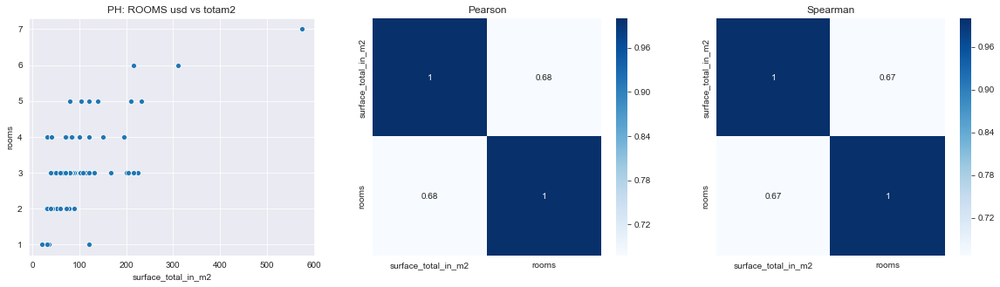

In [255]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='PH')]\
                ['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='PH')]\
                ['rooms'])
plt.title('PH: ROOMS usd vs totam2')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='PH')]\
            [['surface_total_in_m2','rooms']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='PH')]\
            [['surface_total_in_m2','rooms']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

In [256]:
#Revisamos uno de los que parecen ser valores extremos en precio de PH
df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']=='PH') & (df2['surface_total_in_m2']<1000) &\
                      (df2['price_aprox_usd']>500000)]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
21591,21591.0,sell,PH,Villa Luzuriaga,|Argentina|Bs.As. G.B.A. Zona Oeste|La Matanza...,Argentina,Bs.As. G.B.A. Zona Oeste,3427406.0,"-34.6420536,-58.5526921",-34.642054,-58.552692,800000.0,USD,14115600.0,800000.0,55.0,NaN,14545.454545,NaN,NaN,NaN,600.0,http://www.properati.com.ar/17fs6_venta_ph_vil...,CODIGO: 783-A5A9 ubicado en: Pizzurno y Alfred...,PH 3 AMBIENTES PLANTA BAJA,https://thumbs4.properati.com/5/DoaKfBuzYIjLBS...


In [257]:
display(df2.loc[21591,'description'])
display(df2.loc[21591,'title'])

'CODIGO: 783-A5A9 ubicado en: Pizzurno y Alfredo Palacios  -  Publicado por: ANGÉLICA FERNANDEZ PROPIEDADES. El precio es de USD 800000 null. muy buen PH al frente planta baja- dos habitaciones ambas  c/placard amplio -living-cocina-baño y pequeño patio c/lavadero- cañerías de gas y agua todo nuevo. . Publicado a través de Mapaprop'

'PH 3 AMBIENTES PLANTA BAJA'

Por la descripción etaría correcto el valor y la superficie total. 

In [258]:
#Revisamos otro de los que parecen ser valores extremos en precio de PH
df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']=='PH') & (df2['surface_total_in_m2']>1000) &\
                      (df2['price_aprox_usd']<500000)]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
39810,39810.0,sell,PH,Plottier,|Argentina|Neuquén|Plottier|,Argentina,Neuquén,3840885.0,"-38.9594508,-68.0589924",-38.959451,-68.058992,200000.0,USD,3528900.0,200000.0,14742.0,NaN,13.56668,NaN,NaN,NaN,NaN,http://www.properati.com.ar/18pej_venta_ph_plo...,"Venta de Nuevo proyecto urbanístico ""LOTEO LO...",PH EN VENTA,https://thumbs4.properati.com/0/C5k1HFrrHUSXm2...


In [259]:
display(df2.loc[39810,'description'])
display(df2.loc[39810,'title'])

'Venta de Nuevo proyecto urbanístico  "LOTEO LOS  ALAMOS" A pocos metros de la ruta nacional N° 22 el terreno cuenta con 14.742 m2 de superficie, con planos aprobados para realizar un loteo que dispone de extensos 26 lotes de 16 metros de frente con 25 metros de fondo para desarrollos habitacionales  distribuidos en sectores  con una calle interna que conecta todo los lotes hacia una sola entrada, dando tranquilidad y disposición de barrio abierto con aspecto de barrio cerrado. El loteo se encuentra a solo 7km de la ciudad y a pocos metros del acceso a la circunvalación, que con la ruta nueva conectan al parque industrial de la ciudad de Neuquen en pocos minutos. el desarrollo se vende en bloque completo, siendo esta una excelente oportunidad de inversion por consultas y/o visitas Cel:2994624535 -  - YJ SOLUCIONES INMOBILIARIAS'

'PH EN VENTA'

Por la descripción este parecería ser un lote vacío. Para que no genere problemas, le cambiamos la categoría a terreno

In [260]:
df2.loc[39810,'property_type']='TERRENO'

Ahora evaluamos los STORE

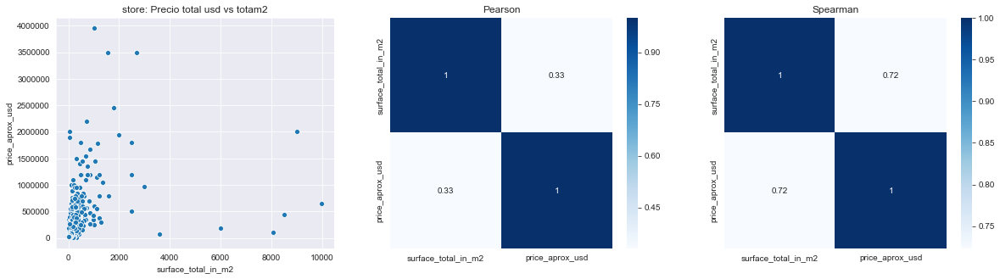

In [261]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='store')]\
                ['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='store')]\
                ['price_aprox_usd'])
plt.title('store: Precio total usd vs totam2')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='store')]\
            [['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='store')]\
            [['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

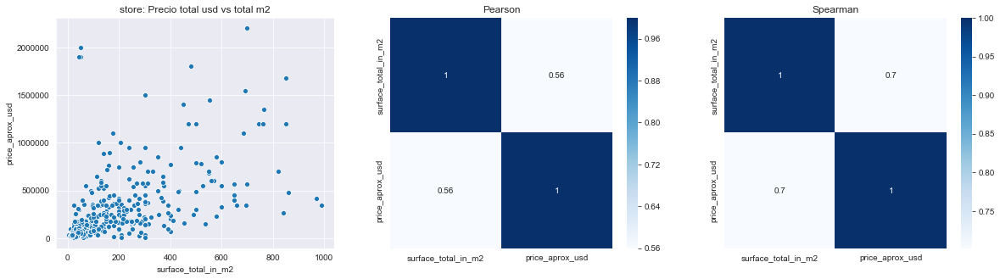

In [262]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']=='store') & (df2['surface_total_in_m2']<1000) &\
                      (df2['price_aprox_usd']<4000000)]['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                      (df2['property_type']=='store') & (df2['surface_total_in_m2']<1000) &\
                      (df2['price_aprox_usd']<4000000)]['price_aprox_usd'])
plt.title('store: Precio total usd vs total m2')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                (df2['property_type']=='store') & (df2['surface_total_in_m2']<1000) &\
                (df2['price_aprox_usd']<4000000)][['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) &\
                (df2['property_type']=='store') & (df2['surface_total_in_m2']<1000) &\
                (df2['price_aprox_usd']<4000000)][['surface_total_in_m2','price_aprox_usd']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

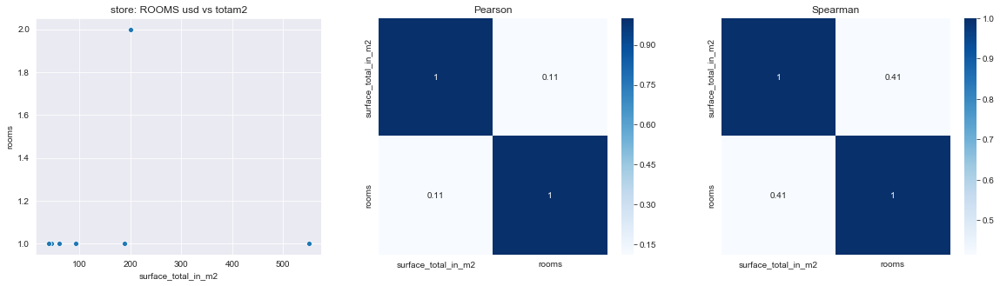

In [263]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='store')]\
                ['surface_total_in_m2'],
                y=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='store')]\
                ['rooms'])
plt.title('store: ROOMS usd vs totam2')

plt.subplot(1, 3, 2)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='store')]\
            [['surface_total_in_m2','rooms']]\
            .corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull()) & (df2['property_type']=='store')]\
            [['surface_total_in_m2','rooms']]\
            .corr(method='spearman'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

Luego de haber revisado tanto en forma conjunta como en forma individual los house, ph y store, parecería estar muy asociado el covered con los precios y con las habitaciones. Ante esto, y la ausencia de otra forma de recuperar estos datos, procedemos a hacer igual que con los apartamentos y igual covered con total

In [264]:
index_aux=df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull())].index.values

In [265]:
df2.loc[index_aux,'surface_covered_in_m2']=df2.loc[index_aux,'surface_total_in_m2']

### Tratamos de recuperar valores totales en los casos en los que tampoco tenemos el valor de metros cuadrados en dólares (y que no son apartamentos donde ya pisamos los valores)

In [266]:
df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) &\
    (df2['price_usd_per_m2'].isnull()) & (df2['price_per_m2'].notnull()) & (df2['price_aprox_local_currency'].notnull()) &\
    (df2['price_aprox_usd'].notnull())].\
pivot_table(index='property_type', aggfunc={'property_type':('count')})

,property_type
property_type,
PH,1289
house,7988
store,590


Evalu si al hacer la multiplicación entre price_per_m2 y la superficie cubierta obtengo el precio de local currency o de usd y así tomo la decisión de pisar los vaores de total m2

In [267]:
aux_df_cover=df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) &\
                 (df2['price_usd_per_m2'].isnull()) & (df2['price_per_m2'].notnull()) & (df2['price_aprox_local_currency'].notnull()) &\
                 (df2['price_aprox_usd'].notnull())]

In [268]:
aux_df_cover['Perm2_covered']=aux_df_cover['price_per_m2']*aux_df_cover['surface_covered_in_m2']

C:\Users\Agustin Ibanez\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


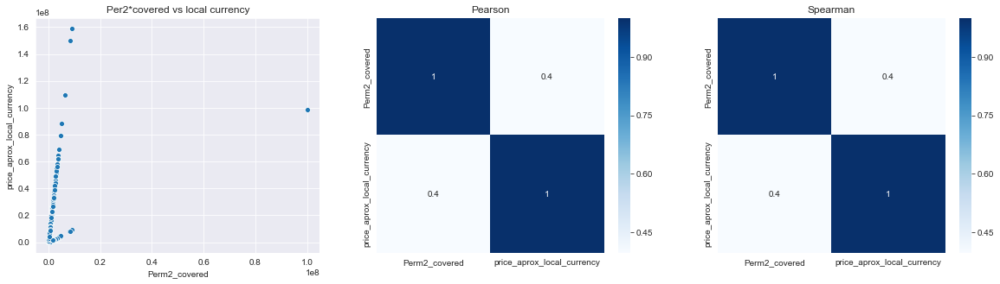

In [269]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=aux_df_cover['Perm2_covered'],
                y=aux_df_cover['price_aprox_local_currency'])
plt.title('Per2*covered vs local currency')

plt.subplot(1, 3, 2)
sns.heatmap(aux_df_cover[['Perm2_covered','price_aprox_local_currency']].corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(aux_df_cover[['Perm2_covered','price_aprox_local_currency']].corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

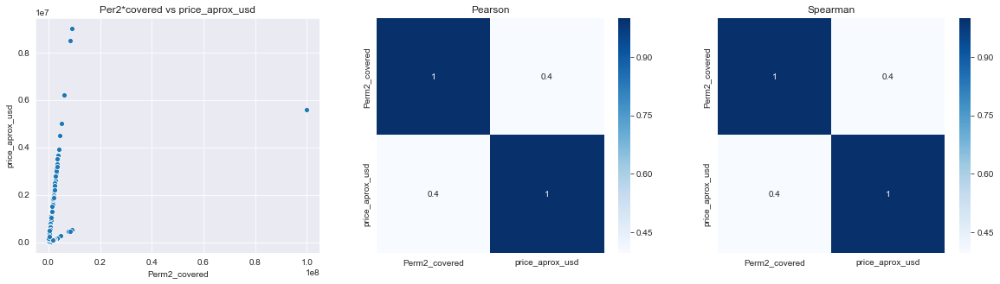

In [270]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=aux_df_cover['Perm2_covered'],
                y=aux_df_cover['price_aprox_usd'])
plt.title('Per2*covered vs price_aprox_usd')

plt.subplot(1, 3, 2)
sns.heatmap(aux_df_cover[['Perm2_covered','price_aprox_usd']].corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(aux_df_cover[['Perm2_covered','price_aprox_usd']].corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

In [271]:
aux_df_cover[aux_df_cover['Perm2_covered']>80000000]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail,Perm2_covered
65701,65701.0,sell,store,Llavallol,|Argentina|Bs.As. G.B.A. Zona Sur|Lomas de Zam...,Argentina,Bs.As. G.B.A. Zona Sur,3431325.0,NaN,NaN,NaN,99999999.0,ARS,98956842.47,5608367.62,NaN,25.0,NaN,3999999.96,NaN,NaN,NaN,http://www.properati.com.ar/1acr0_venta_local_...,Venta Fondo de ComercioPRECIO A TRATAR DIRECTA...,Fondo de Comercio local Granja - Llavallol,NaN,99999999.0


In [272]:
df2.loc[65701,'description']

'Venta Fondo de ComercioPRECIO A TRATAR DIRECTAMENTE CON EL PROPIETARIOGranjaActualmente funcionando, detalle de inventario:HELADERA DE FIAMBRE - MOSTRADORHELADERA CURVA - POLLOSFREEZERHELADERA VERTICALBALANZA 31 KG ELECTRICACORTADORA DE FIAMBREAIRE ACONDICIONADO FRIO/CALOR 3500Alquiler mensual del local en aprox $ 3.400.- mensuales'

Evidentemente este valor no es correcto, así que esta entrada la pasamos toda a nan para despes eliminarla

In [273]:
df2.loc[65701,:]=np.nan

Vemos los datos nuevamente sin ese valor

In [274]:
aux_df_cover=df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) &\
                 (df2['price_usd_per_m2'].isnull()) & (df2['price_per_m2'].notnull()) & (df2['price_aprox_local_currency'].notnull()) &\
                 (df2['price_aprox_usd'].notnull())]
aux_df_cover['Perm2_covered']=aux_df_cover['price_per_m2']*aux_df_cover['surface_covered_in_m2']

C:\Users\Agustin Ibanez\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.


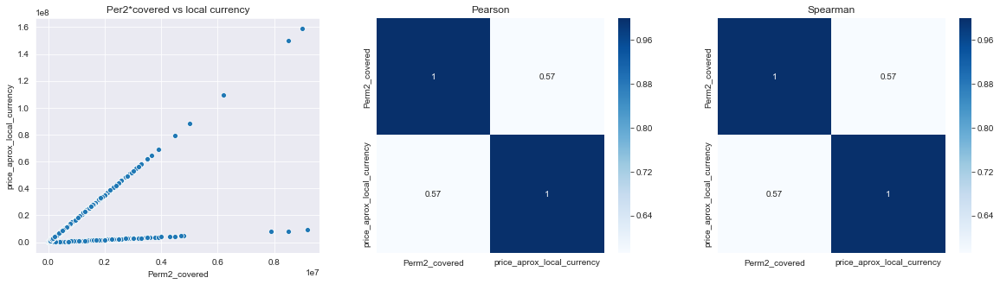

In [275]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=aux_df_cover['Perm2_covered'],
                y=aux_df_cover['price_aprox_local_currency'])
plt.title('Per2*covered vs local currency')

plt.subplot(1, 3, 2)
sns.heatmap(aux_df_cover[['Perm2_covered','price_aprox_local_currency']].corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(aux_df_cover[['Perm2_covered','price_aprox_local_currency']].corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

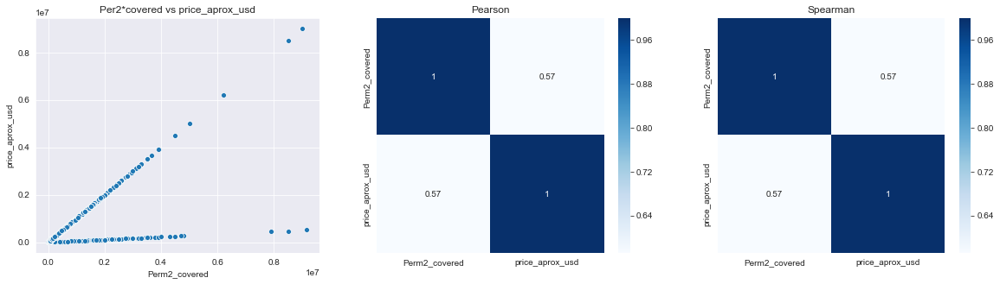

In [276]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
sns.scatterplot(x=aux_df_cover['Perm2_covered'],
                y=aux_df_cover['price_aprox_usd'])
plt.title('Per2*covered vs price_aprox_usd')

plt.subplot(1, 3, 2)
sns.heatmap(aux_df_cover[['Perm2_covered','price_aprox_usd']].corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Pearson')

plt.subplot(1, 3, 3)
sns.heatmap(aux_df_cover[['Perm2_covered','price_aprox_usd']].corr(method='pearson'),annot=True,cmap="Blues");
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center")
plt.title('Spearman');

Dado que parecerían existir dos relaciones directas en las cuales con el valor del precio_per_m2 se recupera el valor del inmueble tanto en moneda local como en dólares, en estos casos también reempalzamos la superficie total con la cubierta

In [277]:
aux_index=aux_df_cover.index.values

In [278]:
df2.loc[aux_index,'surface_total_in_m2']=df2.loc[aux_index,'surface_covered_in_m2']

Por ultimo, en los casos en los que no tengo información del precio x m2 en ninguna moneda, pero sí tengo información del precio total, también pisamos los valores totales con covered (y en pasos posteriores, estimamos los m2 en dólares)

In [279]:
df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) &\
    (df2['price_usd_per_m2'].isnull()) & (df2['price_per_m2'].isnull()) &\
    (df2['price_aprox_local_currency'].notnull()) & (df2['price_aprox_usd'].notnull())].\
pivot_table(index='property_type', aggfunc={'property_type':('count')})

,property_type
property_type,
PH,2
house,28
store,4


In [280]:
aux_index=df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) &\
              (df2['price_usd_per_m2'].isnull()) & (df2['price_per_m2'].isnull()) &\
              (df2['price_aprox_local_currency'].notnull()) & (df2['price_aprox_usd'])].index.values

In [281]:
df2.loc[aux_index,'surface_total_in_m2']=df2.loc[aux_index,'surface_covered_in_m2']

### Resultados finales del reemplazo de valores de superficie

In [282]:
df2[(df2['surface_total_in_m2'].notnull()) & (df2['surface_covered_in_m2'].isnull())].\
pivot_table(index='property_type', aggfunc={'property_type':('count')})

""
property_type


In [283]:
df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull())].\
pivot_table(index='property_type', aggfunc={'property_type':('count')})

,property_type
property_type,
PH,34
house,1336
store,84


In [284]:
df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].isnull())].\
pivot_table(index='property_type', aggfunc={'property_type':('count')})

,property_type
property_type,
PH,584
apartment,5949
house,4383
store,439


Una vez realizado todos estos reemplazos, nos quedan algunsa propiedades con valores NAN en total y con valores existentes en superficie cubierta, estos valores trataremos de recuperarlos posteriormente usando los valores de precio y precio x metro cuadrado en dólares. De no conseguirlo, también procederemos a igualar total con covered. No nos queda ninguna propiedad que tenga valores totales y tenga missing data en cubiertos.

Hay todavía un gran número de propiedades en las que no tentenos ni valores en superficie cubierta ni en superficie total. Estas variablesintentaremos recuperarlas luego de hacer los análisis de precios

##  <ins>3. TERCERA ETAPA</ins>: exploración la consistencia de las variables vinculadas al precio de la propiedad

### 3.1 Evaluar errores entre las diferentes variables de precio, estimar problemas de conversión de moneda, definir cuáles serían las variables de precio que tienen la información más confiable en relación a estos puntos

- Chequeo que cuando el valor de "price" esta en USD coincide con el valor de "price_aprox_usd"

In [285]:
# Me fijo si los valores True igualan a la cant. de variables. Si obtengo "0" es que son todas iguales
np.sum(df[df['currency']=='USD']['price']==df[df['currency']=='USD']['price_aprox_usd'])-df[df['currency']=='USD']['price'].shape[0]

0

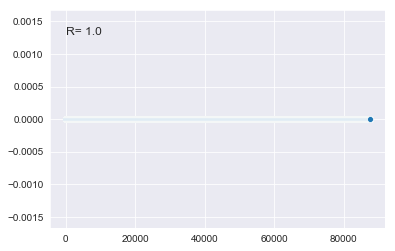

In [286]:
# Con un scaterplot de las diferencias cheque la distancia entre los puntos
legenda_corr='R= '+ str(df[df['currency']=='USD'][['price','price_aprox_usd']].corr(method='pearson').iloc[0,0])
ax=sns.scatterplot(range(0,len(df[df['currency']=='USD']['price']-df[df['currency']=='US']['price_aprox_usd'])),
                df[df['currency']=='USD']['price']-df[df['currency']=='USD']['price_aprox_usd']);
plt.text(0.1, 0.9, legenda_corr, horizontalalignment='center', verticalalignment='center', transform=ax.transAxes,fontsize=12);

- Chequeo que cuando el valor de "price" esta en ARG coincide con el valor de "price_aprox_local_currency"

In [287]:
# Me fijo si los valores True igualan a la cant. de variables
np.sum(df[df['currency']=='ARS']['price']==df[df['currency']=='ARS']['price_aprox_local_currency'])-df[df['currency']=='ARS']['price'].shape[0]

-13219

In [288]:
# Me fijo cuántos de esos valores no son correctos
df['currency'].value_counts()

USD    87587
ARS    13219
PEN        2
UYU        1
Name: currency, dtype: int64

In [289]:
pd.DataFrame(df[df['currency']=='ARS']['price']-df[df['currency']=='ARS']['price_aprox_local_currency']).abs().describe().round(2)

,0
count,13219.00
mean,19945.95
std,36262.74
min,232.11
25%,10942.84
50%,14885.97
75%,20863.20
max,1462696.12


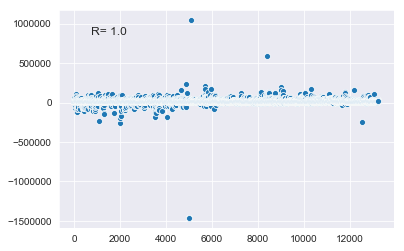

In [290]:
# Con un scaterplot de las diferencias cheque la distancia entre los puntos
legenda_corr='R= '+ str(df[df['currency']=='ARS'][['price','price_aprox_local_currency']].corr(method='pearson').iloc[0,0])
ax=sns.scatterplot(range(0,len(df[df['currency']=='ARS']['price']-df[df['currency']=='ARS']['price_aprox_local_currency'])),
                df[df['currency']=='ARS']['price']-df[df['currency']=='ARS']['price_aprox_local_currency']);
plt.text(0.15, 0.9, legenda_corr, horizontalalignment='center', verticalalignment='center', transform=ax.transAxes,fontsize=12);

In [291]:
# Me fijo cuantos valores están or arriba de los 50.000 de diferencia
df_dif=pd.DataFrame(df[df['currency']=='ARS']['price']-df[df['currency']=='ARS']['price_aprox_local_currency']).abs()
df_dif.columns = ['price_dif']
df_dif[df_dif['price_dif']>50000].shape[0]

671

- Dada la diferencia que hay entre la columna "price" y "price_aprox_local_currency" en moneda local (ARS), nos fijamos cómo se vinculan con los precios en USD para ver cuál es la columna que se usó para el cálculo y por qué se generó tanto error en algunos casos

In [292]:
from bokeh.plotting import figure 
from bokeh.io import output_notebook, show

In [293]:
output_notebook()

Loading BokehJS ...

In [294]:
df.head(1)

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
0,0,sell,PH,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6618237,-58.5088387",-34.661824,-58.508839,62000.0,USD,1093959.0,62000.0,55.0,40.0,1127.272727,1550.0,NaN,NaN,NaN,http://www.properati.com.ar/15bo8_venta_ph_mat...,"2 AMBIENTES TIPO CASA PLANTA BAJA POR PASILLO,...",2 AMB TIPO CASA SIN EXPENSAS EN PB,https://thumbs4.properati.com/8/BluUYiHJLhgIIK...


In [295]:
#Genero un data frame solo con los valores con ARS
df_only_ars=df[df['currency']=='ARS']

In [296]:
from bokeh.models import ColumnDataSource
from bokeh.layouts import gridplot

data_bokeh = ColumnDataSource(df_only_ars)

options = {'plot_width': 300,
           'plot_height': 300,
           'tools': 'pan, wheel_zoom, box_zoom, box_select, lasso_select, reset'}

p1 = figure(title="Price x USD_price", x_axis_label = "price_aprox_usd", y_axis_label = "price", **options)
p1.circle("price_aprox_usd", "price", color = "blue", source = data_bokeh)

p2 = figure(title="Price currency x USD_price", x_axis_label = "price_aprox_usd", y_axis_label = "price_aprox_local_currency", **options)
p2.circle("price_aprox_usd", "price_aprox_local_currency", color = "green", source = data_bokeh)

p = gridplot([[p1, p2]] , toolbar_location="right")

show(p)


* - Por lo que se ve en el gráfico cuando se hace zoom en los valores del extermo inferior izquierdo, Price curreny es el que mejor está asociado con USD_price. Para comprobarlo, vamos a calcular cuál es la cotización que corresponde a cada una de estas variables en función del USD_price


In [297]:
df_only_ars.head(1)

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
9,9,sell,house,Rosario,|Argentina|Santa Fe|Rosario|,Argentina,Santa Fe,3838574.0,"-32.942031,-60.7259192",-32.942031,-60.725919,460000.0,ARS,455201.45,25798.49,NaN,NaN,NaN,NaN,NaN,NaN,NaN,http://www.properati.com.ar/15box_venta_casa_r...,MEDNOZA AL 7600A UNA CUADRA DE CALLE MENDOZAWH...,WHITE 7637 - 2 DORMITORIOS CON PATIO,https://thumbs4.properati.com/8/RCf1YEWdF4rv98...


In [298]:
# Genero un dataframe auxiliar para evaluar las cotizaciones segun la variable price o price_at_currency
df_cotizacion=pd.DataFrame(df_only_ars['price']/df_only_ars['price_aprox_usd'])
df_cotizacion.columns=['Basado_price']
df_cotizacion['Basado_price_local_currency']=df_only_ars['price_aprox_local_currency']/df_only_ars['price_aprox_usd']

df_cotizacion.head(2)

,Basado_price,Basado_price_local_currency
9,17.830501,17.6445
32,17.830501,17.6445


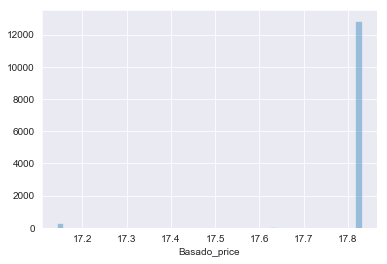

In [299]:
sns.distplot(df_cotizacion['Basado_price'],kde=False);

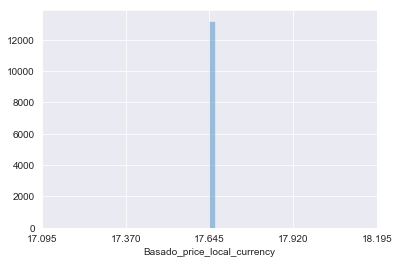

In [300]:
ax1=sns.distplot(df_cotizacion['Basado_price_local_currency'].round(5),kde=False);
ax1.get_xaxis().set_major_locator(LinearLocator(numticks=5))

In [301]:
# Si uno redondeo la información de Price, puede verse que hay varios tipos de cotizaciones
df_cotizacion_aux=pd.DataFrame(df_only_ars['price']/df_only_ars['price_aprox_usd']).round(5)
df_cotizacion_aux.columns=['Basado_price']

In [302]:
df_cotizacion_aux['Basado_price'].value_counts()

17.83050    12584
17.14300      280
17.83051      231
17.63400       53
17.83052       36
17.14301        8
17.83053        6
17.20400        4
17.79801        3
17.79800        3
17.50250        3
17.40400        2
17.14303        2
17.46700        1
17.63401        1
17.40500        1
17.42650        1
Name: Basado_price, dtype: int64

In [303]:
# Mientras que si hacemos lo mismo en 'price_aprox_local_currency' se usó casi un único cambio para cotizar
df_cotizacion_aux_dos=pd.DataFrame(df_only_ars['price_aprox_local_currency']/df_only_ars['price_aprox_usd']).round(5)
df_cotizacion_aux_dos.columns=['Basado_price_local_currency']
df_cotizacion_aux_dos['Basado_price_local_currency'].value_counts()

17.6445    13219
Name: Basado_price_local_currency, dtype: int64

Lo que encontramos es que en la variable "price" se usaron valores de cotización de la moneda que difieren más que los que se usaron en la variable "price_aprox_local_currency" (cuandose redondea). 

- Probamos de hacer ahora el analisis inverso y, aquellas entradas que fueron originalmente cargadas en dolares, nos fijamos cuál fue la cotización que se utilizó

In [304]:
df.head(2)

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
0,0,sell,PH,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6618237,-58.5088387",-34.661824,-58.508839,62000.0,USD,1093959.0,62000.0,55.0,40.0,1127.272727,1550.0,NaN,NaN,NaN,http://www.properati.com.ar/15bo8_venta_ph_mat...,"2 AMBIENTES TIPO CASA PLANTA BAJA POR PASILLO,...",2 AMB TIPO CASA SIN EXPENSAS EN PB,https://thumbs4.properati.com/8/BluUYiHJLhgIIK...
1,1,sell,apartment,La Plata,|Argentina|Bs.As. G.B.A. Zona Sur|La Plata|,Argentina,Bs.As. G.B.A. Zona Sur,3432039.0,"-34.9038831,-57.9643295",-34.903883,-57.964330,150000.0,USD,2646675.0,150000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,http://www.properati.com.ar/15bob_venta_depart...,Venta de departamento en décimo piso al frente...,VENTA Depto 2 dorm. a estrenar 7 e/ 36 y 37 ...,https://thumbs4.properati.com/7/ikpVBu2ztHA7jv...


In [305]:
#Genero un data frame solo con los valores con USD
df_only_usd=df[df['currency']=='USD']

In [306]:
#Me fijo la cotizacion pero haciendo "price_aprox_local_currency" sobre "price"
df_cotizacion_usd=pd.DataFrame(df_only_usd['price_aprox_local_currency']/df_only_usd['price'])
df_cotizacion_usd.columns=['USD_Basado_price']
df_cotizacion_usd.head()

,USD_Basado_price
0,17.6445
1,17.6445
2,17.6445
3,17.6445
4,17.6445


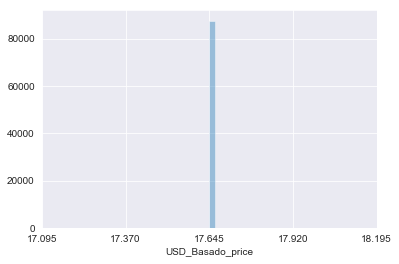

In [307]:
ax2=sns.distplot(df_cotizacion_usd['USD_Basado_price'].round(5),kde=False);
ax2.get_xaxis().set_major_locator(LinearLocator(numticks=5))

In [308]:
df_cotizacion_usd_aux=pd.DataFrame(df_only_usd['price_aprox_local_currency']/df_only_usd['price']).round(5)
df_cotizacion_usd_aux.columns=['Redondeado_USD_Basado_price']

In [309]:
df_cotizacion_usd_aux['Redondeado_USD_Basado_price'].value_counts()

17.6445    87587
Name: Redondeado_USD_Basado_price, dtype: int64

Cuando hacemos estimamos la cotización cuando el monto fue ingresado en USD, encontramos que la cotización corresponde a la que estimamos en "price_aprox_local_currency" (17.6445). Esto refuerza la idea de que la columna "verídica" son "price_aprox_local_currency"	y "price_aprox_usd"; y podemos utilizar estas para hacer los cálculos que dependan de los precios. Esta información nos sirve porque si recuperamos información de los precios en pesos de la columna descripción, para pasarla a dólares tendríamos que usar esta cotización.

In [310]:
# Para hacer un último chequeo, nos vijamos si transformando TODOS los valores que estan en price_aprox_usd, 
# obtenemos de vuelta los "price_aprox_local_currency"
df.head(1)

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
0,0,sell,PH,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6618237,-58.5088387",-34.661824,-58.508839,62000.0,USD,1093959.0,62000.0,55.0,40.0,1127.272727,1550.0,NaN,NaN,NaN,http://www.properati.com.ar/15bo8_venta_ph_mat...,"2 AMBIENTES TIPO CASA PLANTA BAJA POR PASILLO,...",2 AMB TIPO CASA SIN EXPENSAS EN PB,https://thumbs4.properati.com/8/BluUYiHJLhgIIK...


In [311]:
pd.DataFrame(df['price_aprox_usd']*17.6445).round(2).head(2)

,price_aprox_usd
0,1093959.0
1,2646675.0


In [312]:
df_from_usd_to_ars=pd.DataFrame(df['price_aprox_local_currency']-df['price_aprox_usd']*17.6445).round(2)
df_from_usd_to_ars.columns=['USD_to_ARS_17.6445']
df_from_usd_to_ars.head(5)

,USD_to_ARS_17.6445
0,0.0
1,0.0
2,0.0
3,0.0
4,0.0


In [313]:
df_from_usd_to_ars.describe()

,USD_to_ARS_17.6445
count,100810.000000
mean,-0.000886
std,0.002842
min,-0.010000
25%,0.000000
50%,0.000000
75%,0.000000
max,0.000000


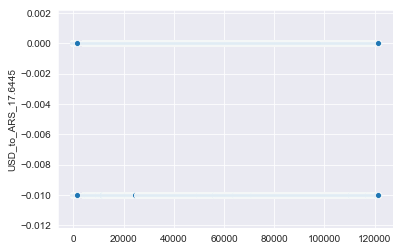

In [314]:
sns.scatterplot(range(0,len(df)),df_from_usd_to_ars['USD_to_ARS_17.6445']);

In [315]:
valid_from_usd_to_ars=df_from_usd_to_ars.iloc[df_from_usd_to_ars[df_from_usd_to_ars.notnull().T.any().T].index.values]
valid_from_usd_to_ars.head(10)

,USD_to_ARS_17.6445
0,0.00
1,0.00
2,0.00
3,0.00
4,0.00
6,0.00
7,0.00
8,0.00
9,-0.01
10,0.00


C:\Users\Agustin Ibanez\Anaconda3\lib\site-packages\statsmodels\nonparametric\kde.py:488: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
C:\Users\Agustin Ibanez\Anaconda3\lib\site-packages\statsmodels\nonparametric\kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2
C:\Users\Agustin Ibanez\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:83: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


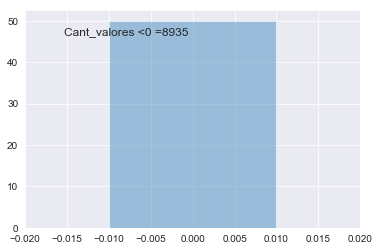

In [316]:
cant_dif='Cant_valores <0 ='+str(len(valid_from_usd_to_ars[valid_from_usd_to_ars['USD_to_ARS_17.6445']<0]))
ax3=sns.distplot(valid_from_usd_to_ars[valid_from_usd_to_ars['USD_to_ARS_17.6445']<0])
ax3.set_xlim(-0.02, 0.02)
plt.text(0.3, 0.9, 
         cant_dif, 
         horizontalalignment='center', 
         verticalalignment='center', 
         transform=ax3.transAxes,
         fontsize=12);

In [317]:
df_from_usd_to_ars_price=pd.DataFrame(df_only_ars['price']-df_only_ars['price_aprox_usd']*17.6445).round(2)
df_from_usd_to_ars_price.columns=['USD_to_ARS_price_17.6445']
df_from_usd_to_ars_price.head(5)

,USD_to_ARS_price_17.6445
9,4798.54
32,5737.40
37,13039.56
78,57373.65
97,14852.62


In [318]:
df_from_usd_to_ars_price.describe().round(3)

,USD_to_ARS_price_17.6445
count,13219.000
mean,15991.163
std,38172.246
min,-1462696.120
25%,10431.680
50%,14604.320
75%,20273.495
max,1043156.530


Observamos que recuperamos los valores de la columna "price_aprox_local_currency" casi a la perfeccion (un error máximo de diez centavos). Mientras que los de la columna 'Price' que están asociados a un currency 'ARS' presenten diferencias respecto de la cotización que parecería ser la correcta (17.6445) que son mucho mayores

- Nos quedamos para trabajar con "price_aprox_local_currency", "price_aprox_usd" y con una cotización de 17.6445

## 3.2 Caracterización de las variables precios y expensas

Dropeo las filas sin ningún valor. No descarta ninguna

In [319]:
df.dropna(axis=0, how='all').count()

Unnamed: 0                    121220
operation                     121220
property_type                 121220
place_name                    121197
place_with_parent_names       121220
country_name                  121220
state_name                    121220
geonames_id                   102503
lat-lon                        69670
lat                            69670
lon                            69670
price                         100810
currency                      100809
price_aprox_local_currency    100810
price_aprox_usd               100810
surface_total_in_m2            81892
surface_covered_in_m2         101313
price_usd_per_m2               68617
price_per_m2                   87658
floor                           7899
rooms                          47390
expenses                       14262
properati_url                 121220
description                   121218
title                         121220
image_thumbnail               118108
dtype: int64

Cuento los valores nulos. Se ve que hay más valores missing en precios x m2, y aún más en usd.

In [320]:
df.isnull().sum()

Unnamed: 0                         0
operation                          0
property_type                      0
place_name                        23
place_with_parent_names            0
country_name                       0
state_name                         0
geonames_id                    18717
lat-lon                        51550
lat                            51550
lon                            51550
price                          20410
currency                       20411
price_aprox_local_currency     20410
price_aprox_usd                20410
surface_total_in_m2            39328
surface_covered_in_m2          19907
price_usd_per_m2               52603
price_per_m2                   33562
floor                         113321
rooms                          73830
expenses                      106958
properati_url                      0
description                        2
title                              0
image_thumbnail                 3112
dtype: int64

Donde hay missing de m2, hay valores de superficie y precio total. Esto da una pista de cómo rellenar algunos missing de m2 

In [321]:
df[df['price_usd_per_m2'].isnull()].all()

Unnamed: 0                     True
operation                      True
property_type                  True
place_name                     True
place_with_parent_names        True
country_name                   True
state_name                     True
geonames_id                    True
lat-lon                        True
lat                            True
lon                            True
price                         False
currency                       True
price_aprox_local_currency    False
price_aprox_usd               False
surface_total_in_m2           False
surface_covered_in_m2          True
price_usd_per_m2               True
price_per_m2                   True
floor                          True
rooms                          True
expenses                       True
properati_url                  True
description                    True
title                          True
image_thumbnail                True
dtype: bool

Observo los estadisticos basicos de las variables cuantitativas relativas a precio. 
Se ve que hay errores en los valores min precios totales y errores en los valores max por m2

In [322]:
df[["price_aprox_local_currency", "price_aprox_usd", "price_usd_per_m2", "price_per_m2", "expenses"]].describe().round(2)

,price_aprox_local_currency,price_aprox_usd,price_usd_per_m2,price_per_m2,expenses
count,1.008100e+05,100810.00,68617.00,87658.00,14262.00
mean,4.229397e+06,239700.58,2160.09,6912.22,5009.23
std,6.904714e+06,391323.88,2759.29,28378.64,120440.26
min,0.000000e+00,0.00,0.60,1.51,1.00
25%,1.583309e+06,89733.88,1218.18,1550.00,1000.00
50%,2.558452e+06,145000.00,1800.00,2213.11,2000.00
75%,4.675792e+06,265000.00,2486.41,3355.55,4000.00
max,8.212711e+08,46545445.00,206333.33,3999999.96,10001500.00


Y los valores de la variable categórica currency. Se ve que los precios por fuera de ARS y USD no son significativos 
PEN es nuevo sol peruano

In [323]:
df["currency"].value_counts()

USD    87587
ARS    13219
PEN        2
UYU        1
Name: currency, dtype: int64

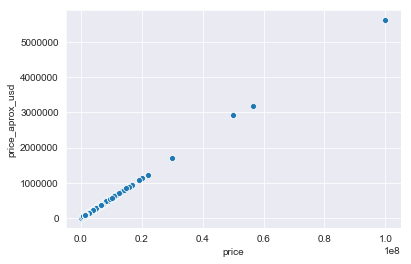

In [324]:
# REEMPLAZAR DIRECTAMENTE POR LOS SCATTERPLOTS

df[df['currency']=='USD']
sns.scatterplot(df[(df['currency']=='ARS')]['price'],
                df[(df['currency']=='ARS')]['price_aprox_usd']);

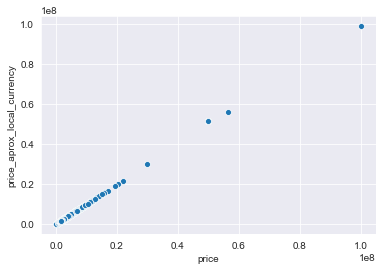

In [325]:
sns.scatterplot(df[(df['currency']=='ARS')]['price'],
                df[(df['currency']=='ARS')]['price_aprox_local_currency']);

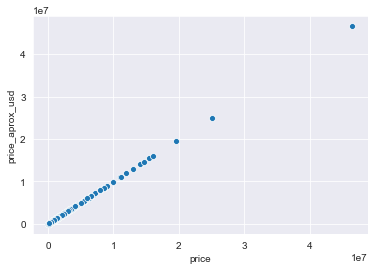

In [326]:
df[df['currency']=='USD']
sns.scatterplot(df[(df['currency']=='USD')]['price'],
                df[(df['currency']=='USD')]['price_aprox_usd']);

In [327]:
# Observo estadísticos agrupados por moneda

df.groupby('currency')["price_aprox_usd"].aggregate([min, np.mean, np.median, max]).round(2)

# Se observa un problema con los mínimos y el máximo el USD parece sobredimensionado. Chequear con superficie. 

,min,mean,median,max
currency,,,,
ARS,4666.62,101028.04,79638.82,5608367.62
PEN,117139.33,204993.83,204993.83,292848.33
USD,5000.00,260373.52,160000.00,46545445.00
UYU,22980378.29,22980378.29,22980378.29,22980378.29


In [328]:
df.groupby('currency')["price"].aggregate([min, np.mean, np.median, max]).round(2)

#Idem precios mínimos

,min,mean,median,max
currency,,,,
ARS,80000.0,1.798580e+06,1419000.0,99999999.0
PEN,380000.0,6.650000e+05,665000.0,950000.0
USD,5000.0,2.603735e+05,160000.0,46545445.0
UYU,650000000.0,6.500000e+08,650000000.0,650000000.0


In [329]:
df.groupby('currency')["price_aprox_local_currency"].aggregate([min, np.mean, np.median, max]).round(2)

# No es aconsejable utilizar el valor en moneda local. 

,min,mean,median,max
currency,,,,
ARS,8.234017e+04,1.782589e+06,1.405187e+06,9.895684e+07
PEN,2.066865e+06,3.617014e+06,3.617014e+06,5.167162e+06
USD,8.822250e+04,4.594161e+06,2.823120e+06,8.212711e+08
UYU,4.054773e+08,4.054773e+08,4.054773e+08,4.054773e+08


In [330]:
df.groupby('currency')["price_usd_per_m2"].aggregate([min, np.mean, np.median, max]).round(2)

# Como m2 en USD tiene mas valores null, se pueden usar ambas variables de m2 para completar

,min,mean,median,max
currency,,,,
ARS,1.18,1574.54,1546.55,21031.38
PEN,NaN,NaN,NaN,NaN
USD,0.60,2242.70,1867.76,206333.33
UYU,NaN,NaN,NaN,NaN


In [331]:
df.groupby('currency')["price_per_m2"].aggregate([min, np.mean, np.median, max]).round(2)

,min,mean,median,max
currency,,,,
ARS,57.14,33402.71,30231.28,3999999.96
PEN,NaN,NaN,NaN,NaN
USD,1.51,3335.33,2045.45,2600000.00
UYU,NaN,NaN,NaN,NaN


El valor por m2 no puede superar NUNCA los 40k porque estaria por encima del valor mas alto del mundo
Busco esos valores outliers

In [332]:
index_m2 = df[df['price_usd_per_m2']>40000.00].index.values
index_m2.shape

(29,)

In [333]:
# Reemplazo esos valores por Nan e impacto en df2

df2.loc[index_m2,'price_usd_per_m2']=np.nan
df2.loc[index_m2,'price_usd_per_m2']

25287    NaN
25288    NaN
25853    NaN
25967    NaN
26037    NaN
26193    NaN
26637    NaN
26761    NaN
26905    NaN
26992    NaN
27000    NaN
27001    NaN
27004    NaN
27059    NaN
27061    NaN
27062    NaN
27064    NaN
27065    NaN
27066    NaN
27067    NaN
27068    NaN
27069    NaN
27070    NaN
27071    NaN
44906    NaN
56214    NaN
107057   NaN
107059   NaN
114131   NaN
Name: price_usd_per_m2, dtype: float64

In [334]:
# Creo un df resumen para que muestre solo las variables relevantes

df_resumen = df.filter(["currency", "price", "price_aprox_usd", "surface_total_in_m2", "surface_covered_in_m2", "price_usd_per_m2", "price_per_m2", "description"], axis=1)

In [335]:
# Para el valor total pruebo valores mayores a 10 millones. 
# De los que tienen datos de sup y m2, no se ven consistentes 24548 y 114131.El resto habria que chequear con descripcion

indices_df = df_resumen[df_resumen['price_aprox_usd']>10000000.00].index
df_resumen.iloc[indices_df]

,currency,price,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,description
525,USD,11000000.0,11000000.00,7500.0,1800.0,1466.666667,6111.111111,Total vista al rÃ­o. Sobre 7500 m2 de parque a...
24548,USD,46545445.0,46545445.00,200000.0,NaN,232.727225,NaN,dsdffhghvcvbcdfdfghdfhghkjhkhjklhjkfgvghfghnfg...
34638,USD,14000000.0,14000000.00,2079.0,NaN,6734.006734,NaN,Excelente zona. Cerca de la Quinat Presidencia...
45689,USD,11111111.0,11111111.00,304.0,149.0,36549.707237,74571.214765,CODIGO: 2062-670 ubicado en: URQUIZA 7900 - P...
49083,USD,15500000.0,15500000.00,NaN,NaN,NaN,NaN,CODIGO: 1092-vta-angostura ubicado en: Villa L...
84400,USD,13000000.0,13000000.00,NaN,NaN,NaN,NaN,AL VALOR PUBLICADO DEBERÁ ADICIONÁRSELE EL IMP...
91229,USD,14000000.0,14000000.00,NaN,NaN,NaN,NaN,"Casa con Agua Corriente, Córdoba, Punilla, por..."
91289,USD,16000000.0,16000000.00,NaN,NaN,NaN,NaN,"En Bv Artigas 876 , Parque Jardín, La Falda .A..."
91428,USD,14700000.0,14700000.00,NaN,NaN,NaN,NaN,\tCECILIA INMUEBLES OFRECE:APTO CREDITO HIPOTE...
91468,USD,25000000.0,25000000.00,NaN,NaN,NaN,NaN,"Casa con Agua Corriente, Córdoba, Punilla, por..."


In [336]:
from sklearn import datasets

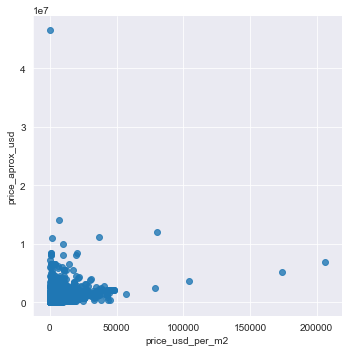

In [337]:
# Se ve en el grafico que los valores antes identificados son outliers

sns.lmplot(data=df, x="price_usd_per_m2", y="price_aprox_usd", fit_reg=False)

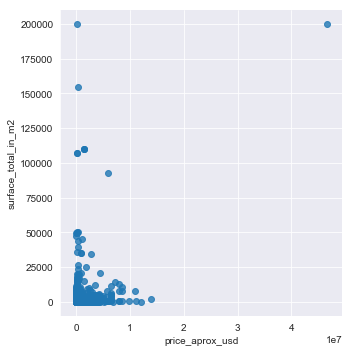

In [338]:
# Otra estrategia para ver la razonabilidad de los precios es comparar con la superficie

sns.lmplot(data = df, x="price_aprox_usd", y="surface_total_in_m2", fit_reg=False)

In [339]:
# Armo una variable nueva con el precio calculado del m2

df["price_usd_m2_calc"] = df["price_aprox_usd"] / df["surface_total_in_m2"]

In [340]:
df.filter(["price_usd_m2_calc","price_usd_per_m2"]).sample(10)

,price_usd_m2_calc,price_usd_per_m2
62746,NaN,NaN
5846,1419.354839,1419.354839
43582,NaN,NaN
78211,916.666667,916.666667
83549,1769.911504,1769.911504
15066,NaN,NaN
71124,2603.773585,2603.773585
47446,NaN,NaN
103,NaN,NaN
26628,485.074627,485.074627


In [341]:
# Los missing de price y price_aprox_local_currency corresponden a las mismas filas, no hay informacion extra

df['price'][(np.isnan(df['price_usd_per_m2']))&(np.isnan(df['price_aprox_usd']))].value_counts(dropna=False)

NaN    20410
Name: price, dtype: int64

In [342]:
df['price_aprox_local_currency'][(np.isnan(df['price_usd_per_m2']))&(np.isnan(df['price_aprox_usd']))].value_counts(dropna=False)

NaN    20410
Name: price_aprox_local_currency, dtype: int64

In [343]:
# La columna expensas no parece tener informacion relevante, ya que la mayoria de los valores son null

df[['expenses']].describe()

,expenses
count,1.426200e+04
mean,5.009234e+03
std,1.204403e+05
min,1.000000e+00
25%,1.000000e+03
50%,2.000000e+03
75%,4.000000e+03
max,1.000150e+07


In [344]:
df[['expenses']].isnull().sum()

expenses    106958
dtype: int64

array([<matplotlib.axes._subplots.AxesSubplot object at 0x0000001C13143C88>,
      dtype=object)

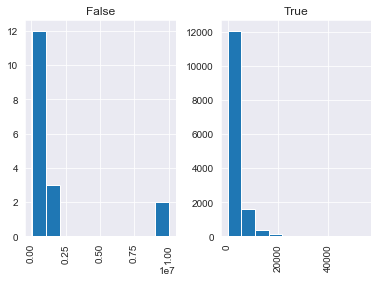

In [345]:
# Miro la distribucion de los datos que parecen outliers

df["expenses"].hist(df['expenses']<= 60000)

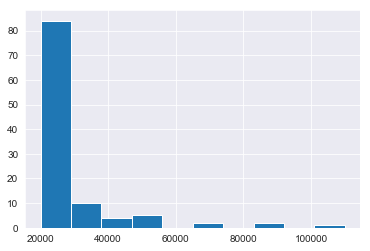

In [346]:
df_exp1 = df[(df['expenses'] >= 20000) & (df['expenses'] <= 150000)]
df_exp1["expenses"].hist()

In [347]:
indices_exp1 = df[df['expenses']>60000].index
df.iloc[indices_exp1][["property_type", "price", "expenses", "price_aprox_usd", "price_aprox_local_currency", "surface_total_in_m2"]].head()

,property_type,price,expenses,price_aprox_usd,price_aprox_local_currency,surface_total_in_m2
17735,house,210000.0,230000.0,210000.00,3705345.00,96.0
22991,house,90000.0,90000.0,90000.00,1588005.00,NaN
24524,house,1250000.0,1250000.0,70104.59,1236960.43,NaN
28049,apartment,110000.0,110000.0,110000.00,1940895.00,NaN
35801,apartment,290000.0,220000.0,16264.26,286974.73,450.0


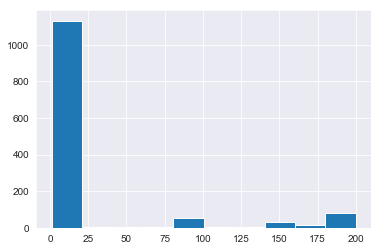

In [348]:
df_exp1 = df[(df['expenses'] > 0) & (df['expenses'] <= 200)]
df_exp1["expenses"].hist()

In [349]:
indices_exp1 = df[df['expenses']<100].index
df.iloc[indices_exp1][["property_type", "price", "expenses", "price_aprox_usd", "price_aprox_local_currency", "surface_total_in_m2"]].head()

,property_type,price,expenses,price_aprox_usd,price_aprox_local_currency,surface_total_in_m2
198,apartment,110000.0,1.0,110000.0,1940895.0,60.0
910,apartment,NaN,1.0,NaN,NaN,NaN
5623,apartment,NaN,1.0,NaN,NaN,44.0
6317,store,NaN,1.0,NaN,NaN,39.0
6429,apartment,650000.0,85.0,650000.0,11468925.0,90.0


Concluyo que podrian reemplazar todos los valores de expensas que esten debajo de 25 y arriba de 70k por NaN
Lo impacto en df2

In [350]:
index_exp=df[df['expenses']<25].index.values
df2.loc[index_exp,'expenses']=np.nan

In [351]:
index_exp=df[df['expenses']>70000].index.values
df2.loc[index_exp,'expenses']=np.nan
df2.loc[index_exp,'expenses'].head()

17735   NaN
22991   NaN
24524   NaN
28049   NaN
35801   NaN
Name: expenses, dtype: float64

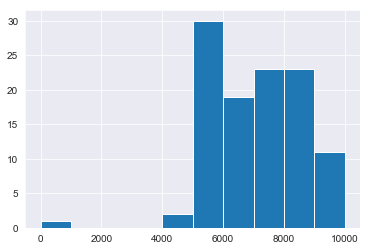

In [352]:
# Sabiendo que la variable a tener en cuenta es price_aprox_usd, observo la distribucion de los valores extremos

df_p1 = df[(df['price_aprox_usd'] <= 10000)]
df_p1["price_aprox_usd"].hist()

In [353]:
indices_p1 = df[df['price_aprox_usd']<10000].index
df.iloc[indices_p1][["property_type", "price", "expenses", "price_aprox_usd", "price_aprox_local_currency", "surface_total_in_m2", "description"]].head()

,property_type,price,expenses,price_aprox_usd,price_aprox_local_currency,surface_total_in_m2,description
836,store,150000.0,NaN,8412.55,148435.23,NaN,"Venta de Negocio en Tolosa, La Plata116 entre..."
4399,apartment,5000.0,NaN,5000.00,88222.50,NaN,Corredor Responsable: Mauro Marvisi - CMCPSI 5...
6720,apartment,99999.0,NaN,5608.31,98955.82,40.0,BV Rondeau / Nancen: A metros del Shoping Port...
7440,house,125000.0,NaN,7010.45,123695.88,368.0,"EXCELENTE CABAÑA 3 DORM, 2 BAÑOS, PARQUE, A 30..."
9665,house,170000.0,NaN,9534.22,168226.54,200.0,CODIGO: 7 ubicado en: Juana Manuela Gorritti -...


In [354]:
df.loc[116133,'description']

'VENDO DUPLEX-CASI NUEVO-Bº Alto Verde, próximo a Av. Rodriguez Del Busto. Posee Living amplio y separado Toilette Comedor Cocina con Amoblamientos y habitáculo para Lava-ropas Galería con Asador Patio Piscina Escalera Tres Dormitorios C/Placard y uno con Vestidor Baño con Ante-Baño. Medidas: Terreno 200m2 y Cubiertos 101m2. Servicios de Luz Agua Gas Natural. VALOR U$S 160.000. SE RECIBE INMUEBLE DE MENOR VALOR. Consultas al Te: 497-2019 de Lunes a Viernes de 9 a 13 y de 16.30 a 19Hs. INMOBILIARIA MILANESIO.'

In [355]:
# Convierto los valores menores a 10000 en NaN

index_aux=df[df['price_aprox_usd']<10000].index.values

In [356]:
df2.loc[index_aux,'price_aprox_usd']=np.nan

In [357]:
df2.loc[index_aux]['price_aprox_usd'].head()

836    NaN
4399   NaN
6720   NaN
7440   NaN
9665   NaN
Name: price_aprox_usd, dtype: float64

In [358]:
df["price_aprox_usd"].describe()

count    1.008100e+05
mean     2.397006e+05
std      3.913239e+05
min      0.000000e+00
25%      8.973388e+04
50%      1.450000e+05
75%      2.650000e+05
max      4.654544e+07
Name: price_aprox_usd, dtype: float64

In [359]:
# Los valores > 20 millones se ven como outliers en el scatterplot

index_aux2=df[df['price_aprox_usd']>20000000].index.values
index_aux2

array([ 24548,  91468, 107390], dtype=int64)

In [360]:
# Esta es definitivamente un outlier

df.loc[24548]

Unnamed: 0                                                                24548
operation                                                                  sell
property_type                                                         apartment
place_name                                                            San Telmo
place_with_parent_names                   |Argentina|Capital Federal|San Telmo|
country_name                                                          Argentina
state_name                                                      Capital Federal
geonames_id                                                         3.42811e+06
lat-lon                                                 -34.6213421,-58.3741846
lat                                                                    -34.6213
lon                                                                    -58.3742
price                                                               4.65454e+07
currency                                

In [361]:
# Las dos siguientes, el precio es alto pero se verifica en la descripcion asi que es incierto que sean outliers

df.loc[91468,'description']

'Casa con Agua Corriente, Córdoba, Punilla, por U$S 25.000.000'

In [362]:
df.loc[107390, 'description']

'Casa con Calefacción central, Mendoza, San Roque, por $ 650.000.000'

In [363]:
# Transformo en NaN el outlier

index_aux3=df[df['price_aprox_usd']>40000000].index.values
df2.loc[index_aux3,'price_aprox_usd']=np.nan
df2.loc[index_aux3]['price_aprox_usd']

24548   NaN
Name: price_aprox_usd, dtype: float64

Agregamos una columna en el dataframe 2 en la que ponemos 1 si tienen expensas y 0 si no tienen expensas

In [364]:
df2['Tiene_expensas']=pd.Series(np.zeros(len(df2)))

In [365]:
df2['Tiene_expensas'][df2['expenses']>0]=float(1)

C:\Users\Agustin Ibanez\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


## 3.3 Revisamos con expresiones regulares los títulos y descripciones para recuperar valores faltantes de precios

In [366]:
search_price=df["description"]#.head(20)

In [367]:
search_price=pd.DataFrame(search_price)
search_price=search_price.fillna(value='lucas')
search_price.loc[10664,:]

description    lucas
Name: 10664, dtype: object

In [368]:
pattern=r'(?<=U[$S]D)\s*(\d+[.,]?\d+)|(\d+[.,]?\d+)\s*(?=U[$S]D)|(?<=dolares)\s*(\d+[.,]?\d+)|(\d+[.,]?\d+)\s*(?=dolares)' #Aca agrego al patron de busqueda la palabra dolares + numeros
regex = re.compile(pattern, flags = re.IGNORECASE)
#regex.findall(search_price)

In [369]:
PreciosUSD=[]
for i in np.array(search_price['description']):
    PreciosUSD.append(regex.findall(i))

In [370]:
PreciosUSD=pd.Series(PreciosUSD)


In [371]:
PreciosUSD2=[]
for i in PreciosUSD:
    if len(i)==1:
        for elements in i:
            #print (elements)
            PreciosUSD2.append([float(x.replace(',','.')) for x in elements if x !=""][0])
    else:
        PreciosUSD2.append(0)

In [372]:
PreciosUSD2=pd.DataFrame(PreciosUSD2)

In [373]:
PreciosUSD2.describe().round(2)

,0
count,121220.00
mean,6074.58
std,84515.74
min,0.00
25%,0.00
50%,0.00
75%,0.00
max,15500000.00


In [374]:
PreciosUSD2.columns = ['USD']
index_aux=PreciosUSD2[PreciosUSD2['USD']<10000].index.values        

In [375]:
PreciosUSD2.at[index_aux]=0
PreciosUSD2['USD'].value_counts()

0.0         116995
120000.0       133
130000.0       132
110000.0       106
80000.0        106
75000.0        104
90000.0        101
85000.0        100
140000.0       100
95000.0        100
150000.0        89
100000.0        86
250000.0        81
160000.0        79
125000.0        74
60000.0         74
65000.0         73
70000.0         72
180000.0        64
115000.0        64
135000.0        60
55000.0         60
170000.0        56
78000.0         43
105000.0        42
50000.0         41
200000.0        40
220000.0        38
165000.0        37
230000.0        37
             ...  
162000.0         1
74900.0          1
730000.0         1
248000.0         1
74700.0          1
182000.0         1
495000.0         1
123552.0         1
595000.0         1
123500.0         1
32500.0          1
123298.0         1
181000.0         1
106000.0         1
427000.0         1
690000.0         1
73900.0          1
36943.0          1
61500.0          1
73800.0          1
127500.0         1
131000.0    

In [376]:
patronpesos=r'(?<=$)\s*(\d+[.,]?\d+)|(\d+[.,]?\d+)\s*(?=$)|(?<=pesos)\s*(\d+[.,]?\d+)|(\d+[.,]?\d+)\s*(?=pesos)'
regex2 = re.compile(patronpesos, flags = re.IGNORECASE)

In [377]:
PreciosPesos=[]
for i in np.array(search_price['description']):
    PreciosPesos.append(regex2.findall(i))

In [378]:
PreciosPesos2=[]
for i in PreciosPesos:
    if len(i)==1:
        for elements in i:
            #print (elements)
            PreciosPesos2.append([float(x.replace(',','.')) for x in elements if x !=""][0])
    else:
        PreciosPesos2.append(0)

In [379]:
PreciosPesos2=pd.DataFrame(PreciosPesos2)

In [380]:
PreciosPesos2.columns=['ARGS']

In [381]:
PreciosPesos2=PreciosPesos2["ARGS"]/17.6445 # usamos la cotización del dolar identificada al principio de esta etapa

In [382]:
PreciosPesos2=pd.DataFrame(PreciosPesos2)
PreciosPesos2['ARGS'].value_counts().round(2)

0.000000e+00    102267
2.611303e+05       851
6.234237e-01       668
8.750602e+01       485
3.448100e+02       447
2.249993e+01       440
2.540596e+05       426
1.059820e+02       419
1.143132e+02       381
2.919323e+02       311
4.180906e+02       298
5.018561e+02       259
1.309190e+01       226
1.143699e+02       223
1.649806e+02       217
1.144266e+02       175
2.842245e+02       166
3.380657e+02       159
2.833744e+01       148
2.692057e+01       146
2.681856e+02       142
1.100060e+02       140
6.560187e+07       137
1.014480e+01       119
2.380345e+00       117
3.462357e+12       109
3.492873e+02        92
3.003769e+00        92
1.190173e+00        90
3.407294e+02        88
                 ...  
1.957749e+01         1
5.651965e+06         1
3.546369e+01         1
1.624240e+04         1
1.176967e+04         1
6.227266e+03         1
3.225368e+02         1
6.352461e+03         1
2.613846e+01         1
1.042251e+01         1
2.167406e+04         1
1.132364e+02         1
1.482643e+0

In [383]:
InfoTitulo=df["title"]

In [384]:
pattern2=r'(?<=U[$S]D)\s*(\d+[.,]?\d+)|(\d+[.,]?\d+)\s*(?=U[$S]D)|(?<=dolares)\s*(\d+[.,]?\d+)|(\d+[.,]?\d+)\s*(?=dolares)' #Aca agrego al patron de busqueda la palabra dolares + numeros
regex3 = re.compile(pattern2, flags = re.IGNORECASE)

In [385]:
PreciosUSDtitulo=[]
for i in (InfoTitulo):
    PreciosUSDtitulo.append(regex3.findall(i))

In [386]:
pd.DataFrame(PreciosUSDtitulo).sum() #No hay ningun precio en USD en los titulos de las propiedade

Series([], dtype: float64)

In [387]:
patronpesos2=r'(?<=$)\s*(\d+[.,]?\d+)|(\d+[.,]?\d+)\s*(?=$)|(?<=pesos)\s*(\d+[.,]?\d+)|(\d+[.,]?\d+)\s*(?=pesos)'
regex4 = re.compile(patronpesos2, flags = re.IGNORECASE)

In [388]:
PreciosPesostitulo=[]
for i in (InfoTitulo):
    PreciosPesostitulo.append(regex4.findall(i))

In [389]:
pd.DataFrame(PreciosPesostitulo).sum()

Series([], dtype: float64)

In [390]:
PreciosPesosTitulo2=[]
for i in PreciosPesostitulo:
    if len(i)==1:
        for elements in i:
            #print (elements)
            PreciosPesosTitulo2.append([float(x.replace(',','.')) for x in elements if x !=""][0])
    else:
        PreciosPesosTitulo2.append(0)

In [391]:
PreciosPesosTitulo2=pd.DataFrame(PreciosPesosTitulo2)

In [392]:
PreciosPesosTitulo2.columns=["ARSTITULO"]

In [393]:
PreciosPesosTitulo2=PreciosPesosTitulo2["ARSTITULO"]/17.6445

In [394]:
PreciosPesosTitulo2=pd.DataFrame(PreciosPesosTitulo2)

PreciosPesosTitulo2=Precios expresados en dolares obtenidos de los titulos en valor pesos.

PreciosPesos2= Precios expresados en dolares obtenidos de la descripcion en valor pesos.

PreciosUSD2=Precios en usd obtenidos de la descripción.

In [395]:
precios = pd.concat([PreciosPesosTitulo2,PreciosPesos2,PreciosUSD2], axis=1)
precios.head()

,ARSTITULO,ARGS,USD
0,0.000000,0.0,0.0
1,2.096971,0.0,0.0
2,0.000000,0.0,0.0
3,0.000000,0.0,0.0
4,0.000000,0.0,0.0


In [396]:
precios['preciofinal']=precios["ARSTITULO"]+precios["ARGS"]+ precios["USD"]

In [397]:
aux_index=precios[precios['preciofinal']<10000]['preciofinal'].index.values

In [398]:
precios.loc[aux_index,'preciofinal']=0

Reemplazo los valores que encontré en el dataframe 2, en los lugares donde hay nan en price_arpox_usd

In [399]:
aux_index_nan=df2[df2['price_aprox_usd'].isnull()].index.values

In [400]:
df2.loc[aux_index_nan,'price_aprox_usd']=precios.loc[aux_index_nan,'preciofinal']

In [401]:
df2['price_aprox_usd'][df2['price_aprox_usd']==0]=np.nan

C:\Users\Agustin Ibanez\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


## 3.4 Recuperación valores superficie a partir de valores de precio final

### Probamos primero aquellos con valores nan en total pero con valores en covered

In [402]:
df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull())].\
pivot_table(index='property_type', aggfunc={'property_type':('count'),'price_aprox_usd':('median')})

,price_aprox_usd,property_type
property_type,,
PH,8.796843e+06,34
house,8.808159e+05,1336
store,2.611303e+05,84


Nos fijamos cuántas tienen variables de precio en usd y precio usd per m2 para recuperar esos valores de superficie haciendo la relación entre ambos

In [403]:
df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) & \
    (df2['price_aprox_usd'].notnull()) & (df2['price_usd_per_m2'].notnull())].\
pivot_table(index='property_type', aggfunc={'property_type':('count'),'price_aprox_usd':('median')})

""
property_type


No hay ninguna entrada en la que tengamos valores cubiertos, valores de precio en dolares y precio en dólares en m2. 

probamos con los precios en moenda local y precio en m2 en moneda local

In [404]:
df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull()) & \
    (df2['price_aprox_local_currency'].notnull()) & (df2['price_per_m2'].notnull())].\
pivot_table(index='property_type', aggfunc={'property_type':('count'),'price_aprox_usd':('median')})

""
property_type


Tampoco encontramos valores que a partir de los precios en la moneda local nos permita estimar la superficie total en los casos en los que tenemos el datos de superficie cubierta

Siendo este el caso, completamos la superficie total con la cubierta en estos casos como hicimos anteriormente, aunque es probable que estas entradas sean descartadas por datos faltantes. 

In [405]:
aux_index=df2[(df2['surface_total_in_m2'].isnull()) & (df2['surface_covered_in_m2'].notnull())].index.values

In [406]:
df2.loc[aux_index,'surface_total_in_m2']=df2.loc[aux_index,'surface_covered_in_m2']

#### Probamos recuperar datos de superficie total a partir de precios en metros cuadrados

In [407]:
df2[(df2['surface_total_in_m2'].isnull())].\
pivot_table(index='property_type', aggfunc={'property_type':('count'),'price_aprox_usd':('median')})

,price_aprox_usd,property_type
property_type,,
PH,95000.00,584
apartment,85000.00,5949
house,140209.19,4383
store,140000.00,439


Nos fijamos cuántas de estas entradas tienen datos en dolares totales y dólares en m2 para poder recuperar la superficie total

In [408]:
df2[(df2['surface_total_in_m2'].isnull()) & \
    (df2['price_aprox_usd'].notnull()) & (df2['price_usd_per_m2'].notnull())].\
pivot_table(index='property_type', aggfunc={'property_type':('count'),'price_aprox_usd':('median')})

,price_aprox_usd,property_type
property_type,,
apartment,49800.0,1


In [409]:
df2[(df2['surface_total_in_m2'].isnull()) & \
    (df2['price_aprox_usd'].notnull()) & (df2['price_usd_per_m2'].notnull())]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail,Tiene_expensas
11534,11534.0,sell,apartment,Mar del Plata,|Argentina|Buenos Aires Costa Atlántica|Mar de...,Argentina,Buenos Aires Costa Atlántica,3430863.0,"-38.0051676,-57.5444832",-38.005168,-57.544483,49800.0,USD,878696.1,49800.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,http://www.properati.com.ar/16bzw_venta_depart...,TOTALMENTE LUMINOSO LIVING COMEDOR CON AMPLIO ...,DEPARTAMENTO EN VENTA,https://thumbs4.properati.com/6/vggfdgnqIgFMN4...,0.0


En una sola entrada encontramos que habiendo valores nan de superficie, encontramos valores de precio en dolare y en m2 dolar, pero el precio que figura es de 1; consideramos que es un dato erróneo y lo llenamos con nans

In [410]:
df2.loc[11534,:]=np.nan

Nos fijamos cuántos puede tener información con moneda argentina

In [411]:
df2[(df2['surface_total_in_m2'].isnull()) & \
    (df2['price_aprox_local_currency'].notnull()) & (df2['price_per_m2'].notnull())].\
pivot_table(index='property_type', aggfunc={'property_type':('count'),'price_aprox_usd':('median')})

,price_aprox_usd,property_type
property_type,,
PH,97500.0,26
apartment,93500.0,102
house,190000.0,78
store,180000.0,18


In [412]:
df2[(df2['surface_total_in_m2'].isnull()) & \
    (df2['price_aprox_local_currency'].notnull()) & (df2['price_per_m2'].notnull())].head(10)

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail,Tiene_expensas
349,349.0,sell,apartment,Córdoba,|Argentina|Córdoba|Córdoba|,Argentina,Córdoba,3860259.0,"-31.430822,-64.1902624",-31.430822,-64.190262,1236000.0,USD,21808602.0,1236000.0,NaN,NaN,NaN,1236000.0,NaN,1.0,NaN,http://www.properati.com.ar/15e6o_venta_depart...,Departamento en Venta de 1 dorm. en Cordoba,NUEVA CORDOBA - CIUDAD UNIVERSITARIA -,https://thumbs4.properati.com/6/--OsjGZYFJohU3...,0.0
920,920.0,sell,house,Esteban Echeverría,|Argentina|Bs.As. G.B.A. Zona Sur|Esteban Eche...,Argentina,Bs.As. G.B.A. Zona Sur,3434003.0,"-34.8487278,-58.4823123",-34.848728,-58.482312,65000.0,USD,1146892.5,65000.0,NaN,NaN,NaN,16250.0,NaN,NaN,NaN,http://www.properati.com.ar/15gkf_venta_casa_e...,OPORTUNIDAD !!! VENDO CHALET DE 2 PLANTAS EN E...,CHALET DE 2 PLANTAS EN EL JAGUEL !!!,https://thumbs4.properati.com/2/DO0MahhHg-jIJ9...,0.0
4917,4917.0,sell,house,Santa Fe,|Argentina|Santa Fe|Santa Fe|,Argentina,Santa Fe,3836277.0,"-31.6106578,-60.697294",-31.610658,-60.697294,215000.0,USD,3793567.5,215000.0,NaN,NaN,NaN,215000.0,NaN,NaN,NaN,http://www.properati.com.ar/15ogh_venta_casa_s...,"Se vende casa a estrenar en Aires del Llano, ...",SE VENDE CASA A ESTRENAR EN AIRES DEL LLANO,https://thumbs4.properati.com/8/3Kk4lymhckqzxz...,0.0
6904,6904.0,sell,house,Ramos Mejía,|Argentina|Bs.As. G.B.A. Zona Oeste|La Matanza...,Argentina,Bs.As. G.B.A. Zona Oeste,3429617.0,NaN,NaN,NaN,350000.0,USD,6175575.0,350000.0,NaN,NaN,NaN,350000.0,NaN,4.0,NaN,http://www.properati.com.ar/15w1v_venta_casa_r...,"Excelente chalet de 4 ambientes, (1 en suite),...",Casa en Venta Ramos Mejia / La Matanza (A025 ...,https://thumbs4.properati.com/2/430E-vkeOrj-76...,0.0
7107,7107.0,sell,apartment,Roosevelt,|Argentina|Buenos Aires Interior|Rivadavia|Roo...,Argentina,Buenos Aires Interior,3838609.0,NaN,NaN,NaN,275000.0,USD,4852237.5,275000.0,NaN,NaN,NaN,275000.0,NaN,NaN,NaN,http://www.properati.com.ar/15woq_venta_depart...,Muy lindo apartamento en edificio nuevo con mu...,Apartamentos en Roosevelt,https://thumbs4.properati.com/6/bjc-5yMy6eV2j5...,0.0
7270,7270.0,sell,apartment,Roosevelt,|Argentina|Buenos Aires Interior|Rivadavia|Roo...,Argentina,Buenos Aires Interior,3838609.0,NaN,NaN,NaN,180000.0,USD,3176010.0,180000.0,NaN,NaN,NaN,180000.0,NaN,NaN,NaN,http://www.properati.com.ar/15xcr_venta_depart...,"Apartamento de 2 dormitorios y un bantilde;o, ...",Apartamentos en Roosevelt,https://thumbs4.properati.com/5/xiPCJLq-x0CQwB...,0.0
7475,7475.0,sell,apartment,Roosevelt,|Argentina|Buenos Aires Interior|Rivadavia|Roo...,Argentina,Buenos Aires Interior,3838609.0,NaN,NaN,NaN,245000.0,USD,4322902.5,245000.0,NaN,NaN,NaN,245000.0,NaN,NaN,NaN,http://www.properati.com.ar/15y28_venta_depart...,"Apartamento en edificio con servicios. Nuevo, ...",Apartamentos en Roosevelt,https://thumbs4.properati.com/3/MtkwFa5IkMew2n...,0.0
8119,8119.0,sell,apartment,Bernal,|Argentina|Bs.As. G.B.A. Zona Sur|Quilmes|Bernal|,Argentina,Bs.As. G.B.A. Zona Sur,3436033.0,"-34.716482,-58.2896003",-34.716482,-58.289600,85000.0,USD,1499782.5,85000.0,NaN,NaN,NaN,85000.0,NaN,2.0,NaN,http://www.properati.com.ar/15zxc_venta_depart...,Posibilidad de financiación: 50% + 10 cuotas!,"2 AMBIENTES | Quilmes, Bernal",https://thumbs4.properati.com/7/3E_U96Qnw0pCrQ...,0.0
8121,8121.0,sell,apartment,Bernal,|Argentina|Bs.As. G.B.A. Zona Sur|Quilmes|Bernal|,Argentina,Bs.As. G.B.A. Zona Sur,3436033.0,"-34.716482,-58.2896003",-34.716482,-58.289600,120000.0,USD,2117340.0,120000.0,NaN,NaN,NaN,120000.0,NaN,3.0,NaN,http://www.properati.com.ar/15zxe_venta_depart...,Posibilidad de financiación: 50% + 10 cuotas!,"3 AMBIENTES | Quilmes, Bernal",https://thumbs4.properati.com/9/kqo45R4dctMj8W...,0.0
8155,8155.0,sell,apart

Parecería que en algunos casos el valor del precio total es igual al del metro cuadrado, chqueamos esto

In [413]:
aux_index=df2[(df2['surface_total_in_m2'].isnull()) & \
              (df2['price_aprox_local_currency'].notnull()) & (df2['price_per_m2'].notnull())].index.values

In [414]:
aux_bool=pd.DataFrame(df2.loc[aux_index,'price_aprox_usd']!=df2.loc[aux_index,'price_per_m2'], columns=['bool'])

In [415]:
aux_index_dos=aux_bool[aux_bool['bool']==True].index.values

In [416]:
df2.loc[aux_index_dos,'price_aprox_local_currency']/df2.loc[aux_index_dos,'price_per_m2']

920        70.578000
10528       0.989568
14426      52.933500
14964      70.578000
17818     141.156000
26896     158.800500
41574       0.989568
49274       0.989568
53324       0.989568
55181       0.989568
58157      35.289000
63886       1.979137
69508       8.906115
70951       4.947835
70976       4.947835
70989       5.937402
71005       5.937402
71023       3.958268
71043       3.958268
73153      35.289000
74398      35.289000
82905      88.222500
98781       3.958274
112288    141.156000
114943     70.578000
116488     35.289000
dtype: float64

Si estimamos los metros cuadrados, encontramos que algunos tienen sentido, mientras que los que son menores a 10 no podrían ser metros cuadrados de superficie. decidimos en aquellos que parecen datos correctos reemplazarlos;y en los otros llenarlos de nans

In [417]:
aux_df=pd.DataFrame(df2.loc[aux_index_dos,'price_aprox_local_currency']/df2.loc[aux_index_dos,'price_per_m2'],columns=['div'])

In [418]:
aux_index=aux_df[aux_df['div']>10].index.values

In [419]:
df2.loc[aux_index,'surface_total_in_m2']=df2.loc[aux_index,'price_aprox_local_currency']/df2.loc[aux_index,'price_per_m2']

In [420]:
df2.loc[aux_index,'surface_covered_in_m2']=df2.loc[aux_index,'surface_total_in_m2']

In [421]:
aux_index=aux_df[aux_df['div']<10].index.values

In [422]:
df2.loc[aux_index]=np.nan

Las entradas que quedaron en las que el precio en m2 en dólares es igual al precio total en dólares las paso a nan porque son datos erróneos

In [423]:
aux_index=df2[(df2['surface_total_in_m2'].isnull()) &  \
    (df2['price_aprox_local_currency'].notnull()) & (df2['price_per_m2'].notnull())].index.values

In [424]:
df2.loc[aux_index,:]=np.nan

## 3.5 Recuperación valores precio a partir de valores de otras variables

Probamos primero en función si hay valores en precio local que podamos pasar a dólares

In [425]:
df2[(df2['price_aprox_usd'].isnull()) & \
    (df2['price_aprox_local_currency'].notnull())].\
pivot_table(index='currency', aggfunc={'currency':('count'),'price_aprox_usd':('median')})

,currency
currency,
ARS,88
USD,11


Nos fijamos si los valores que están en USD se pueden extraer directamente de la columna price

In [426]:
df2[(df2['price_aprox_usd'].isnull()) & (df2['currency']=='USD') &\
    (df2['price_aprox_local_currency'].notnull())]['price'].isnull().sum()

0

In [427]:
df2[(df2['price_aprox_usd'].isnull()) & (df2['currency']=='USD') &\
    (df2['price_aprox_local_currency'].notnull())]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,lon,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail,Tiene_expensas
4399,4399.0,sell,apartment,Caseros,|Argentina|Bs.As. G.B.A. Zona Oeste|Tres de Fe...,Argentina,Bs.As. G.B.A. Zona Oeste,3862356.0,"-34.609431,-58.566785",-34.609431,-58.566785,5000.0,USD,8.822250e+04,NaN,52.0,52.0,NaN,96.153846,NaN,2.0,NaN,http://www.properati.com.ar/15mqu_venta_depart...,Corredor Responsable: Mauro Marvisi - CMCPSI 5...,"SIN ADELANTO, SIN INTERÉS Y CUOTAS FIJAS.",https://thumbs4.properati.com/4/6GKCqfr3Xa7F2P...,0.0
24548,24548.0,sell,apartment,San Telmo,|Argentina|Capital Federal|San Telmo|,Argentina,Capital Federal,3428113.0,"-34.6213421,-58.3741846",-34.621342,-58.374185,46545445.0,USD,8.212711e+08,NaN,NaN,NaN,232.727225,NaN,NaN,3.0,NaN,http://www.properati.com.ar/17ofp_venta_depart...,dsdffhghvcvbcdfdfghdfhghkjhkhjklhjkfgvghfghnfg...,Departamento venta,https://thumbs4.properati.com/3/4k4o1M0PTdx_ok...,0.0
26931,26931.0,sell,apartment,Parque Avellaneda,|Argentina|Capital Federal|Parque Avellaneda|,Argentina,Capital Federal,NaN,"-34.6324508,-58.4706827",-34.632451,-58.470683,9500.0,USD,1.676228e+05,NaN,45.0,42.0,211.111111,226.190476,NaN,2.0,NaN,http://www.properati.com.ar/17rrv_venta_depart...,Excelente Metros de Subte Lnea *A* Frente Sup...,metros de subte linea A financiacion BANCARIA,https://thumbs4.properati.com/2/_je5QjEsSV4aFn...,0.0
26932,26932.0,sell,apartment,Flores,|Argentina|Capital Federal|Flores|,Argentina,Capital Federal,3433918.0,"-34.6324508,-58.4706827",-34.632451,-58.470683,9500.0,USD,1.676228e+05,NaN,45.0,42.0,211.111111,226.190476,NaN,2.0,NaN,http://www.properati.com.ar/17rrw_venta_depart...,Excelente Metros de Subte L?nea *A* Frente Su...,metros de subte linea A financiacion BANCARIA,https://thumbs4.properati.com/2/_je5QjEsSV4aFn...,0.0
26933,26933.0,sell,apartment,Floresta,|Argentina|Capital Federal|Floresta|,Argentina,Capital Federal,3433910.0,"-34.6324508,-58.4706827",-34.632451,-58.470683,9500.0,USD,1.676228e+05,NaN,45.0,42.0,211.111111,226.190476,NaN,2.0,NaN,http://www.properati.com.ar/17rrx_venta_depart...,Excelente Metros de Subte L?nea *A* Frente Su...,metros de subte linea A financiacion BANCARIA,https://thumbs4.properati.com/2/_je5QjEsSV4aFn...,0.0
41810,41810.0,sell,apartment,Rosario,|Argentina|Santa Fe|Rosario|,Argentina,Santa Fe,3838574.0,"-32.9535171,-60.6486556",-32.953517,-60.648656,7800.0,USD,1.376271e+05,NaN,53.0,53.0,147.169811,147.169811,NaN,2.0,NaN,http://www.properati.com.ar/18v5r_venta_depart...,Vendo plan de vivienda. Departamento sin adjud...,Vendo plan de vivienda. Departamento sin adjud...,https://thumbs4.properati.com/2/8LeTx4e3rpT845...,0.0
41867,41867.0,sell,apartment,Rosario,|Argentina|Santa Fe|Rosario|,Argentina,Santa Fe,3838574.0,"-32.9535171,-60.6486556",-32.953517,-60.648656,6000.0,USD,1.058670e+05,NaN,75.0,75.0,80.000000,80.000000,NaN,3.0,NaN,http://www.properati.com.ar/18v7r_venta_depart...,Plan Edificios de Macrocentro--- Departamento...,Vendo Plan De Departamentos Cooperativa De Viv...,https://thumbs4.properati.com/6/Flv6yFQJAL_7OO...,0.0
52421,52421.0,sell,apartment,Caseros,|Argentina|Bs.As. G.B.A. Zona Oeste|Tres de Fe...,Argentina,Bs.As. G.B.A. Zona Oeste,3862356.0,"-34.602217,-58.564221",-34.602217,-58.564221,5000.0,USD,8.822250e+04,NaN,77.0,77.0,NaN,64.935065,NaN,3.0,NaN,http://www.properati.com.ar/19j3x_venta_depart...,Corredor Responsable: Mauro Marvisi - CMCPSI 5...,"MINIMO ADELANTO, SIN INTERÉS Y CUOTAS FIJAS.",https://thumbs4.properati.com/0/2V1QeEncfKcbhX...,0.0
52424,52424.0,sell,apartment,Caseros,|Argentina|Bs.As. G.B.A. Zona Oeste|Tres de Fe...,Argentina,Bs.As. G.B.A. Zona Oeste,3862356.0,"-34.602217,-58.564221",-34.602217,-58.564221,6000.0,USD,1.058670e+05,NaN,100.0,100.0,NaN,60.000000,NaN,4.0,NaN,http

Eliminamos un valor extremo que aparece en los encontrados, y en los otros usamos la variable precio para reemplazar los valores en precio usd aprox

In [428]:
df2.loc[24548,:]=np.nan

In [429]:
index_aux=df2[(df2['price_aprox_usd'].isnull()) & (df2['currency']=='USD') &\
    (df2['price_aprox_local_currency'].notnull())]['price'].index.values

In [430]:
df2.loc[index_aux,'price_aprox_usd']=df2.loc[index_aux,'price']

Ahora recuperamos los valores de moneda local utilizando el cambio de 17.6445 calculado en los pasos anteriores

In [431]:
df2[(df2['price_aprox_usd'].isnull()) & (df2['currency']=='ARS') &\
    (df2['price_aprox_local_currency'].notnull())]['price_aprox_local_currency'].describe()

count        88.000000
mean     125696.591250
std       24807.891894
min       82340.170000
25%      107120.677500
50%      128643.750000
75%      148435.230000
max      174973.090000
Name: price_aprox_local_currency, dtype: float64

In [432]:
aux_index=df2[(df2['price_aprox_usd'].isnull()) & (df2['currency']=='ARS') &\
    (df2['price_aprox_local_currency'].notnull())].index.values
df2.loc[aux_index,'price_aprox_usd']=df2.loc[aux_index,'price_aprox_local_currency']/17.6445

Probamos si hay valores en precio original

In [433]:
df2[(df2['price_aprox_usd'].isnull()) & \
    (df2['price'].notnull())].\
pivot_table(index='currency', aggfunc={'currency':('count'),'price_aprox_usd':('median')})

""
currency


No hay valores en price original que no sean nulos, cuando price_aprox_usd es nulo.

Intentamos recuperar a partir de usar los datos de superficie total y los m2 en usd

In [434]:
df2[(df2['price_aprox_usd'].isnull()) & (df2['price_usd_per_m2'].notnull()) &\
    (df2['surface_total_in_m2'].notnull())].\
pivot_table(index='currency', aggfunc={'currency':('count'),'price_aprox_usd':('median')})

""
currency


In [435]:
df2[(df2['price_aprox_usd'].isnull()) & (df2['price_per_m2'].notnull()) &\
    (df2['surface_total_in_m2'].notnull())].\
pivot_table(index='currency', aggfunc={'currency':('count'),'price_aprox_usd':('median')})

""
currency


Ni con los datos de superficie, ni con los datos de precio en m2 en dólares o en pesos, tenemos información para recuperar el precio en usd. 

Dado que recuperamos valores para precio usd, nos volvemos a fijar si podemos recuperar superficies totales en casos en los que tengamos el costo en precio usd y el precio x m2 en dólares o en pesos

In [436]:
df2[(df2['surface_total_in_m2'].isnull()) & \
    (df2['price_aprox_usd'].notnull()) & (df2['price_usd_per_m2'].notnull())].\
pivot_table(index='property_type', aggfunc={'property_type':('count'),'price_aprox_usd':('median')})

""
property_type


In [437]:
df2[(df2['surface_total_in_m2'].isnull()) & \
    (df2['price_aprox_usd'].notnull()) & (df2['price_per_m2'].notnull())].\
pivot_table(index='property_type', aggfunc={'property_type':('count'),'price_aprox_usd':('median')})

""
property_type


No pudimos recuperar ningun dato dado que no existía información suficiente en los pares de variables

## 3.6 Re-calculamos variable usd_m2_total y usd_m2_cubierto
Dado que recuperamos y corregimos valores de superficie y precio en usd, agregamos dos columnas en las que volvemos a estimar el m2 total por el usd y además agregamos el cálculo del m2_usd x superficie cubierta

In [438]:
df2['price_usd_m2_total']=df2['price_aprox_usd']/df2['surface_total_in_m2']
df2['price_usd_m2_covered']=df2['price_aprox_usd']/df2['surface_covered_in_m2']

#  <ins>4. CUARTA ETAPA</ins>:. Exploramos las variables room y floor

In [439]:
df[["floor"]].describe()

,floor
count,7899.000000
mean,17.452336
std,120.243621
min,1.000000
25%,1.000000
50%,3.000000
75%,6.000000
max,3150.000000


In [440]:
df2[(df2['floor'].isnull())].\
pivot_table(index='property_type', aggfunc={'property_type':('count'),'floor':('median')})

,property_type
property_type,
PH,5151
TERRENO,1
apartment,64444
house,39428
store,4080


Dado la cantidad de missing data de esta columna, en particular en apartment (ya que para casas, PH y store podrían ponerse como piso 1), tomamos la decisión de sacarla del del df2 que es el que estamos limpiando

In [441]:
df2=df2.drop(columns=['floor'])

Analizamos ahora el caso de los ambientes

In [442]:
df2[(df2['rooms'].isnull())].\
pivot_table(index='property_type', aggfunc={'property_type':('count'),'rooms':('median')})

,property_type
property_type,
PH,2486
TERRENO,1
apartment,39730
house,27424
store,4015


Dada la cant. de missing data de la variable ambientes, también decidimos eliminar esta variable del dataframe que estamos limpiando ya que consideramos más relevante los m2 de superficie que la cant. de habitaciones para hacer estimaciones del precio de una propiedad

In [443]:
df2=df2.drop(columns=['rooms'])

##  <ins>5. QUINTA ETAPA</ins>: Exploramos las variables vinculadas a los lugares y coordenadas

In [444]:
#Los dos df que hay que agregar al df original son division(barrios etc) y division2(ubicacion geografica).

In [445]:
#acoto el df a los datos que voy a analizar en este momento
df_aux2=df[['place_name', 'place_with_parent_names', 'country_name', 'state_name']]

In [446]:
df_aux2.head()

,place_name,place_with_parent_names,country_name,state_name
0,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal
1,La Plata,|Argentina|Bs.As. G.B.A. Zona Sur|La Plata|,Argentina,Bs.As. G.B.A. Zona Sur
2,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal
3,Liniers,|Argentina|Capital Federal|Liniers|,Argentina,Capital Federal
4,Centro,|Argentina|Buenos Aires Costa Atlántica|Mar de...,Argentina,Buenos Aires Costa Atlántica


In [447]:
#Uso describe para ver si el analisis que me da esta funcion me da alguna idea para como encarar los datos
df_aux2.describe()

,place_name,place_with_parent_names,country_name,state_name
count,121197,121220,121220,121220
unique,1060,1164,1,28
top,Córdoba,|Argentina|Santa Fe|Rosario|,Argentina,Capital Federal
freq,9254,8504,121220,32316


In [448]:
#Al haber solo 28 estados/provinicias los presento en una lista para verlos
(df_aux2['state_name']).value_counts().sort_values(ascending=False).head()

Capital Federal             32316
Bs.As. G.B.A. Zona Norte    25560
Bs.As. G.B.A. Zona Sur      13952
Córdoba                     12069
Santa Fe                    10172
Name: state_name, dtype: int64

In [449]:
#Pruebo si hacerlo con los lugares/barrios sirve de algo
(df_aux2['place_name']).value_counts().sort_values(ascending=False).head()

Córdoba          9254
Rosario          8504
Mar del Plata    6534
Tigre            3324
Nordelta         3315
Name: place_name, dtype: int64

In [450]:
#verifiacion del conjunto del pais, provincia y localidad con la columna que contiene los tres datos unidos

#cuenta de resultados de la verificacion anterior
bools = df_aux2['place_with_parent_names'].str.lower() =='|'+df_aux2['country_name'].str.lower()+'|'+df_aux2['state_name'].str.lower()+'|'+df_aux2['place_name'].str.lower()+'|'
bools.value_counts()

True     76000
False    45220
dtype: int64

In [451]:
#dataframe de los que la verificacion demostro que hay una diferencia o error
df3 = df_aux2[bools == False]
df3.head()

,place_name,place_with_parent_names,country_name,state_name
4,Centro,|Argentina|Buenos Aires Costa Atlántica|Mar de...,Argentina,Buenos Aires Costa Atlántica
6,Munro,|Argentina|Bs.As. G.B.A. Zona Norte|Vicente Ló...,Argentina,Bs.As. G.B.A. Zona Norte
12,Martínez,|Argentina|Bs.As. G.B.A. Zona Norte|San Isidro...,Argentina,Bs.As. G.B.A. Zona Norte
13,Palermo Soho,|Argentina|Capital Federal|Palermo|Palermo Soho|,Argentina,Capital Federal
14,Palermo Soho,|Argentina|Capital Federal|Palermo|Palermo Soho|,Argentina,Capital Federal


In [452]:
#Al haber tantos con diferencias voy a dividir la columna plac_with_parent_names por las lineas perpendiculares que hay
#Primero voy a ver cuantas divisiones se necesitan para que todas las filas tengan un Nan asi no hay datos descartados
df3.place_with_parent_names.str.split("|").str[7].isnull().value_counts()
#Ya para la septima division los Nan estan en todas las filas asique la fila mas larga tiene 6 divisiones

True    45220
Name: place_with_parent_names, dtype: int64

In [453]:
#Ahora busco crear un data frame con los valores separados de la columna que tenia muchos mezclados para asi poder 
#compararlos y analizarlos mas facilmente
division = pd.DataFrame(
    {'Pais' : df_aux2.place_with_parent_names.str.split("|").str[1],
    "Provincia" : df_aux2.place_with_parent_names.str.split("|").str[2],
    'Localidad' : df_aux2.place_with_parent_names.str.split("|").str[3],
    'Barrio' : df_aux2.place_with_parent_names.str.split("|").str[4],
    'Barrio Privado' : df_aux2.place_with_parent_names.str.split("|").str[5],},
columns = ['Pais', 'Provincia', 'Localidad', 'Barrio', 'Barrio Privado'])
division.head(1)

,Pais,Provincia,Localidad,Barrio,Barrio Privado
0,Argentina,Capital Federal,Mataderos,,NaN


In [454]:
#Los valores de pais y provinica son todos verdaderos
bools4 = df_aux2['place_name']==division['Localidad']
bools4.value_counts()

True     86027
False    35193
dtype: int64

In [455]:
dfcomparasion = division[bools4==False]
dfcomparasion.head()

,Pais,Provincia,Localidad,Barrio,Barrio Privado
4,Argentina,Buenos Aires Costa Atlántica,Mar del Plata,Centro,
6,Argentina,Bs.As. G.B.A. Zona Norte,Vicente López,Munro,
12,Argentina,Bs.As. G.B.A. Zona Norte,San Isidro,Martínez,
13,Argentina,Capital Federal,Palermo,Palermo Soho,
14,Argentina,Capital Federal,Palermo,Palermo Soho,


In [456]:
division['Localidad'].value_counts().head()

Tigre            8983
Rosario          8504
Mar del Plata    7710
Córdoba          6606
                 4780
Name: Localidad, dtype: int64

In [457]:
#Hay muchos valores repetidos en localidad y dato 1 y a veces dato 1 y dato 2 o 3 
#asique voy a contar cuantas repeticiones hay en cada caso
bools2 = division['Localidad']==division['Barrio']
bools2.value_counts()

False    111193
True      10027
dtype: int64

In [458]:
dfdatosprincipales=division[bools2==True]
dfdatosprincipales.head()
#La repeticion de estos datos es ineficiente ya que ocupa lugar y contienen la misma informacion
#Hay que analizar los datos que no se repiten para ver que otro dato tiene la columna grande que no habia en columna separada

,Pais,Provincia,Localidad,Barrio,Barrio Privado
23,Argentina,Bs.As. G.B.A. Zona Norte,Pilar,Pilar,
36,Argentina,Bs.As. G.B.A. Zona Norte,Pilar,Pilar,
44,Argentina,Bs.As. G.B.A. Zona Norte,Pilar,Pilar,
45,Argentina,Bs.As. G.B.A. Zona Norte,Pilar,Pilar,
46,Argentina,Bs.As. G.B.A. Zona Norte,Pilar,Pilar,


In [459]:
dfdatosprincipales2=division[bools2==False]
dfdatosprincipales2.head(5)
#La diferencia de los datos es porque los datos estan vacios(Nan)

,Pais,Provincia,Localidad,Barrio,Barrio Privado
0,Argentina,Capital Federal,Mataderos,,NaN
1,Argentina,Bs.As. G.B.A. Zona Sur,La Plata,,NaN
2,Argentina,Capital Federal,Mataderos,,NaN
3,Argentina,Capital Federal,Liniers,,NaN
4,Argentina,Buenos Aires Costa Atlántica,Mar del Plata,Centro,


In [460]:
bools3 = division['Barrio']==division['Barrio Privado']
bools3.value_counts()

False    121197
True         23
dtype: int64

In [461]:
#Lo mismo pero con datos menos principales
dfdatosextra=division[bools3==False]
dfdatosextra.head(1)
#Claramente las repeticiones son por falta de datos no por repeticion de informacion

,Pais,Provincia,Localidad,Barrio,Barrio Privado
0,Argentina,Capital Federal,Mataderos,,NaN


In [462]:
#Ahora voy a analizar los que son distintos para ver si hay datos importantes o porque es
dfdatosextra2=division[bools3==False]
dfdatosextra2['Barrio Privado'].value_counts().head()
#La columna 'Dato 2' son los barrios dentro de Nordelta

                     39869
Barrio Los Alisos      278
Barrio La Alameda       62
BarrioPortezuelo        54
Barrio Los Lagos        39
Name: Barrio Privado, dtype: int64

In [463]:
division.head(5)

,Pais,Provincia,Localidad,Barrio,Barrio Privado
0,Argentina,Capital Federal,Mataderos,,NaN
1,Argentina,Bs.As. G.B.A. Zona Sur,La Plata,,NaN
2,Argentina,Capital Federal,Mataderos,,NaN
3,Argentina,Capital Federal,Liniers,,NaN
4,Argentina,Buenos Aires Costa Atlántica,Mar del Plata,Centro,


Sumamos al dataframe las columnas con la nueva información y dropeamos las anteriores que tenían place_name, place_with_parents_names, countr_names, state_name.

In [464]:
df2=pd.concat([df2,division],axis=1)

In [465]:
df2=df2.drop(columns=['place_name','place_with_parent_names','country_name','state_name'])

Evaluamos ahora las variables de latitud y longitud

In [466]:
#Ahora para trabajar con la ubicacion acoto el data frame a los datos necesarios
df_ubi = df[['geonames_id', 'lat-lon', 'lat', 'lon']]
df_ubi.head()

,geonames_id,lat-lon,lat,lon
0,3430787.0,"-34.6618237,-58.5088387",-34.661824,-58.508839
1,3432039.0,"-34.9038831,-57.9643295",-34.903883,-57.964330
2,3430787.0,"-34.6522615,-58.5229825",-34.652262,-58.522982
3,3431333.0,"-34.6477969,-58.5164244",-34.647797,-58.516424
4,3435548.0,"-38.0026256,-57.5494468",-38.002626,-57.549447


In [467]:
df_ubi['lat'].dtype

dtype('float64')

In [468]:
#Quiero saber si todos los datos de lat y lon son iguales a los de lat-lon en todas las filas
#Utilozo todos en strings para poder sumarlos con la coma que los separa
bools2 = df_ubi['lat-lon'] == df_ubi['lat'].astype(str)+','+df_ubi['lon'].astype(str)
bools2.value_counts()

False    78325
True     42895
dtype: int64

In [469]:
df_ubi2=df_ubi[bools2 == False]
df_ubi2.head()
#Me di cuenta de que las diferencias son por redondeos no por informacion erronea

,geonames_id,lat-lon,lat,lon
1,3432039.0,"-34.9038831,-57.9643295",-34.903883,-57.964330
6,3430511.0,"-34.5329567,-58.5217825",-34.532957,-58.521782
9,3838574.0,"-32.942031,-60.7259192",-32.942031,-60.725919
10,3860259.0,"-31.4200833,-64.1887761",-31.420083,-64.188776
13,3430234.0,NaN,NaN,NaN


In [470]:
df_ubi2['lat-lon'].isnull().sum()==df_ubi2['lon'].isnull().sum()==df_ubi2['lat'].isnull().sum()

True

In [471]:
df_ubi2['lat'].isnull().sum()

51550

In [472]:
(df_ubi2.geonames_id.isnull() & df_ubi2['lat-lon'].isnull()).sum()
#Hay 7907 datos que no tienen aboslutamente ninugn dato geografico

8185

In [473]:
df_ubi2.head()

,geonames_id,lat-lon,lat,lon
1,3432039.0,"-34.9038831,-57.9643295",-34.903883,-57.964330
6,3430511.0,"-34.5329567,-58.5217825",-34.532957,-58.521782
9,3838574.0,"-32.942031,-60.7259192",-32.942031,-60.725919
10,3860259.0,"-31.4200833,-64.1887761",-31.420083,-64.188776
13,3430234.0,NaN,NaN,NaN


In [474]:
dfseparacion = df_ubi2['lat-lon'].str.split(',')

In [475]:
division2 = pd.DataFrame(
    {'lat' : df_ubi['lat-lon'].str.split(',').str[0],
    "lon" : df_ubi['lat-lon'].str.split(',').str[1],},
columns = ['lat', 'lon'])
division2.head(1)

,lat,lon
0,-34.6618237,-58.5088387


In [476]:
division2.shape

(121220, 2)

In [477]:
division2['lat']=division2['lat'].astype(float)
division2['lon']=division2['lon'].astype(float)

In [478]:
division2['lon']=division2['lon'].round(6)
division2['lat']=division2['lat'].round(6)
division2.head()

,lat,lon
0,-34.661824,-58.508839
1,-34.903883,-57.964330
2,-34.652262,-58.522982
3,-34.647797,-58.516424
4,-38.002626,-57.549447


In [479]:
division2.shape, df_ubi2.shape

((121220, 2), (78325, 4))

In [480]:
division2.index == df_ubi.index

array([ True,  True,  True, ...,  True,  True,  True])

In [481]:
boolubi = df_ubi['lon'].astype(float)==division2['lon'].astype(float)
boolubi.value_counts()

False    107129
True      14091
Name: lon, dtype: int64

In [482]:
pd.Series(round(df_ubi['lon'].astype(float).dropna(),6)==round(division2['lon'].dropna(),6)).value_counts()

True     69278
False      392
Name: lon, dtype: int64

In [483]:
pd.Series(round(df_ubi['lat'].astype(float).dropna(),6)==round(division2['lat'].dropna(),6)).value_counts()

True     69480
False      190
Name: lat, dtype: int64

In [484]:
boolubi2 = df_ubi['lat']==division2['lat']
boolubi.value_counts()

False    107129
True      14091
Name: lon, dtype: int64

In [485]:
((division2['lat'].dropna() <= -22) & (division2['lat'].dropna() >= -55)).value_counts()

True     69669
False        1
Name: lat, dtype: int64

In [486]:
boola=((division2['lon'].dropna() <= -53) & (division2['lon'].dropna() >= -72))
boola.value_counts()

True     69669
False        1
Name: lon, dtype: int64

In [487]:
boola2=pd.DataFrame(boola)

In [488]:
boola2[boola2['lon']==False]

,lon
9761,False


In [489]:
datoserroneos=division2[boolubi==False]
datoserroneos.head()

,lat,lon
0,-34.661824,-58.508839
1,-34.903883,-57.964330
2,-34.652262,-58.522982
3,-34.647797,-58.516424
4,-38.002626,-57.549447


In [490]:
division2.loc[9761,'lon']=-64.171898

In [491]:
division2.loc[9761,'lat']=-31.405060

In [492]:
division2.loc[9761,['lon','lat']]

lon   -64.171898
lat   -31.405060
Name: 9761, dtype: float64

Sacamos las variables de lat lot y lat-lon de dataset y agregamos las calculadas a partir de la variable lat-lon y corregidas

In [493]:
df2=df2.drop(columns=['lat-lon','lat','lon'])

In [494]:
df2=pd.concat([df2,division2],axis=1)

In [495]:
df2.head(2)

,Unnamed: 0,operation,property_type,geonames_id,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,expenses,properati_url,description,title,image_thumbnail,Tiene_expensas,price_usd_m2_total,price_usd_m2_covered,Pais,Provincia,Localidad,Barrio,Barrio Privado,lat,lon
0,0.0,sell,PH,3430787.0,62000.0,USD,1093959.0,62000.0,55.0,40.0,1127.272727,1550.0,NaN,http://www.properati.com.ar/15bo8_venta_ph_mat...,"2 AMBIENTES TIPO CASA PLANTA BAJA POR PASILLO,...",2 AMB TIPO CASA SIN EXPENSAS EN PB,https://thumbs4.properati.com/8/BluUYiHJLhgIIK...,0.0,1127.272727,1550.0,Argentina,Capital Federal,Mataderos,,NaN,-34.661824,-58.508839
1,1.0,sell,apartment,3432039.0,150000.0,USD,2646675.0,150000.0,NaN,NaN,NaN,NaN,NaN,http://www.properati.com.ar/15bob_venta_depart...,Venta de departamento en décimo piso al frente...,VENTA Depto 2 dorm. a estrenar 7 e/ 36 y 37 ...,https://thumbs4.properati.com/7/ikpVBu2ztHA7jv...,0.0,NaN,NaN,Argentina,Bs.As. G.B.A. Zona Sur,La Plata,,NaN,-34.903883,-57.964330


#  <ins>6. SEXTA ETAPA</ins>: Exploraciones finales dataframe corregido

Revisamos el df2 para ver cuántos valores se pudieron corregir y limpiar. En función de esta última revisada, realizamos algunos nuevos análisis y, generamos un df3 sin ningún missing data y con nuevas columnas para los análisis.

### 6.1 Primero revisamos las variables categoriales.

,%Nan_values,Cant_nan_values,Cant VU,VU <10%,VU >10%y50%<,VU >50%,Moda categorial
currency,17.016,20627,4,50.000,25.000,25.000,usd
property_type,0.179,217,5,60.000,20.000,20.000,apartment
Pais,0.000,0,1,0.000,0.000,100.000,argentina
Provincia,0.000,0,28,89.286,10.714,0.000,capital federal
Localidad,0.000,0,539,100.000,0.000,0.000,tigre
Barrio,3.943,4780,568,99.824,0.000,0.176,
Barrio Privado,66.639,80780,17,94.118,0.000,5.882,


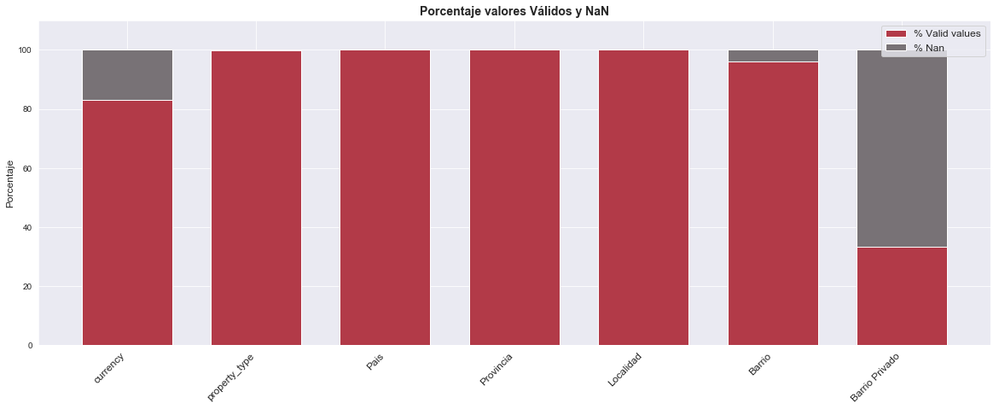

In [496]:
details_missing_unique_values_categorical(df2,['currency','property_type','Pais','Provincia','Localidad','Barrio','Barrio Privado']
                                          ,plot_figure=True)

Dada la cant. de missing data de currency, evaluamos si hay datos que podamos recuperar para no perder esas entradas, en función de las variables de precio

In [497]:
aux_bool_currency=pd.DataFrame(df2['currency'].isnull())
aux_index_nan=aux_bool_currency[aux_bool_currency['currency']==True].index.values
print ('Vs price= '+ str(df2.loc[aux_index_nan,'currency'].isnull().sum()-df2.loc[aux_index_nan,'price'].isnull().sum()))
print ('Vs local= '+ str(df2.loc[aux_index_nan,'currency'].isnull().sum()-df2.loc[aux_index_nan,'price_aprox_local_currency'].isnull().sum()))
print ('Vs usd= '+ str(df2.loc[aux_index_nan,'currency'].isnull().sum()-df2.loc[aux_index_nan,'price_aprox_usd'].isnull().sum()))
print ('Vs m2usd= '+ str(df2.loc[aux_index_nan,'currency'].isnull().sum()-df2.loc[aux_index_nan,'price_usd_per_m2'].isnull().sum()))
print ('Vs m2ars= '+ str(df2.loc[aux_index_nan,'currency'].isnull().sum()-df2.loc[aux_index_nan,'price_per_m2'].isnull().sum()))

Vs price= 1
Vs local= 1
Vs usd= 1298
Vs m2usd= 0
Vs m2ars= 0


Por lo que se observa en casi todas las entradas que hay missing data de currency también lo hay de las variables de precios con la excepción de 1298 valores. Los revisamos para ver si podemos recuperar datos (e identificar en qué moneda están)

In [498]:
df2[(df2['currency'].isnull()) & \
    (df2['price_aprox_usd'].notnull())][['price_aprox_usd']].describe().round(2)

,price_aprox_usd
count,1.298000e+03
mean,2.032950e+11
std,7.069411e+12
min,1.016005e+04
25%,1.329876e+04
50%,2.580867e+04
75%,2.611303e+05
max,2.546651e+14


Siendo que los valores están en la columna dólares y parecen ser dólares, completamos los currency faltantes con USD (de todos modos, esta columna seguro la limpiaremos para la base final)

In [499]:
aux_index=df2[(df2['currency'].isnull()) & \
    (df2['price_aprox_usd'].notnull())].index.values
df2.loc[aux_index,'currency']='USD'

Dado que habíamos identificado tres entradas con monedas PEN y UYU pasamos a ponerle nans a esas entradas del dataset

In [500]:
aux_index=df2[(df2['currency']=='PEN') | (df2['currency']=='UYU')].index.values
df2.loc[aux_index,:]=np.nan

De las variables categoriales, usamos hot_encoding para la variable property_type, y así poder usarla para el modelo de regresión

Dado que nosotros incluímos una entrada con el valor Terreno, la buscamos para ponerla en nan y no incluirla en el hot encoding

In [501]:
df2[df2['property_type']=='TERRENO']
df2.loc[39810,:]=np.nan

Hacemos el hot_encoding

In [502]:
df_aux=pd.DataFrame(df2['property_type'])
df_aux_dos=pd.get_dummies(df_aux)
df2=pd.concat([df2,df_aux_dos],axis=1)

In [503]:
df2.head(1)

,Unnamed: 0,operation,property_type,geonames_id,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,expenses,properati_url,description,title,image_thumbnail,Tiene_expensas,price_usd_m2_total,price_usd_m2_covered,Pais,Provincia,Localidad,Barrio,Barrio Privado,lat,lon,property_type_PH,property_type_apartment,property_type_house,property_type_store
0,0.0,sell,PH,3430787.0,62000.0,USD,1093959.0,62000.0,55.0,40.0,1127.272727,1550.0,NaN,http://www.properati.com.ar/15bo8_venta_ph_mat...,"2 AMBIENTES TIPO CASA PLANTA BAJA POR PASILLO,...",2 AMB TIPO CASA SIN EXPENSAS EN PB,https://thumbs4.properati.com/8/BluUYiHJLhgIIK...,0.0,1127.272727,1550.0,Argentina,Capital Federal,Mataderos,,NaN,-34.661824,-58.508839,1,0,0,0


### 6.2 Revisamos las variables numéricas de interés


,%Nan_values,Cant_nan_values,%Out_values,Cant_out_values,Left IQR thres,Right IQR thres,%Values_without_out,Cant_values_without_out
geonames_id,15.549,18848,0.778,943,2820583.000,4446319.000,83.673,101429
lat,42.527,51551,18.627,22580,-35.011,-34.100,38.846,47089
lon,42.527,51551,18.312,22198,-59.224,-57.899,39.161,47471
price_aprox_usd,15.949,19333,7.016,8505,-175000.000,529000.000,77.035,93382
surface_total_in_m2,9.362,11349,8.179,9915,-169.000,415.000,82.458,99956
surface_covered_in_m2,9.362,11349,6.476,7850,-111.500,308.500,84.162,102021
price_usd_m2_total,21.873,26515,3.972,4815,-691.758,4361.722,74.154,89890
price_usd_m2_covered,21.873,26515,4.390,5321,-570.175,4692.982,73.737,89384


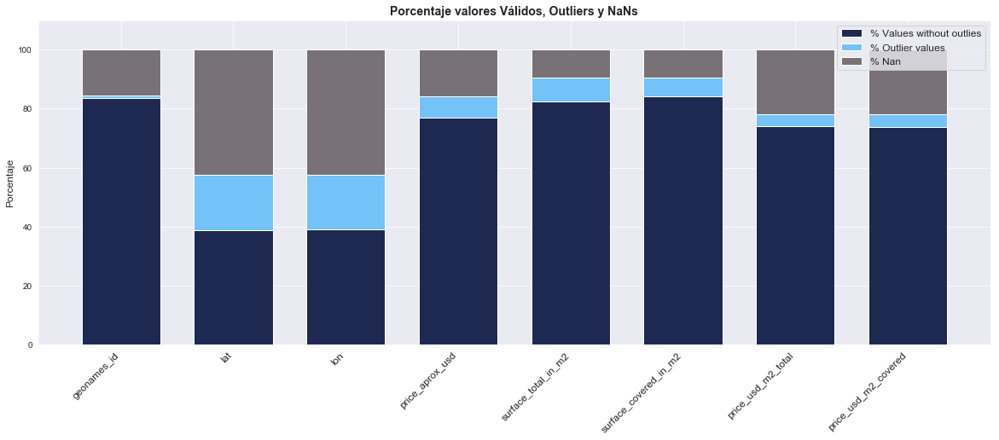

In [504]:
list_to_check_float_int=['geonames_id','lat','lon','price_aprox_usd','surface_total_in_m2',
                         'surface_covered_in_m2','price_usd_m2_total','price_usd_m2_covered']
details_missing_outlier_values_numerical(df2,list_to_check_float_int,plot_figure=True,fig_size=(20,7))

Comparando este gráfico con el primero usado en forma exploratoria encontramos que en la gran mayoría de variables pudimos reducir el número de datos faltantes. Faltaría mejorar para esta primera etapa el reemplazo de precios en dólares. Una estrategia para la parte dos del desafío sería evaluar de reemplazar estos datos con la mediana de la localidad al que pertenecen, pesado por otras variables como la superficie.

##  <ins>7. SÉPTIMA ETAPA</ins>: Limpieza final del dataset
Más allá de que nos quedan datos para recuperar, hacemos la prueba de limpiar el dataset de nans, de variables que descartamos, y de variables que tienen muchos nans. 

Luego sacamos los nans que hayan quedado en general de la base para ver cómo quedó la misma

In [505]:
df2_limpia = df2.copy()

In [506]:
df2_limpia.head(1)

,Unnamed: 0,operation,property_type,geonames_id,price,currency,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2,expenses,properati_url,description,title,image_thumbnail,Tiene_expensas,price_usd_m2_total,price_usd_m2_covered,Pais,Provincia,Localidad,Barrio,Barrio Privado,lat,lon,property_type_PH,property_type_apartment,property_type_house,property_type_store
0,0.0,sell,PH,3430787.0,62000.0,USD,1093959.0,62000.0,55.0,40.0,1127.272727,1550.0,NaN,http://www.properati.com.ar/15bo8_venta_ph_mat...,"2 AMBIENTES TIPO CASA PLANTA BAJA POR PASILLO,...",2 AMB TIPO CASA SIN EXPENSAS EN PB,https://thumbs4.properati.com/8/BluUYiHJLhgIIK...,0.0,1127.272727,1550.0,Argentina,Capital Federal,Mataderos,,NaN,-34.661824,-58.508839,1,0,0,0


In [507]:
df2_limpia=df2_limpia.drop(columns=['Unnamed: 0','operation','property_type','geonames_id',
                                    'price','currency','price_aprox_local_currency',
                                    'price_usd_per_m2','price_per_m2','expenses','properati_url',
                                    'description','title','image_thumbnail','Pais','Localidad',
                                    'Barrio','Barrio Privado','lat','lon'])

In [508]:
# Probamos hacer un hot enccoding de las provincias, a riesgo que se nos extienda demasiado la tabla, 
# es un dato que podría ser interesante para el regresor
df_aux=pd.DataFrame(df2_limpia['Provincia'])
df_aux_dos=pd.get_dummies(df_aux,prefix='Prov')
df2_limpia=pd.concat([df2_limpia,df_aux_dos],axis=1)


In [509]:
df2_limpia=df2_limpia.drop(columns=['Provincia'])

Sacamos todas las filas que tengan nans en estas variables

In [510]:
df2_limpia=df2_limpia.dropna(axis=0, how='any')

In [511]:
df2_limpia.describe().round(6)

,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,Tiene_expensas,price_usd_m2_total,price_usd_m2_covered,property_type_PH,property_type_apartment,property_type_house,property_type_store,Prov_Bs.As. G.B.A. Zona Norte,Prov_Bs.As. G.B.A. Zona Oeste,Prov_Bs.As. G.B.A. Zona Sur,Prov_Buenos Aires Costa Atlántica,Prov_Buenos Aires Interior,Prov_Capital Federal,Prov_Catamarca,Prov_Chaco,Prov_Chubut,Prov_Corrientes,Prov_Córdoba,Prov_Entre Ríos,Prov_Formosa,Prov_Jujuy,Prov_La Pampa,Prov_La Rioja,Prov_Mendoza,Prov_Misiones,Prov_Neuquén,Prov_Río Negro,Prov_Salta,Prov_San Juan,Prov_San Luis,Prov_Santa Cruz,Prov_Santa Fe,Prov_Santiago Del Estero,Prov_Tierra Del Fuego,Prov_Tucumán
count,9.470500e+04,94705.000000,94705.000000,94705.000000,9.470500e+04,9.470500e+04,94705.000000,94705.000000,94705.000000,94705.000000,94705.000000,94705.000000,94705.000000,94705.000000,94705.000000,94705.000000,94705.000000,94705.000000,94705.000000,94705.000000,94705.000000,94705.00000,94705.000000,94705.000000,94705.000000,94705.000000,94705.000000,94705.00000,94705.000000,94705.00000,94705.000000,94705.000000,94705.000000,94705.000000,94705.000000,94705.000000,94705.000000,94705.000000
mean,5.283492e+07,201.146435,130.976328,0.126424,2.865121e+05,3.045950e+05,0.050420,0.599409,0.318621,0.031551,0.245668,0.069986,0.111441,0.085191,0.016683,0.307017,0.000232,0.000359,0.001584,0.004688,0.080313,0.00114,0.000306,0.000106,0.000201,0.000021,0.004826,0.00284,0.003136,0.00359,0.000940,0.000063,0.001827,0.000137,0.055425,0.000032,0.000296,0.001953
std,1.031185e+10,1185.963116,373.295215,0.332329,4.171314e+07,4.359658e+07,0.218811,0.490021,0.465944,0.174801,0.430485,0.255124,0.314679,0.279167,0.128083,0.461259,0.015240,0.018944,0.039766,0.068310,0.271778,0.03375,0.017496,0.010275,0.014163,0.004595,0.069298,0.05322,0.055913,0.05981,0.030641,0.007959,0.042701,0.011715,0.228809,0.005628,0.017192,0.044155
min,4.666620e+03,3.000000,3.000000,0.000000,1.184571e+00,3.204781e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,9.000000e+04,50.000000,45.000000,0.000000,1.203297e+03,1.403509e+03,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1.499000e+05,80.000000,73.000000,0.000000,1.785714e+03,1.960000e+03,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,2.700000e+05,188.000000,150.000000,0.000000,2.466667e+03,2.719298e+03,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,3.080346e+12,154438.000000,38240.000000,1.000000,7.783605e+09,7.783605e+09,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


,%Nan_values,Cant_nan_values,%Out_values,Cant_out_values,Left IQR thres,Right IQR thres,%Values_without_out,Cant_values_without_out
price_aprox_usd,0.0,0,8.339,7897,-180000.000,540000.000,91.661,86808
surface_total_in_m2,0.0,0,9.156,8671,-157.000,395.000,90.844,86034
surface_covered_in_m2,0.0,0,6.681,6327,-112.500,307.500,93.319,88378
price_usd_m2_total,0.0,0,5.084,4815,-691.758,4361.722,94.916,89890
price_usd_m2_covered,0.0,0,5.618,5321,-570.175,4692.982,94.382,89384


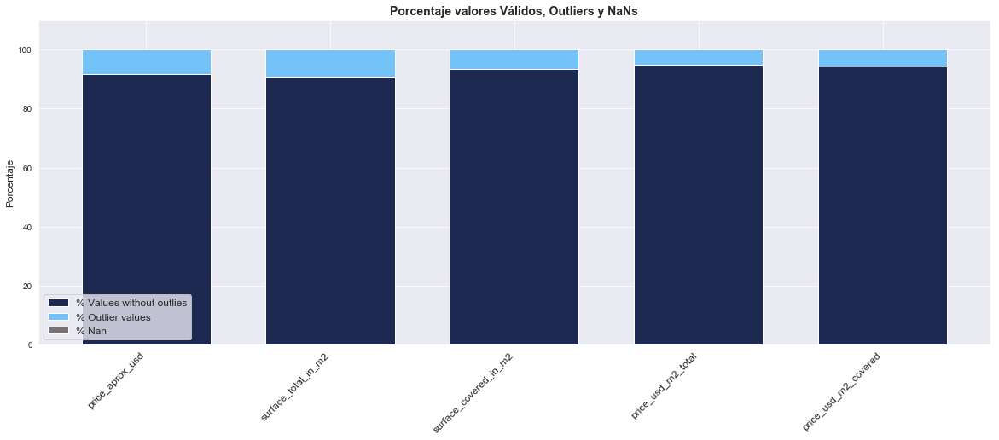

In [512]:
list_to_check_float_int=['price_aprox_usd','surface_total_in_m2','surface_covered_in_m2','price_usd_m2_total','price_usd_m2_covered']
details_missing_outlier_values_numerical(df2_limpia,list_to_check_float_int,plot_figure=True,fig_size=(20,7))

### Por lo que observamos en nuestra base limpia nos quedaron más de 94 mil entradas válidas, en las que se limpiaron los datos

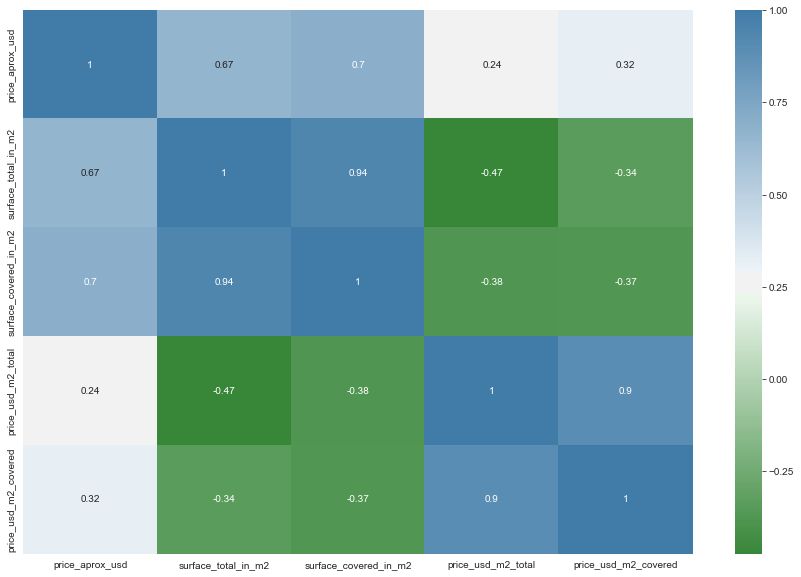

In [522]:

figura= plt.figure(figsize=(15, 10))
sns.heatmap(df2_limpia[['price_aprox_usd','surface_total_in_m2',
                        'surface_covered_in_m2','price_usd_m2_total','price_usd_m2_covered']].corr(method='spearman'),
            annot=True, cmap=sns.diverging_palette(128, 240,as_cmap=True))
plt.xticks(rotation=0)
plt.yticks(rotation=90,va="center");